# Assignment 3

In [ ]:
# Import libraries
import numpy as np
import pandas as pd
from sklearn.datasets import make_classification
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

## Task 1: MLE computation

As you know, we can think about linear regression from the optimization point of view (as the problem of minimizing the root mean squared error), but we can also consider it from the probabilistic point of view.
Let's consider the following equation:

\begin{equation*}
y_i=x_i B_0+\varepsilon_i
\end{equation*}

where $y_i$ is the dependent variable, $x_i$ is a $1 \times K$ vector of regressors, $\beta_0$ is the $K \times 1$ vector of regression coefficients to be estimated and $\varepsilon_i$ is an unobservable error term.

The sample is made up of $N$ IID observations $\left(y_i, x_i\right)$.
The regression equations can be also written as

\begin{equation*}
y=X \beta_0+\varepsilon
\end{equation*}

where the $N \times 1$ vector of observations of the dependent variable is denoted by $y$, the $N \times K$ matrix of regressors is denoted by $X$, and the $N \times 1$ vector of error terms is denoted by $\varepsilon$.

As everybody interested in probability theory knows, we always have to have some assumptions. In this case, we assume that the vector of errors $\varepsilon$ has a multivariate normal distribution conditional on $x$, with mean equal to 0 and covariance matrix equal to

\begin{equation*}
\sigma_0^2 I
\end{equation*}

where $l$ is the $N \times N$ identity matrix and

\begin{equation*}
\sigma_0^2=\operatorname{Var}\left[\varepsilon_i \mid X\right]
\end{equation*}

is the second parameter to be estimated.
Furthermore, it is assumed that the matrix of regressors $x$ has full-rank.

Those assumptions have interesting implications:
- the covariance matrix of $\varepsilon$ is diagonal implies that the entries of $\varepsilon$ are mutually independent (i.e., $\varepsilon_i$ is independent of $\varepsilon_j$ for $i \neq j$.)
- they all have a normal distribution with mean 0 and variance $\sigma_0^2$.

The fact that we transform normal random variables linearly makes the dependent variable $y_i$ conditionally normal, with mean $x_i \beta_0$ and variance $\sigma_0^2$. Therefore, its cdf is

\begin{equation*}
f_Y\left(y_i \mid X\right)=\left(2 \pi \sigma_0^2\right)^{-1 / 2} \exp \left(-\frac{1}{2} \frac{\left(y_i-x_i \beta_0\right)^2}{\sigma_0^2}\right)
\end{equation*}

Having this probability model we can use it to do estimation of regression parameters using Maximum Likelihood Estimation method.

The first-order conditions for a maximum are

\begin{equation*}
\begin{aligned}
& \nabla_\beta l\left(\beta, \sigma^2 ; y, X\right)=0 \\
& \frac{\partial}{\partial \sigma^2} l\left(\beta, \sigma^2 ; y, X\right)=0
\end{aligned}
\end{equation*}

where $\nabla_\beta$ indicates the gradient calculated with respect to $\beta$, that is, the vector of the partial derivatives of the log-likelihood with respect to the entries of $\beta$. The gradient is

\begin{equation*}
\begin{aligned}
& \nabla_\beta l\left(\beta, \sigma^2: y, X\right) \\
= & \nabla_\beta\left(-\frac{N}{2} \ln (2 \pi)-\frac{N}{2} \ln \left(\sigma^2\right)-\frac{1}{2 \sigma^2} \sum_{i=1}^N\left(y_i-x_i \beta\right)^2\right) \\
= & \frac{1}{\sigma^2} \sum_{i=1}^N x_i^{\top}\left(y_i-x_i \beta\right) \\
= & \frac{1}{\sigma^2}\left(\sum_{i=1}^N x_i^{\top} y_i-\sum_{i=1}^N x_i^{\top} x_i \beta\right)
\end{aligned}
\end{equation*}

which is equal to zero only if

\begin{equation*}
\sum_{i=1}^N x_i^{\top} y_i-\sum_{i=1}^N x_i^{\top} x_i \beta=0
\end{equation*}


Therefore, the first of the two equations is satisfied if

\begin{equation*}
\beta=\left(\sum_{i=1}^N x_i^{\top} x_i\right)^{-1} \sum_{i=1}^N x_i^{\top} y_i=\left(X^{\top} X\right)^{-1} X^{\top} y
\end{equation*}

where we have used the assumption that $x$ has full rank and, as a consequence, $x^x x$ is invertible.


### Subtask A:
Prove that the MLE for variance is equal to
$$
\widehat{\sigma}_n^2=\frac{1}{N} \sum_{i=1}^N\left(y_i-x_i \widehat{\beta}_N\right)^2
$$

### MLE for Logistic regression

In the logistic regression model, the output variable $y_i$ is a Bernoulli random variable (it can take only two values, either 1 or 0 ) and

\begin{equation*}
\mathrm{P}\left(y_i=1 \mid x_i\right)=S\left(x_i \beta\right)
\end{equation*}

where

\begin{equation*}
S(t)=\frac{1}{1+\exp (-t)}
\end{equation*}

is the logistic function, $x_i$ is a $1 \times K$ vector of inputs and $\beta$ is a $K \times 1$ vector of coefficients.

Furthermore,

\begin{equation*}
\mathrm{P}\left(y_i=0 \mid x_i\right)=1-S\left(x_i \beta\right)
\end{equation*}


The vector of coefficients $\beta$ is the parameter to be estimated by maximum likelihood.
We assume that the estimation is carried out with an IID sample comprising $N$ data points

\begin{equation*}
\left(y_i, x_i\right) \text { for } i=1, \ldots, N
\end{equation*}

### Subtask B
1. Find the form of the loglikelihood.
2. Compute the gradient of logistic function with respect to $\beta$

You can either tex your solution and put it in this notebook or attach photos of your solution.

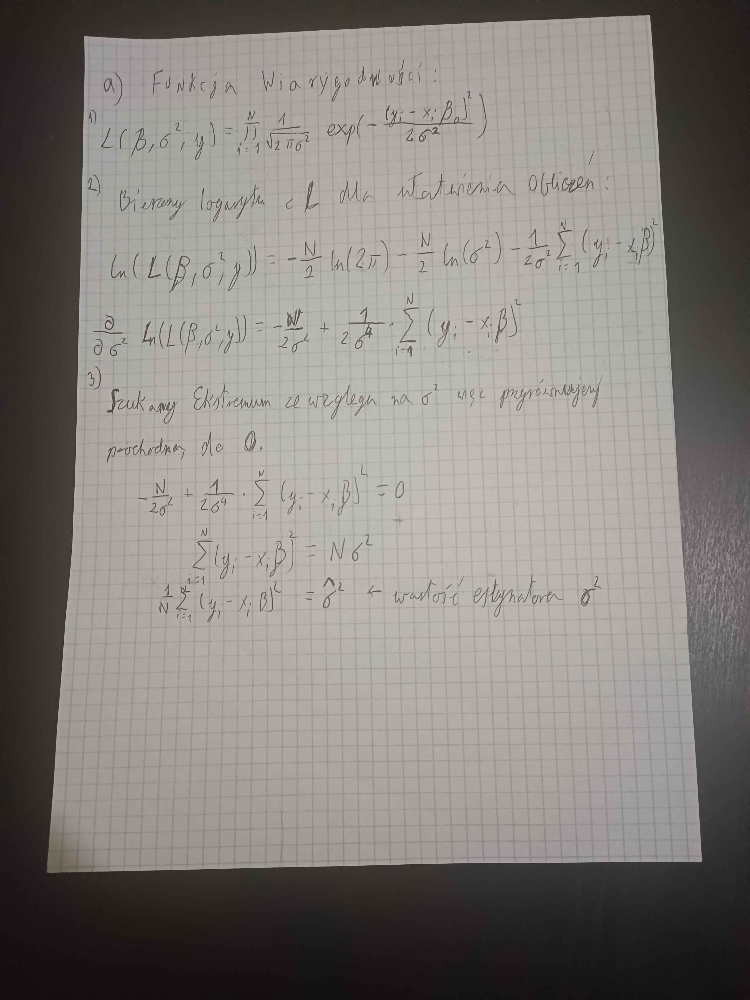


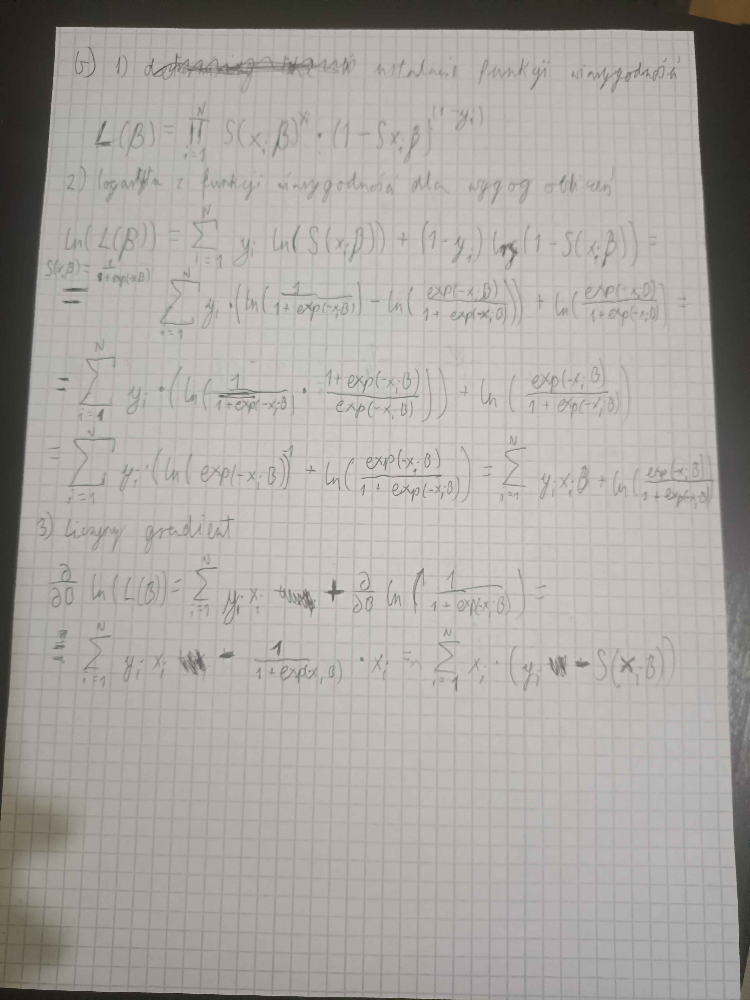

## Task 2: Implement Logistic Regression

Use derivations form previous task to perform logistic regression. Provide a custom implemntation of gradient descent for this taks.
**Bonus points** provide also implementation of other optimization algorithm of your choice, eg. Newton-Rhapson method.


newton_raphson w porównaniu do zwykłego gradientu ma pewną przewagę mianowicie zbiega znacznie szybciej przy ekstremum ponieważ hessian zapewnia nam wiedze o zakrzywieniu funkcji, jednak wymaga od nas obliczania macierzy odwrotnej przez co moze wymagac wiecej obliczen

In [12]:
import numpy as np

class LogisticRegression:
    def __init__(self, learning_rate=0.01, max_iter=1000, tol=1e-6):
        self.learning_rate = learning_rate
        self.max_iter = max_iter
        self.tol = tol
        self.beta = None

    def sigmoid(self, z):
        return 1 / (1 + np.exp(-z))

    def log_likelihood(self, X, y):
        data = np.dot(X, self.beta)
        y_pred = self.sigmoid(data)
        return np.sum(y * np.log(y_pred) + (1 - y) * np.log(1 - y_pred))

    # cutomowy gradient
    def gradient(self, X, y):
        data = np.dot(X, self.beta)
        y_pred = self.sigmoid(data)
        return np.dot(X.T, (y - y_pred))

    def fit_gradient_descent(self, X, y):
        n_samples, n_features = X.shape
        self.beta = np.zeros(n_features)

        for i in range(self.max_iter):
            grad = self.gradient(X, y)
            old_beta = self.beta.copy()
            self.beta += self.learning_rate * grad / n_samples

            # test czy wgl cokolwiek zmieniamy (zbieznosc rozwa)
            if np.linalg.norm(self.beta - old_beta) < self.tol:
                print(f"zbieglo po {i + 1} iteracjach")
                break

    def fit_newton_raphson(self, X, y):
        n_samples, n_features = X.shape
        self.beta = np.zeros(n_features)

        for i in range(self.max_iter):
            linear_model = np.dot(X, self.beta)
            predictions = self.sigmoid(linear_model)

            grad = self.gradient(X, y)

            # Obliczanie macierzy hessiana
            S = np.diag(predictions * (1 - predictions))
            H = -np.dot(np.dot(X.T, S), X)

            try:
                delta = np.linalg.solve(H, grad)
            except np.linalg.LinAlgError:
                print("hessian nie odwracalny")
                break

            old_beta = self.beta.copy()
            self.beta -= delta

            # test czy wgl cokolwiek zmieniamy (zbieznosc rozwa)
            if np.linalg.norm(self.beta - old_beta) < self.tol:
                print(f"zbieglo po {i + 1} iteracjach")
                break

    def predict_proba(self, X):
        linear_model = np.dot(X, self.beta)
        return self.sigmoid(linear_model)

    def predict(self, X, threshold=0.5):
        probabilities = self.predict_proba(X)
        return (probabilities >= threshold).astype(int)


zbieglo po 677 iteracjach
hessian nie odwracalny
Accuracy (Gradient Descent): 0.74
Accuracy (Newton-Raphson): 0.64


<ipython-input-12-ca21dab85385>:11: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-z))
<ipython-input-12-ca21dab85385>:11: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-z))


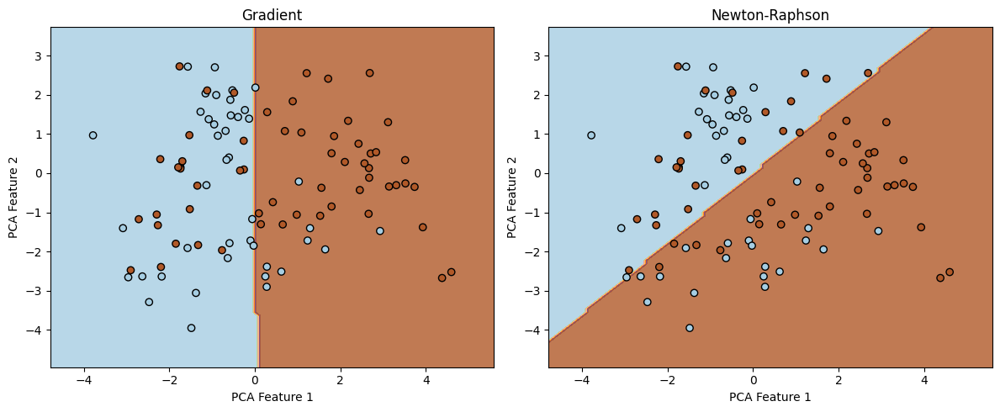

In [13]:
from sklearn.datasets import make_classification
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt

# Dane
X, y = make_classification(n_samples=500, n_informative=4, n_redundant=5, n_features=20, random_state=42)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#normalizacja danych
'''
Obiekt z biblioteki sklearn.preprocessing, który przekształca dane w taki sposób, że każda cecha ma:
Średnią (mean) równą 0,
Odchylenie standardowe (std) równe 1.
'''
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Gradient
model_gd = LogisticRegression(learning_rate=0.1, max_iter=1000, tol=1e-6)
model_gd.fit_gradient_descent(X_train, y_train)
y_pred_gd = model_gd.predict(X_test)

# Newton-Raphson
model_nr = LogisticRegression(max_iter=1000, tol=1e-6)
model_nr.fit_newton_raphson(X_train, y_train)
y_pred_nr = model_nr.predict(X_test)

print("Accuracy (Gradient Descent):", accuracy_score(y_test, y_pred_gd))
print("Accuracy (Newton-Raphson):", accuracy_score(y_test, y_pred_nr))

pca = PCA(n_components=2)
X_train_2d = pca.fit_transform(X_train)
X_test_2d = pca.transform(X_test)

def plot_decision_boundary(model, X, y, title):
    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
    # jako że dane są wielowymiarowe to zbijamy wymiary algorytmem pca (kod wzięty z internetu)
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 100), np.linspace(y_min, y_max, 100))
    Z = model.predict(pca.inverse_transform(np.c_[xx.ravel(), yy.ravel()]))
    Z = Z.reshape(xx.shape)
    plt.contourf(xx, yy, Z, alpha=0.8, cmap=plt.cm.Paired)
    plt.scatter(X[:, 0], X[:, 1], c=y, edgecolor="k", cmap=plt.cm.Paired)
    plt.title(title)
    plt.xlabel("PCA Feature 1")
    plt.ylabel("PCA Feature 2")

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plot_decision_boundary(model_gd, X_test_2d, y_test, "Gradient")

plt.subplot(1, 2, 2)
plot_decision_boundary(model_nr, X_test_2d, y_test, "Newton-Raphson")

plt.tight_layout()
plt.show()

## Task 3: Classification for Imbalanced Data

Split the data using a technique suitable for imbalanced classes. Describe its working.

Train a logistic regression model on the below data.

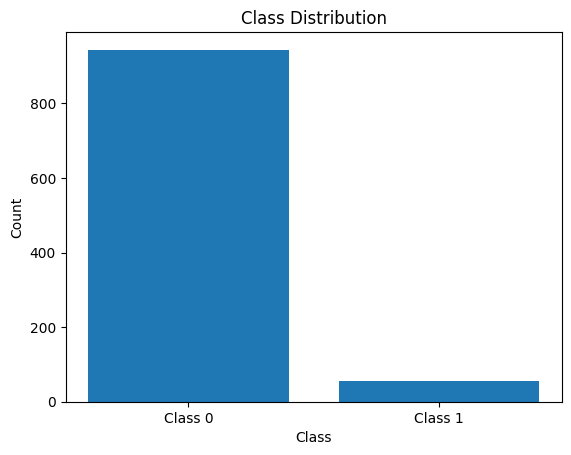

Dataset Shape: (1000, 20)
Class Distribution: [944  56]


In [14]:

# Create a synthetic dataset
X, y = make_classification(
    n_samples=1000,
    n_informative=4, n_redundant=5, n_features=20, n_clusters_per_class=3,
    n_classes=2,
    weights=[0.95, 0.05],
    random_state=42
)

# Visualize class distribution
def visualize_class_distribution(y):
    plt.bar(['Class 0', 'Class 1'], [sum(y == 0), sum(y == 1)])
    plt.title("Class Distribution")
    plt.xlabel("Class")
    plt.ylabel("Count")
    plt.show()

visualize_class_distribution(y)

# Summarize dataset
print("Dataset Shape:", X.shape)
print("Class Distribution:", np.bincount(y))


Evaluate your binary classifiers using the following:
- confusion matrix,
- accuracy,
- precision,
- recall,
- F1 score,
- ROCAUC.

Please write custom functions calculating the above functions and plotting the receiver operating characteristic curve. Describe your intuition behind each metric and its suitability for imbalanced classes.



Propose, describe and implement a technique for improving the model's ability to distinguish the classes. Evaluate your approach.

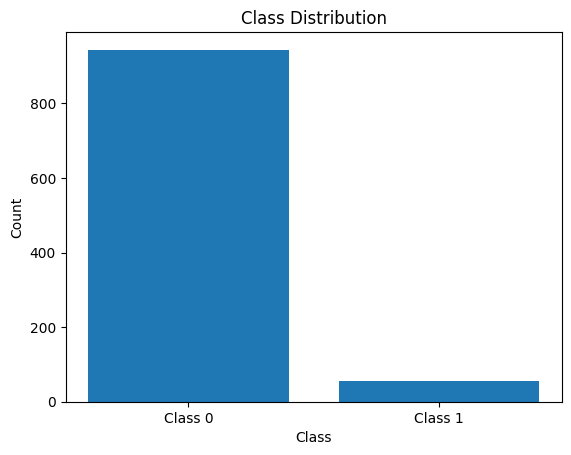

zbieglo po 708 iteracjach
Confusion Matrix:
 [[97 92]
 [ 2  9]]
Accuracy: 0.53
Precision: 0.0891089108910891
Recall: 0.8181818181818182
F1 Score: 0.16071428571428573


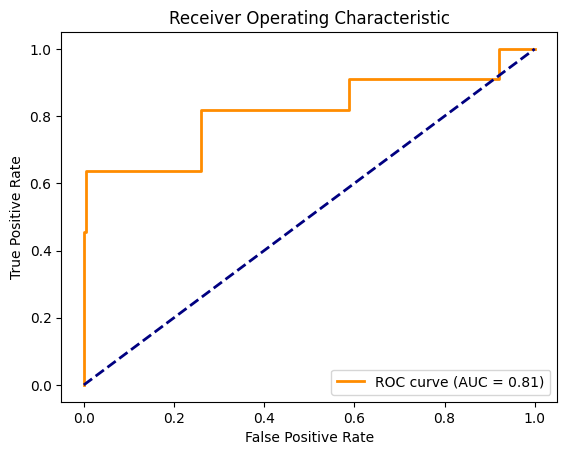

ROC AUC: 0.8148148148148148


In [15]:
from sklearn.metrics import roc_curve, auc


def visualize_class_distribution(y):
    plt.bar(['Class 0', 'Class 1'], [sum(y == 0), sum(y == 1)])
    plt.title("Class Distribution")
    plt.xlabel("Class")
    plt.ylabel("Count")
    plt.show()

def confusion_matrix(y_true, y_pred):
    tp = np.sum((y_true == 1) & (y_pred == 1))
    tn = np.sum((y_true == 0) & (y_pred == 0))
    fp = np.sum((y_true == 0) & (y_pred == 1))
    fn = np.sum((y_true == 1) & (y_pred == 0))
    return np.array([[tn, fp], [fn, tp]])

def precision(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred)
    return cm[1, 1] / (cm[1, 1] + cm[0, 1]) if (cm[1, 1] + cm[0, 1]) > 0 else 0

def recall(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred)
    return cm[1, 1] / (cm[1, 1] + cm[1, 0]) if (cm[1, 1] + cm[1, 0]) > 0 else 0

def f1_score(y_true, y_pred):
    p = precision(y_true, y_pred)
    r = recall(y_true, y_pred)
    return 2 * (p * r) / (p + r) if (p + r) > 0 else 0

def plot_roc_curve(y_true, y_scores):
    fpr, tpr, _ = roc_curve(y_true, y_scores)
    roc_auc = auc(fpr, tpr)
    plt.figure()
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc="lower right")
    plt.show()
    return roc_auc

X, y = make_classification(
    n_samples=1000,
    n_informative=4, n_redundant=5, n_features=20, n_clusters_per_class=3,
    n_classes=2, weights=[0.95, 0.05], random_state=42
)

visualize_class_distribution(y)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

#normalizacja danych
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

model = LogisticRegression(learning_rate=0.1, max_iter=1000, tol=1e-6)
model.fit_gradient_descent(X_train, y_train)
y_pred = model.predict(X_test)
y_scores = model.predict_proba(X_test)

cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:\n", cm)
print("Accuracy:", np.trace(cm) / np.sum(cm))
print("Precision:", precision(y_test, y_pred))
print("Recall:", recall(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
roc_auc = plot_roc_curve(y_test, y_scores)
print("ROC AUC:", roc_auc)


SMOTE (Synthetic Minority Over Sampling Technique)

  It works as such, for the minority class it generetes new ones by interpolating between samples from this class which creates new ones and fights disporportion between the two

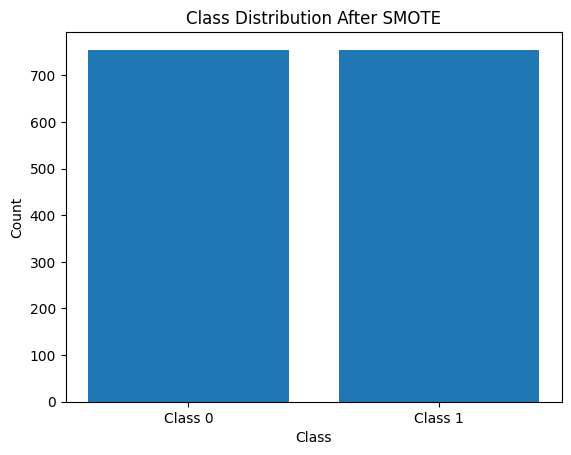

zbieglo po 954 iteracjach
Confusion Matrix:
 [[129  60]
 [  3   8]]
Accuracy: 0.685
Precision: 0.11764705882352941
Recall: 0.7272727272727273
F1 Score: 0.20253164556962022


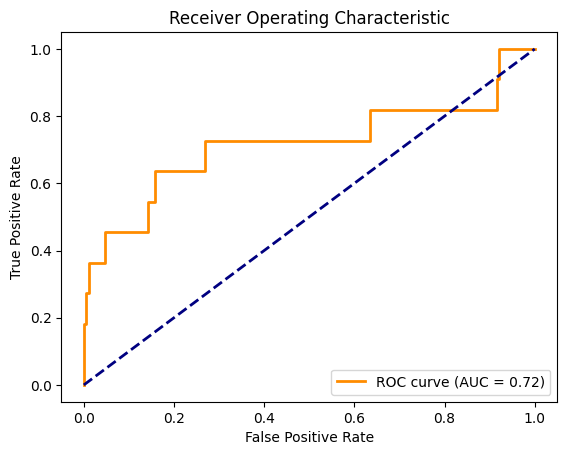

ROC AUC: 0.7176527176527177


In [18]:
from imblearn.over_sampling import SMOTE

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

smote = SMOTE(sampling_strategy='auto', random_state=42)
X_train_res, y_train_res = smote.fit_resample(X_train, y_train)

def visualize_class_distribution(y, title="Class Distribution"):
    plt.bar(['Class 0', 'Class 1'], [sum(y == 0), sum(y == 1)])
    plt.title(title)
    plt.xlabel("Class")
    plt.ylabel("Count")
    plt.show()

visualize_class_distribution(y_train_res, "Class Distribution After SMOTE")

#normalizacja danych
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train_res)
X_test = scaler.transform(X_test)

model = LogisticRegression(learning_rate=0.1, max_iter=1000, tol=1e-6)
model.fit_gradient_descent(X_train_res, y_train_res)
y_pred = model.predict(X_test)
y_scores = model.predict_proba(X_test)

cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:\n", cm)
print("Accuracy:", np.trace(cm) / np.sum(cm))
print("Precision:", precision(y_test, y_pred))
print("Recall:", recall(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
roc_auc = plot_roc_curve(y_test, y_scores)
print("ROC AUC:", roc_auc)

In my case the usage of Smote worked but it doesnt nessesarly have to be that way because the interpolated points can be missleading

## Task 4: Optimization of Neural Networks

The **backpropagation algorithm** is the foundational algorithm in deep learning. In this task You will have to go through a single iteration of said algorithm and compare the results after updating networks weights. <br>
You are given a neural network with one input layer consisting of two input nodes ${n_1, n_2}$, one hidden layer with two neurons ${n_3, n_4}$ and an output layer with a single node $n_5$. We will denote the weight connecting $n_i$ to $n_j$ as $w_{i,j}$. A bias related to $n_i$ will be denoted as $b_i$. Parameters are initialized as follows:
* $w_{1,3} = 1.5$ ; $w_{2,3} = -2.5$ ; $b_{3} = 0.3$
* $w_{1,4} = 1$ ; $w_{2,4} = -2.5$ ; $b_{4} = 0.2$
* $w_{3,5} = 4$ ; $w_{4,5} = 3$ ; $b_{5} = -0.8$ <br>

Additionally, neurons $n_3$ and $n_4$ are equipped with the sigmoid activation function: $\sigma(x) = \frac{1}{1+e^{-x}} $<br>
Your task is to use two training examples: $x = \{ (1,2), (2,0)\}$, $y = \{-1, 6\}$ to preform a single backpropagation step - preform forward calculations and propagate the received error backwards, updating the weights. After all weights have been updated, check how the predictions change, preforming additional forward pass.

Forward pass

obliczanie predykcji by móc policzyć bląd i gradienty

In [19]:
import torch

def sigmoid(x):
    return 1 / (1 + np.exp(-x))

X = torch.tensor([(1.0, 2.0), (2.0, 0.0)])
y = torch.tensor([-1, 6])

w_13 = 1.5
w_23 = -2.5
w_14 = 1
w_24 = -2.5
w_35 = 4
w_45 = 3
b_3 = 0.3
b_4 = 0.2
b_5 = -0.8

# Forward pass
n_3 = sigmoid(w_13 * X[:, 0] + w_23 * X[:, 1] + b_3)
n_4 = sigmoid(w_14 * X[:, 0] + w_24 * X[:, 1] + b_4)
n_5 = w_35 * n_3 + w_45 * n_4 + b_5
print("Prediction:", n_5)

Prediction: tensor([-0.5777,  5.7585])


Error calc

obliczanie błędu w tym przypadku za pomocą MSE

In [20]:
def MSE(y_true, y_pred):
    return torch.mean((y_true - y_pred) ** 2)/2

print("Loss:", MSE(y[0], n_5))

Loss: tensor(11.4638)


Backward pass

wsteczna propagacja i aktualizacja wag konkretnych neuronów zgodnie z liczonym na podstawie bledu gradientem

( dloss/dparam = gradient_param )

In [21]:
d_5 = y[0] - n_5
d_3 = d_5 * w_35 * n_3 * (1 - n_3)
d_4 = d_5 * w_45 * n_4 * (1 - n_4)

grad_w_35 = d_5 * n_3
grad_w_45 = d_5 * n_4
grad_w_13 = d_3 * X[:, 0]
grad_w_23 = d_3 * X[:, 1]
grad_w_14 = d_4 * X[:, 0]
grad_w_24 = d_4 * X[:, 1]

grad_b_5 = d_5
grad_b_3 = d_3
grad_b_4 = d_4

lr = 0.01

w_35 -= lr * grad_w_35
w_45 -= lr * grad_w_45

w_13 -= lr * grad_w_13
w_23 -= lr * grad_w_23

w_14 -= lr * grad_w_14
w_24 -= lr * grad_w_24

b_5 -= lr * grad_b_5
b_3 -= lr * grad_b_3
b_4 -= lr * grad_b_4

check how new are doing

In [22]:
n_3 = sigmoid(w_13 * X[:, 0] + w_23 * X[:, 1] + b_3)
n_4 = sigmoid(w_14 * X[:, 0] + w_24 * X[:, 1] + b_4)
n_5 = w_35 * n_3 + w_45 * n_4 + b_5
print("Prediction:", n_5)
print("Loss:", MSE(y[1], n_5))

Prediction: tensor([-0.5728,  5.9741])
Loss: tensor(10.8005)


## Task 5: L1 & L2 Regularization for Logistic Regression

In this task we will use a synthetic dataset generated by the function `make_classification`.

1. Use a pairplot to see the relationships between the features in the dataset.
2. Apply your logistic regression model from Task 1 on this dataset and measure its accuracy.
3. Modify your implementation to account for two regularization methods: L1 and L2 and apply them to the dataset. What can you observe?
4. Which features are selected by L1 regularization? Plot the decision boundary for these features.

(If you have not done Task 1, use `LogisticRegression` from `sklearn` to see the effects of regularization. You can get half of the points for this task if you do that.)

In [24]:
import pandas as pd
X, y = make_classification(
    n_samples=1000,
    n_features=20,
    n_informative=5,
    n_redundant=5,
    n_classes=2,
    random_state=42
)

dataset = pd.DataFrame(X, columns=[f"Feature_{i}" for i in range(1, 21)])
dataset['Target'] = y

In [ ]:
!pip install seaborn

# **1.**

In [25]:
import seaborn as sns
sns.pairplot(dataset, hue='Target')
plt.show()


Output hidden; open in https://colab.research.google.com to view.

# **2.**

Confusion Matrix:
 [[80 20]
 [12 88]]
Accuracy: 0.84
Precision: 0.8148148148148148
Recall: 0.88
F1 Score: 0.8461538461538461


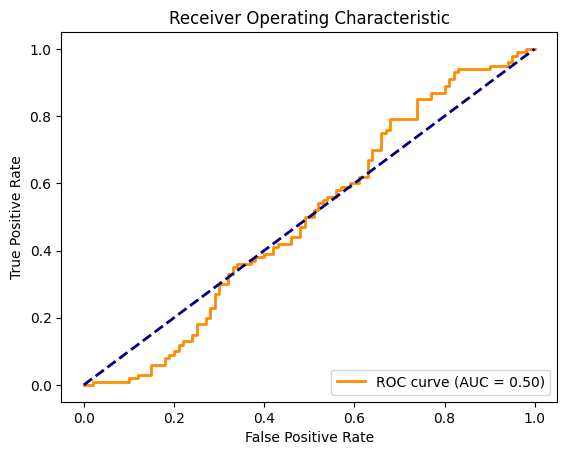

ROC AUC: 0.4998000000000001


In [26]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

model = LogisticRegression(learning_rate=0.1, max_iter=1000, tol=1e-6)
model.fit_gradient_descent(X_train, y_train)
y_pred = model.predict(X_test)

cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:\n", cm)
print("Accuracy:", np.trace(cm) / np.sum(cm))
print("Precision:", precision(y_test, y_pred))
print("Recall:", recall(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
roc_auc = plot_roc_curve(y_test, y_scores)
print("ROC AUC:", roc_auc)

# **3.**

Confusion Matrix:
 [[80 20]
 [12 88]]
Accuracy: 0.84
Precision: 0.8148148148148148
Recall: 0.88
F1 Score: 0.8461538461538461


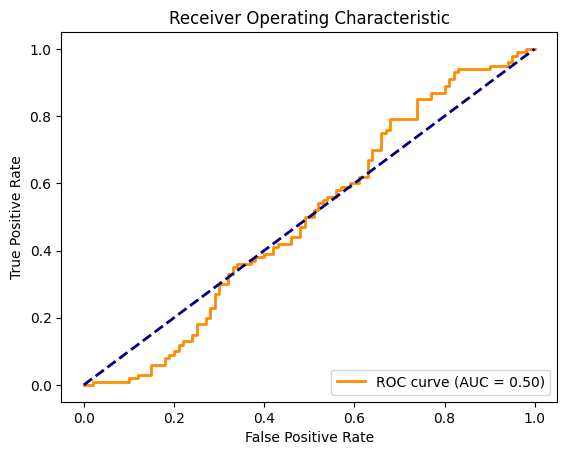

ROC AUC: 0.4998000000000001


In [27]:
class LogisticRegressionL:
    def __init__(self, learning_rate=0.01, max_iter=1000, tol=1e-6, lambda_l1=0.1, lambda_l2=0.1):
        self.learning_rate = learning_rate
        self.max_iter = max_iter
        self.tol = tol
        self.lambda_l1 = lambda_l1
        self.lambda_l2 = lambda_l2
        self.beta = None

    def sigmoid(self, z):
        return 1 / (1 + np.exp(-z))

    def log_likelihood(self, X, y):
        data = np.dot(X, self.beta)
        y_pred = self.sigmoid(data)
        l1_penalty = self.lambda_l1 * np.sum(np.abs(self.beta[1:]))
        l2_penalty = (self.lambda_l2 / 2) * np.sum(self.beta[1:] ** 2)
        return np.sum(y * np.log(y_pred) + (1 - y) * np.log(1 - y_pred)) - l1_penalty - l2_penalty

    def gradient(self, X, y):
        data = np.dot(X, self.beta)
        y_pred = self.sigmoid(data)
        grad = np.dot(X.T, (y - y_pred))

        grad[1:] -= self.lambda_l1 * np.sign(self.beta[1:])
        grad[1:] -= self.lambda_l2 * self.beta[1:]

        return grad

    def fit_gradient_descent(self, X, y):
        n_samples, n_features = X.shape
        self.beta = np.zeros(n_features)

        for i in range(self.max_iter):
            grad = self.gradient(X, y)
            old_beta = self.beta.copy()
            self.beta += self.learning_rate * grad / n_samples

            # test czy wgl cokolwiek zmieniamy (zbieznosc rozwa)
            if np.linalg.norm(self.beta - old_beta) < self.tol:
                print(f"zbieglo po {i + 1} iteracjach")
                break

    def predict_proba(self, X):
        linear_model = np.dot(X, self.beta)
        return self.sigmoid(linear_model)

    def predict(self, X, threshold=0.5):
        probabilities = self.predict_proba(X)
        return (probabilities >= threshold).astype(int)


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

model = LogisticRegressionL(learning_rate=0.1, max_iter=1000, tol=1e-6)
model.fit_gradient_descent(X_train, y_train)
y_pred = model.predict(X_test)

cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:\n", cm)
print("Accuracy:", np.trace(cm) / np.sum(cm))
print("Precision:", precision(y_test, y_pred))
print("Recall:", recall(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
roc_auc = plot_roc_curve(y_test, y_scores)
print("ROC AUC:", roc_auc)


Zaobserwowałem że wyniki są praktycznie te same

# **4.**

The ones with non 0 weights, i thought if i would rather do lower than epsilon weights but tha

zbieglo po 448 iteracjach


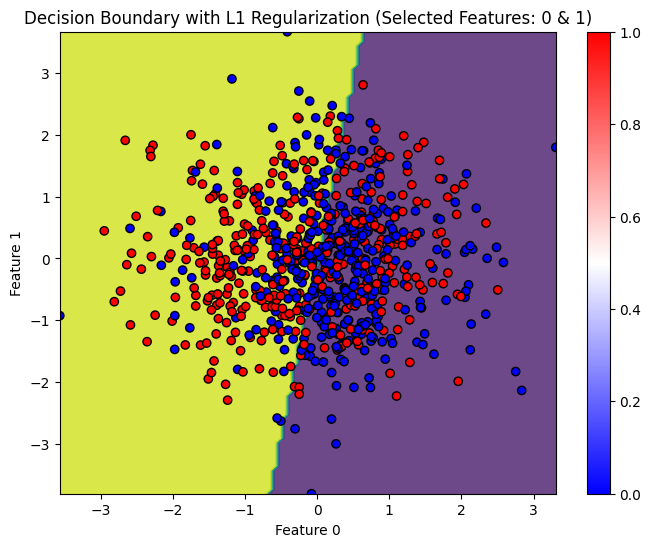

zbieglo po 444 iteracjach


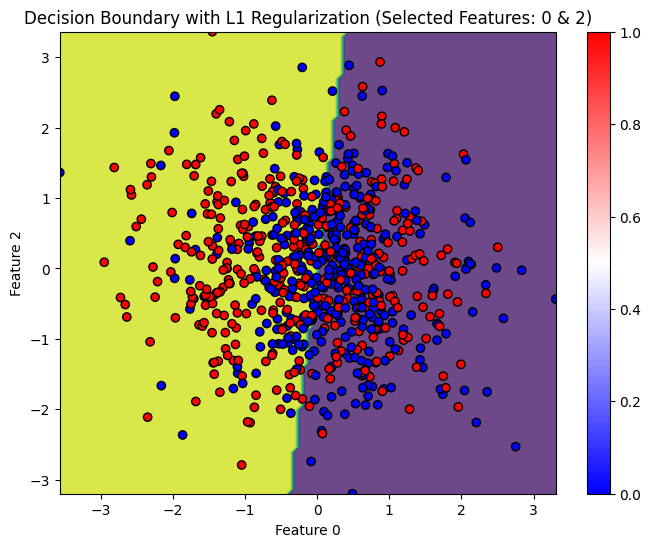

zbieglo po 439 iteracjach


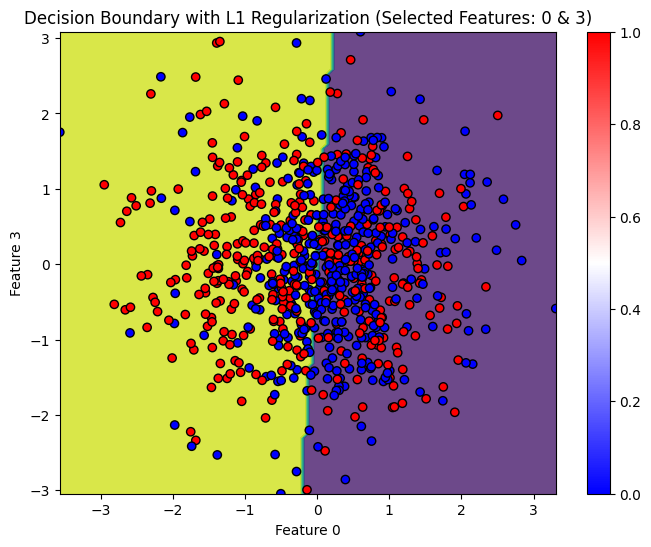

zbieglo po 438 iteracjach


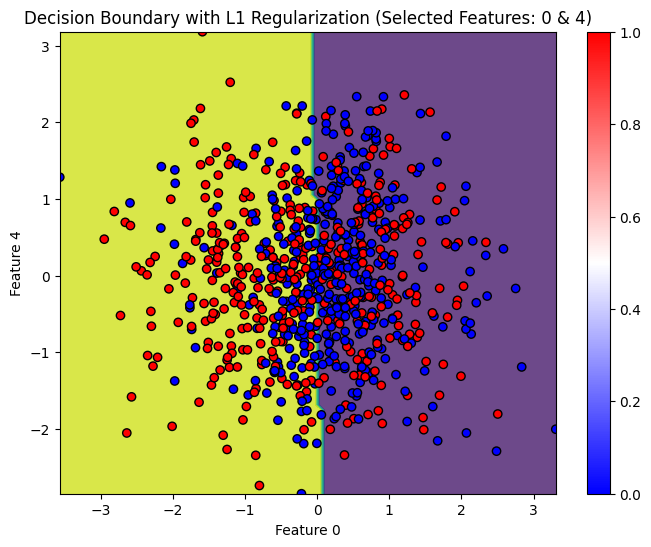

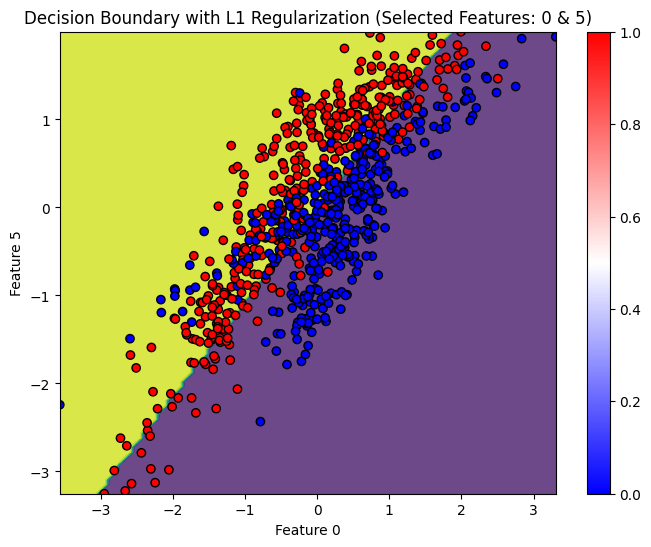

zbieglo po 439 iteracjach


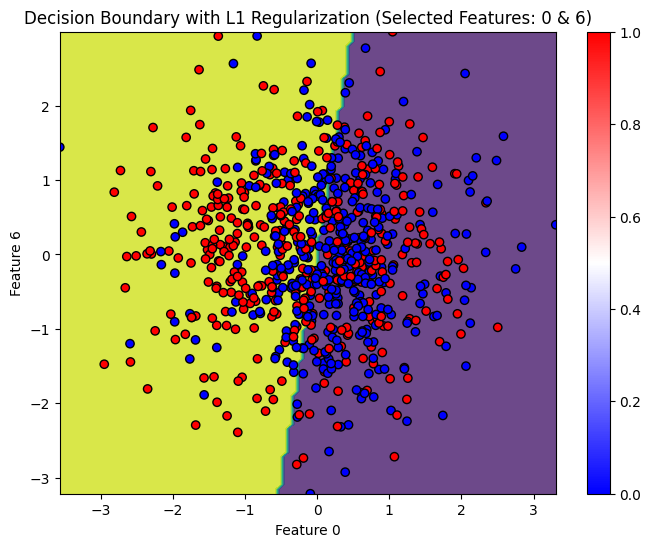

zbieglo po 439 iteracjach


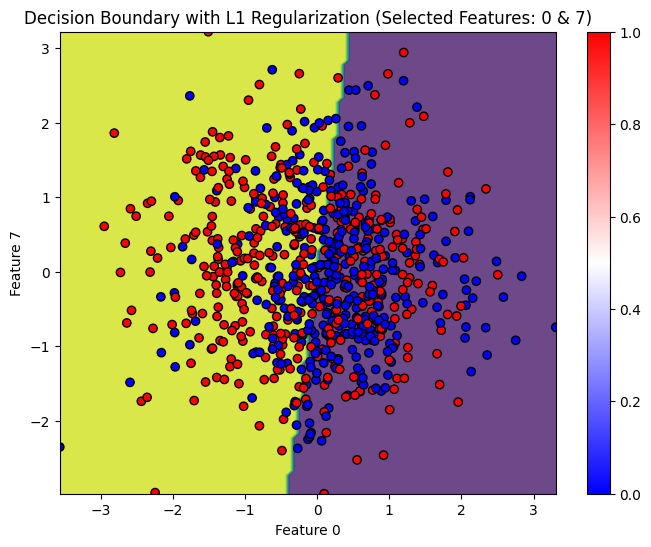

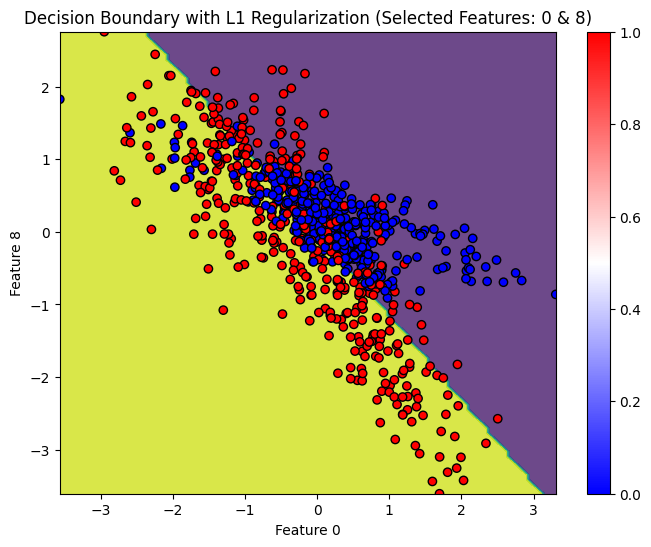

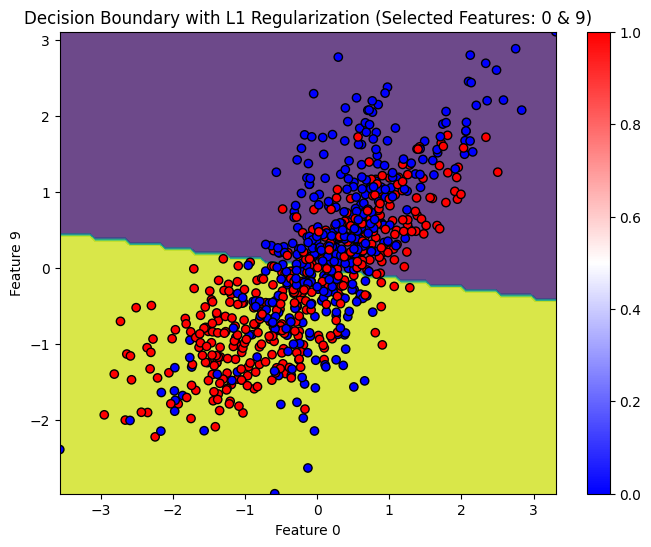

zbieglo po 697 iteracjach


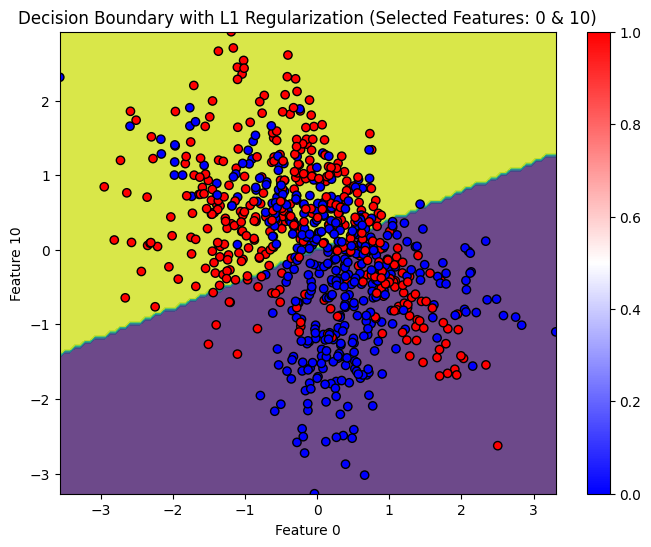

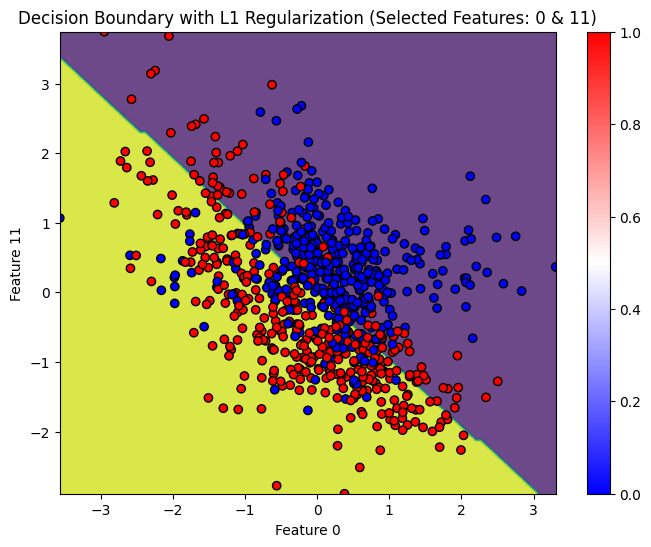

zbieglo po 440 iteracjach


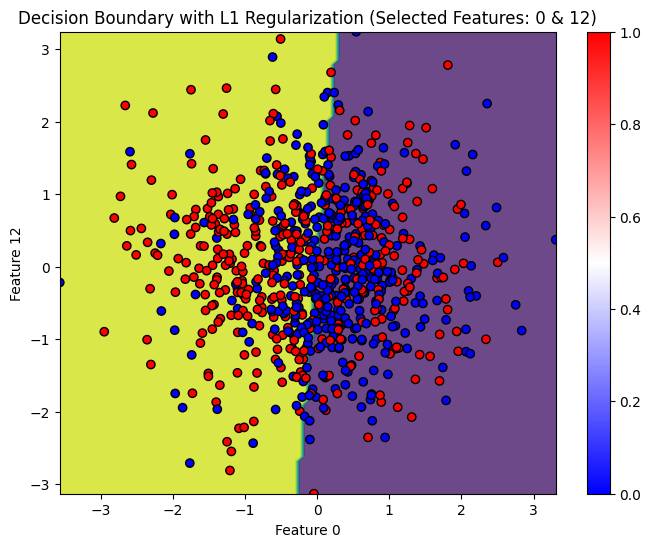

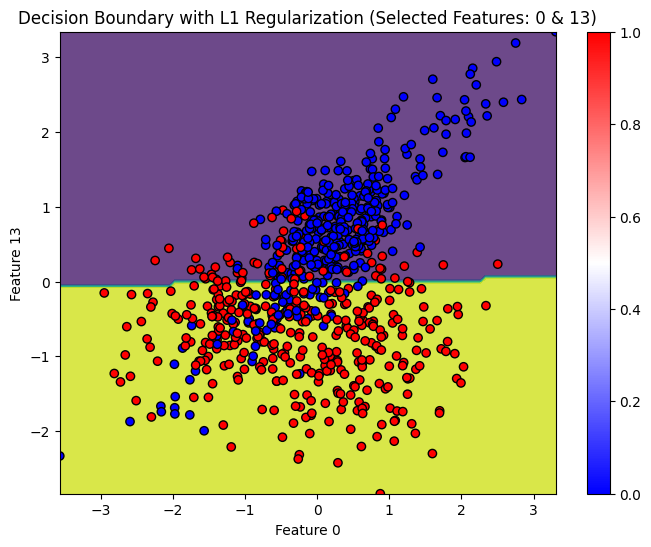

zbieglo po 571 iteracjach


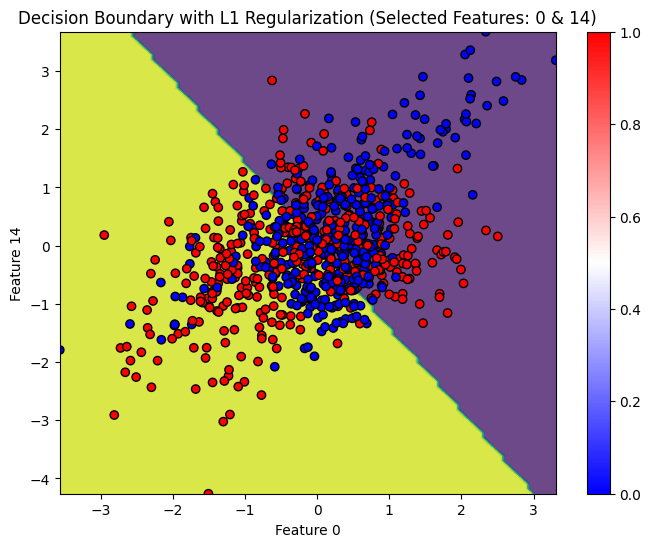

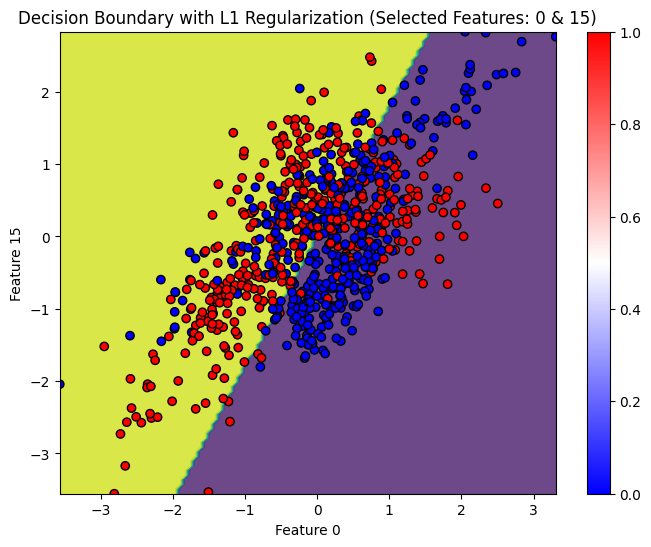

zbieglo po 444 iteracjach


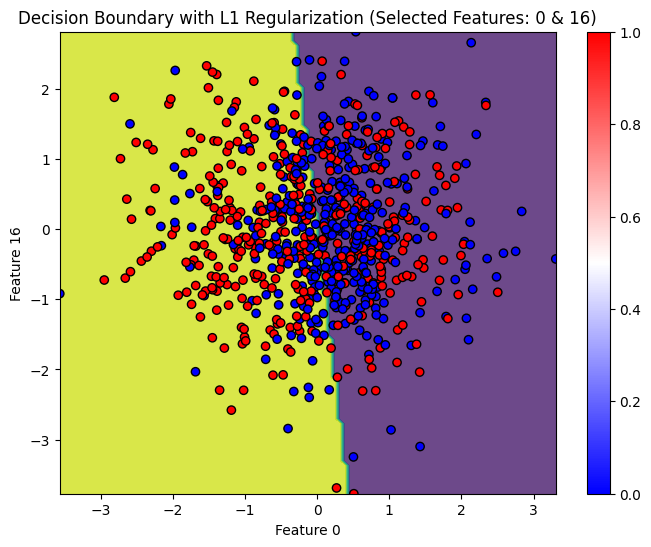

zbieglo po 440 iteracjach


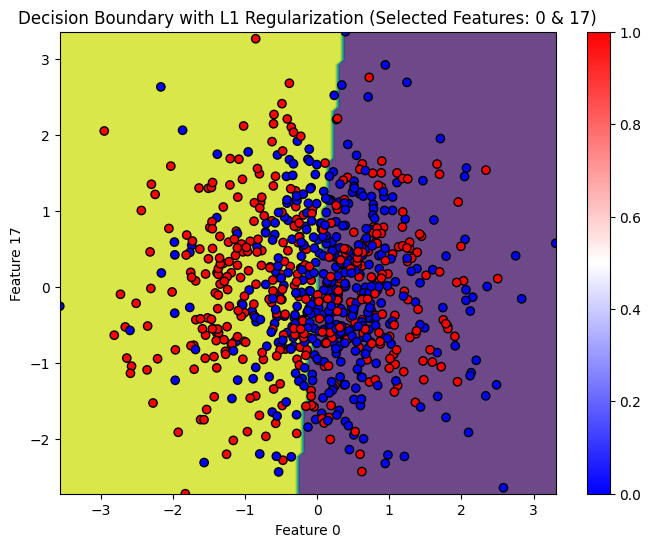

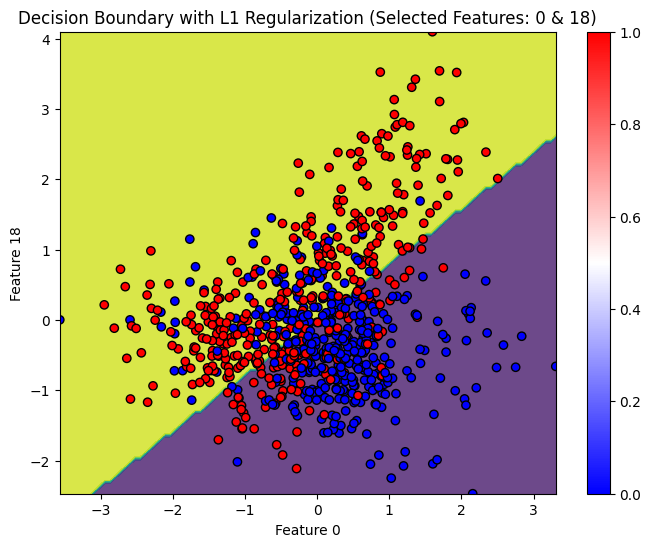

zbieglo po 439 iteracjach


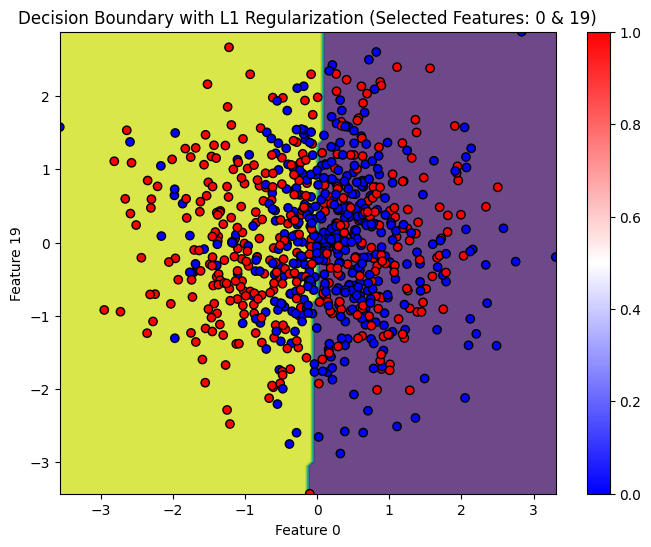

zbieglo po 338 iteracjach


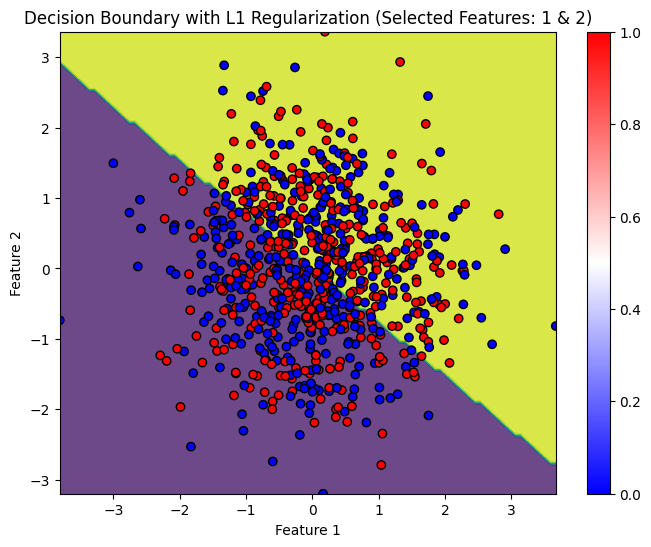

zbieglo po 291 iteracjach


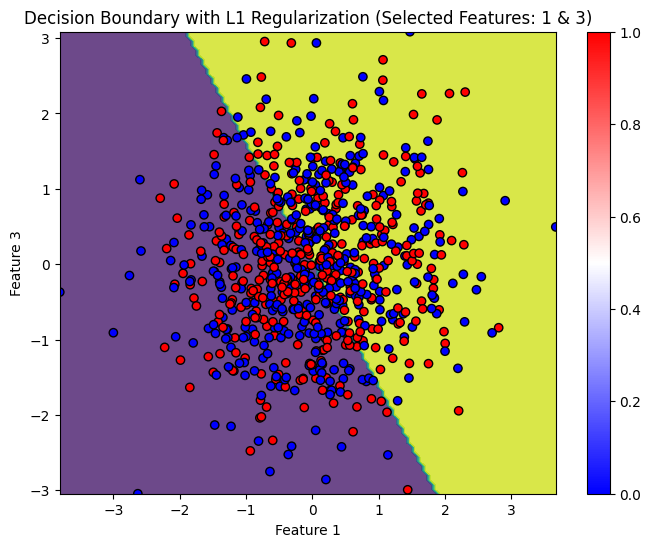

zbieglo po 301 iteracjach


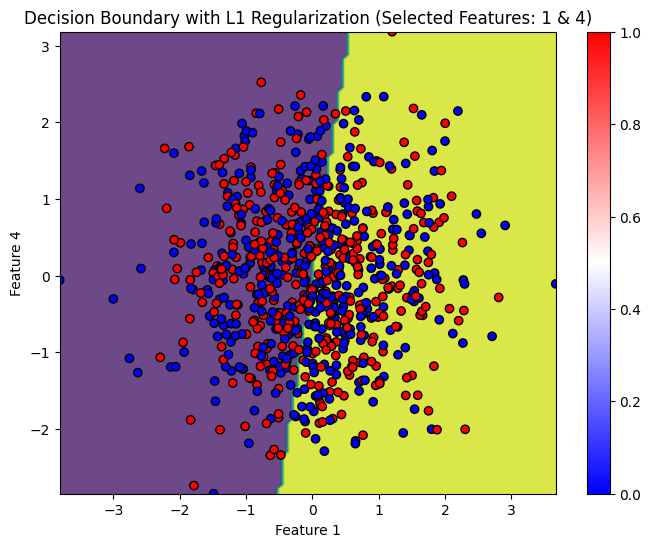

zbieglo po 360 iteracjach


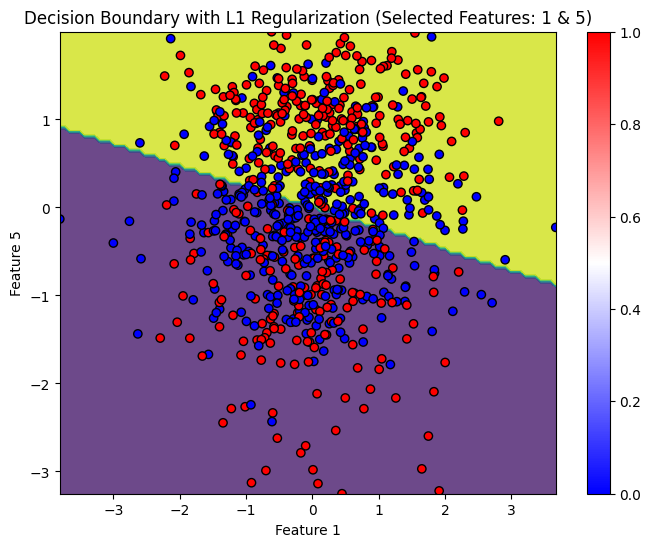

zbieglo po 312 iteracjach


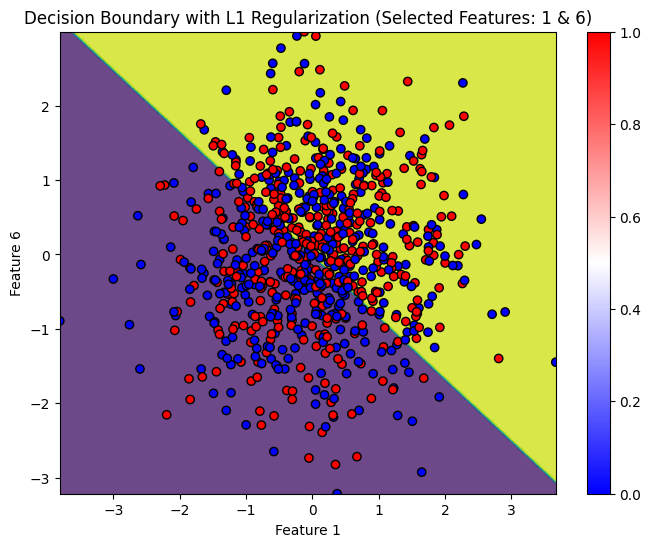

zbieglo po 319 iteracjach


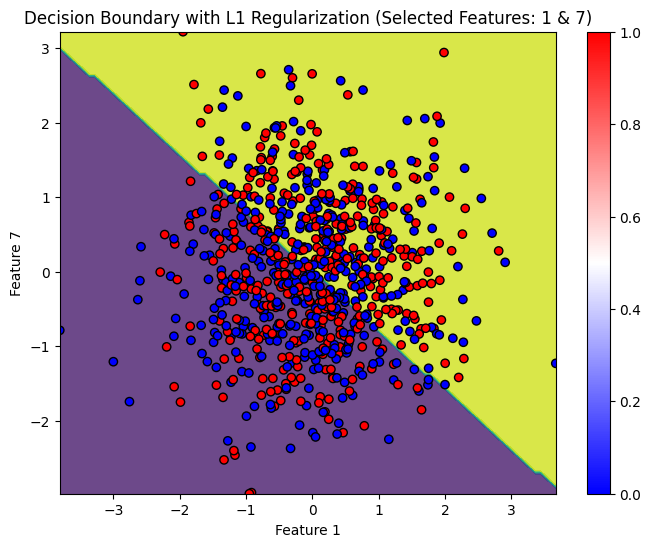

zbieglo po 362 iteracjach


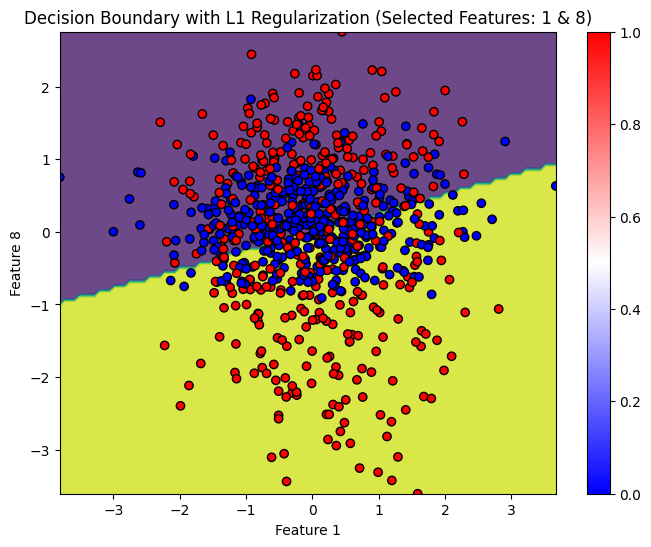

zbieglo po 485 iteracjach


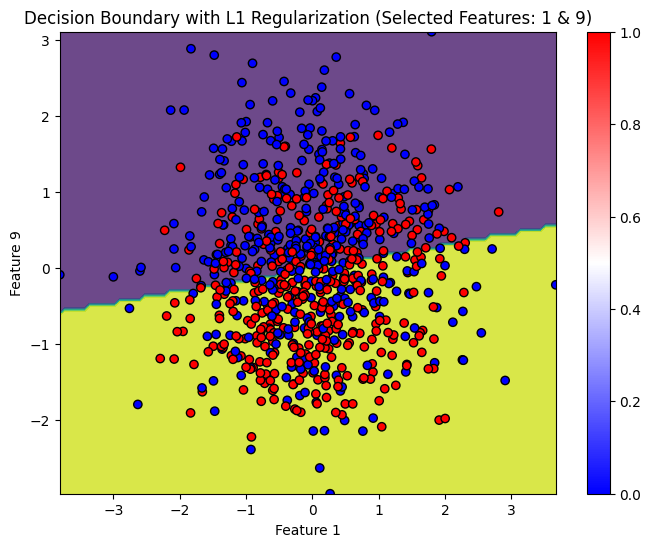

zbieglo po 527 iteracjach


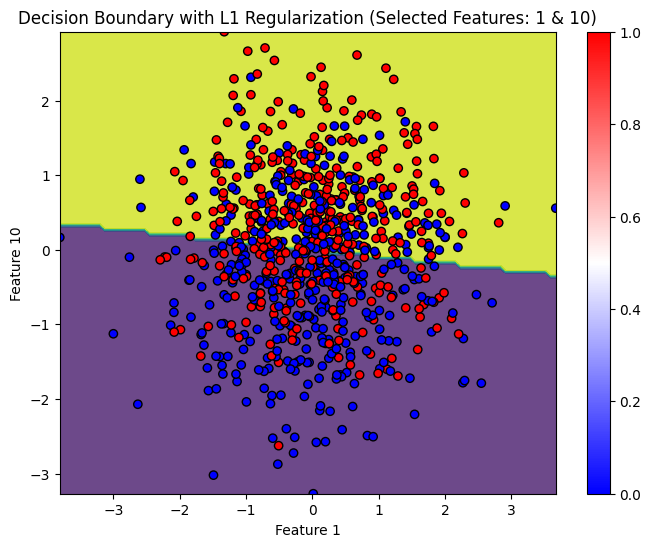

zbieglo po 496 iteracjach


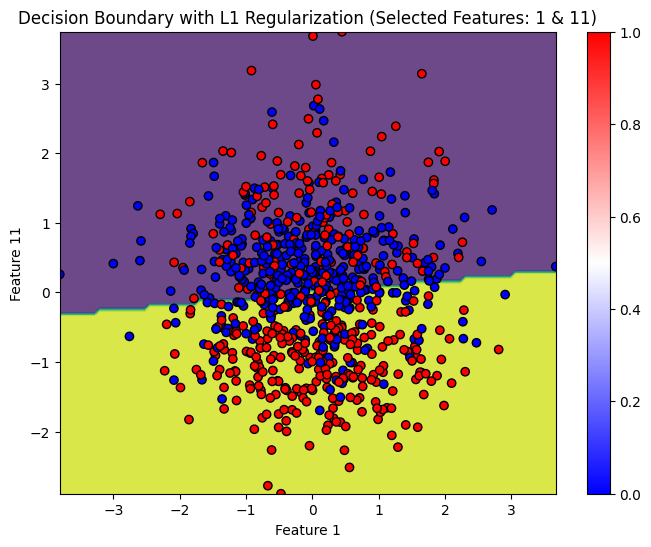

zbieglo po 300 iteracjach


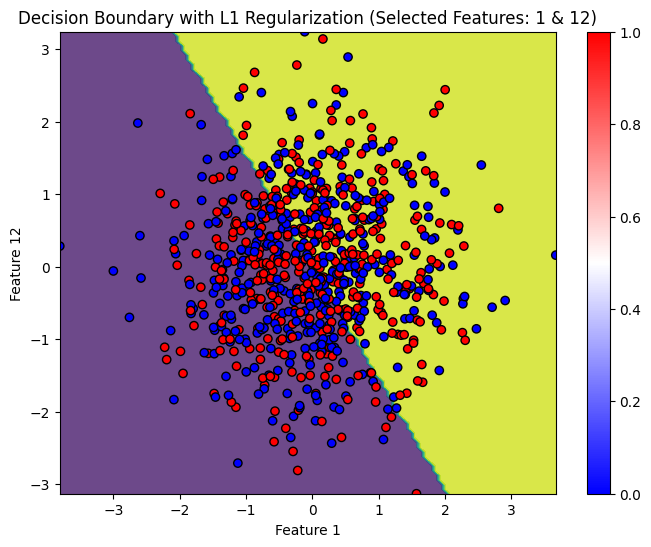

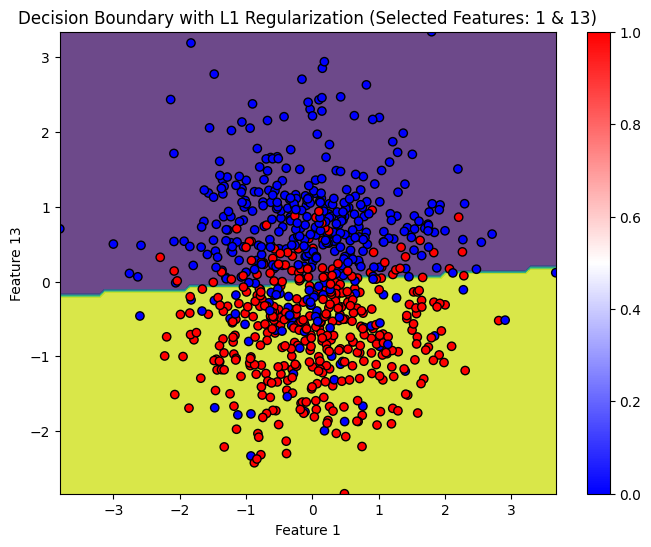

zbieglo po 432 iteracjach


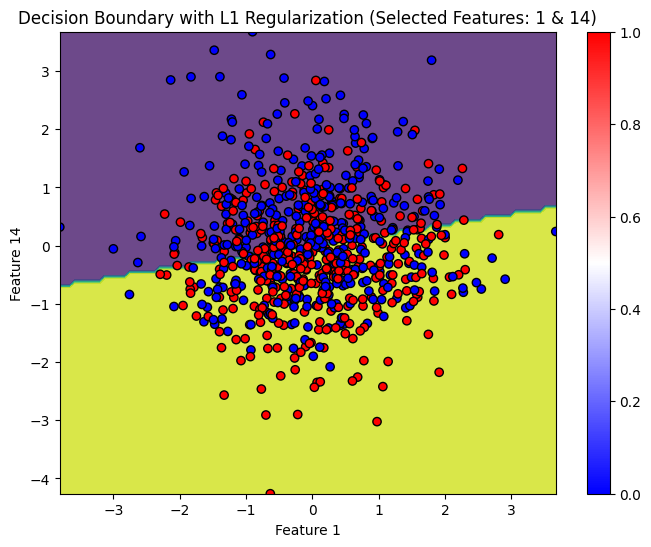

zbieglo po 313 iteracjach


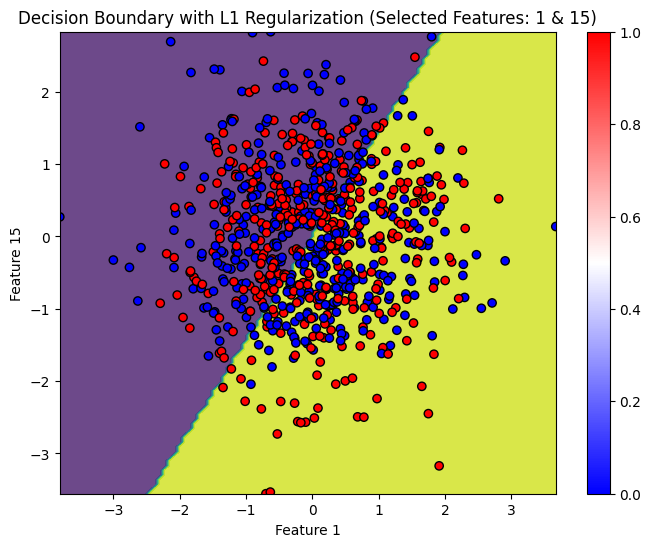

zbieglo po 297 iteracjach


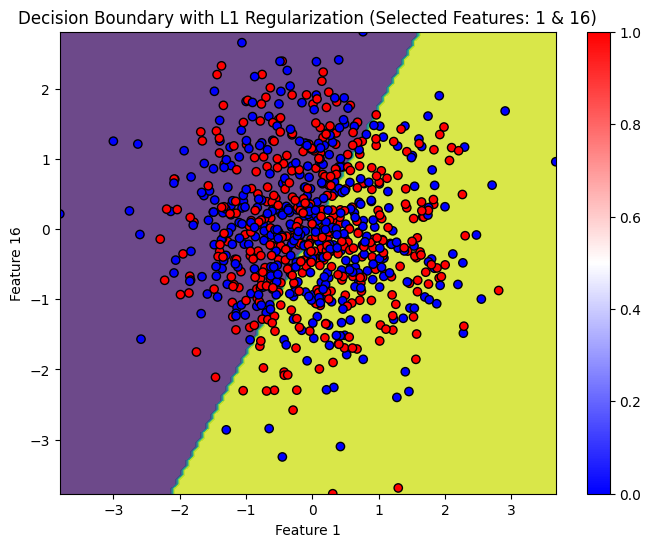

zbieglo po 309 iteracjach


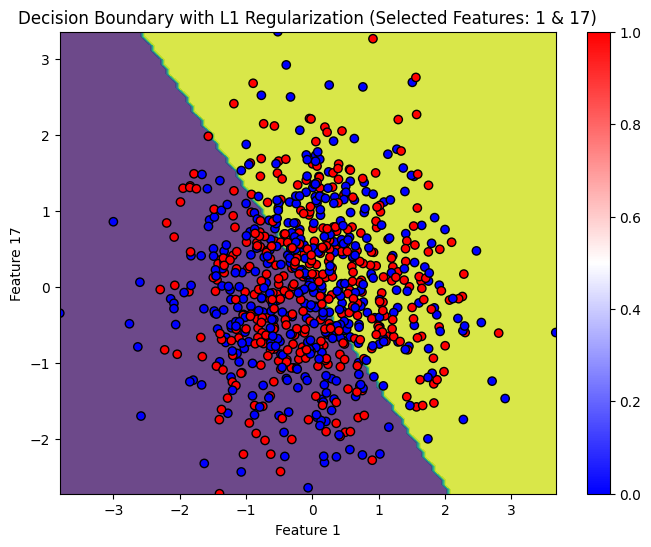

zbieglo po 649 iteracjach


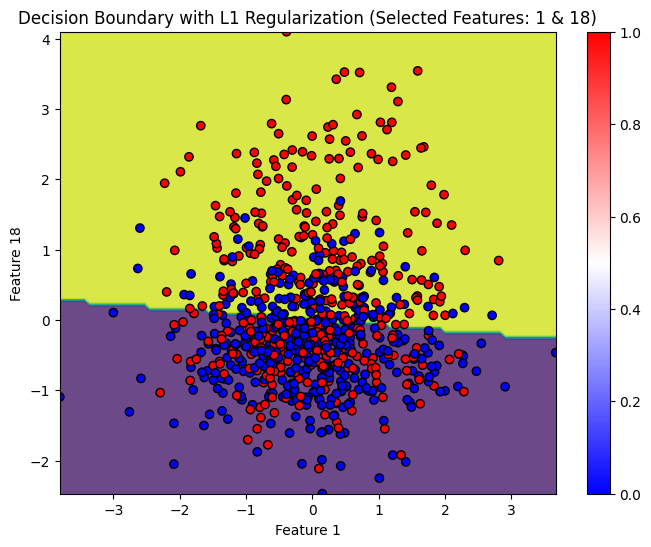

zbieglo po 321 iteracjach


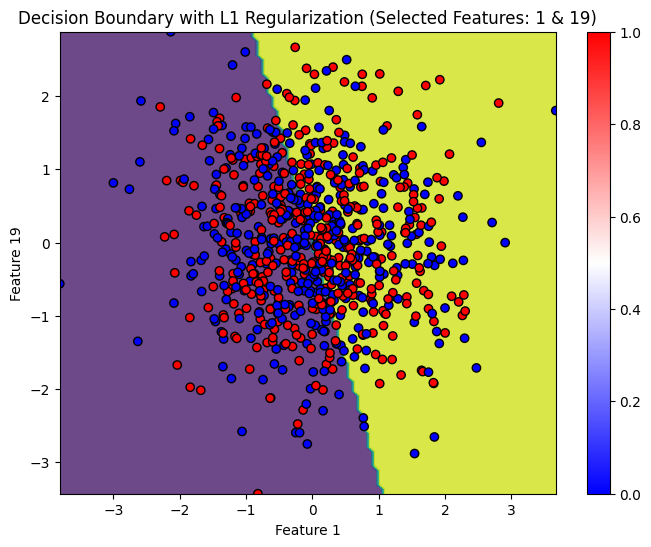

zbieglo po 318 iteracjach


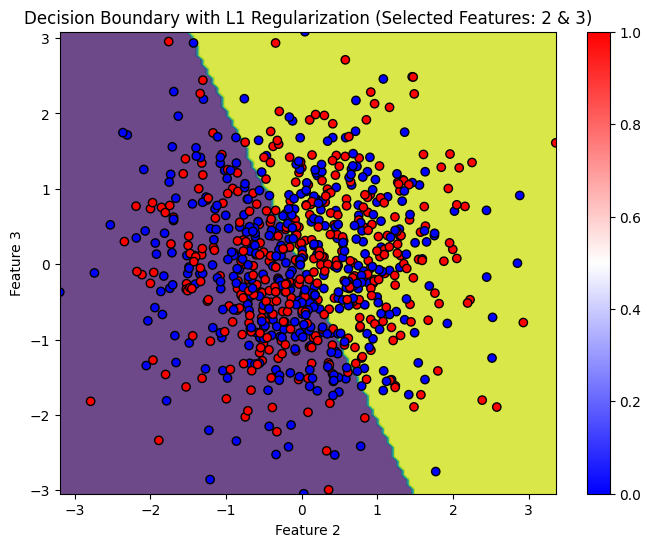

zbieglo po 311 iteracjach


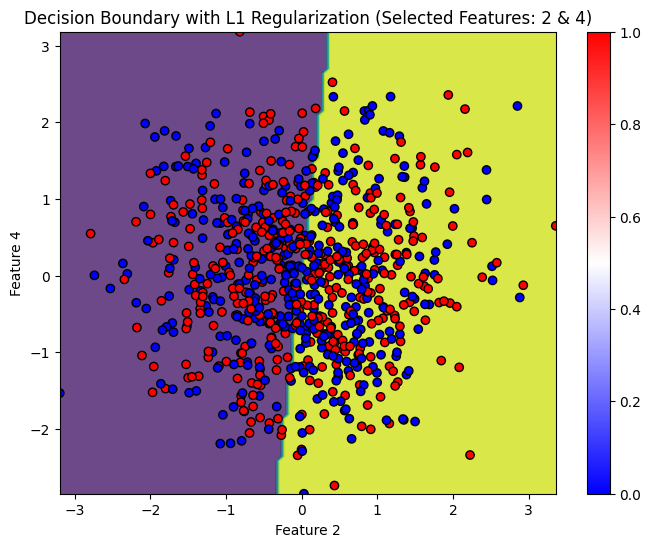

zbieglo po 385 iteracjach


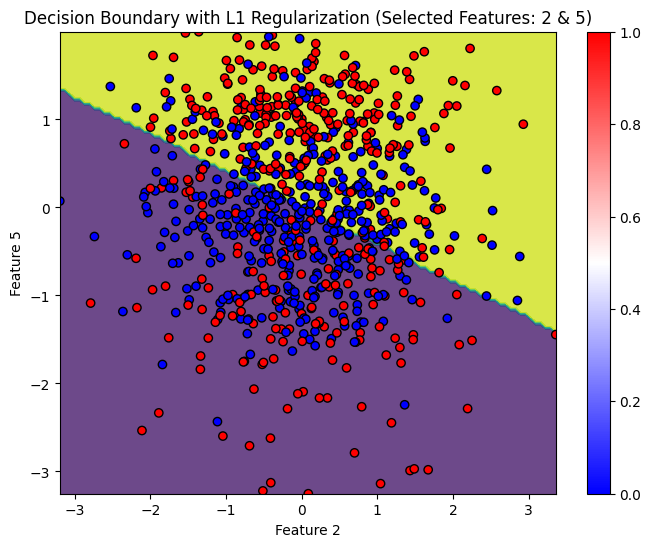

zbieglo po 343 iteracjach


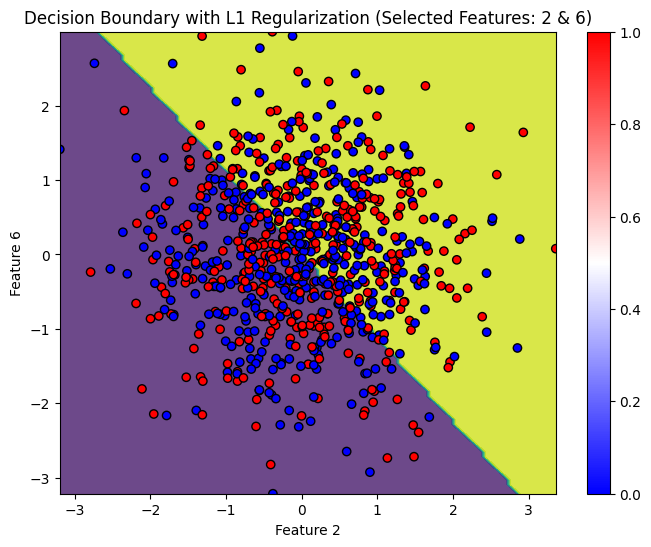

zbieglo po 315 iteracjach


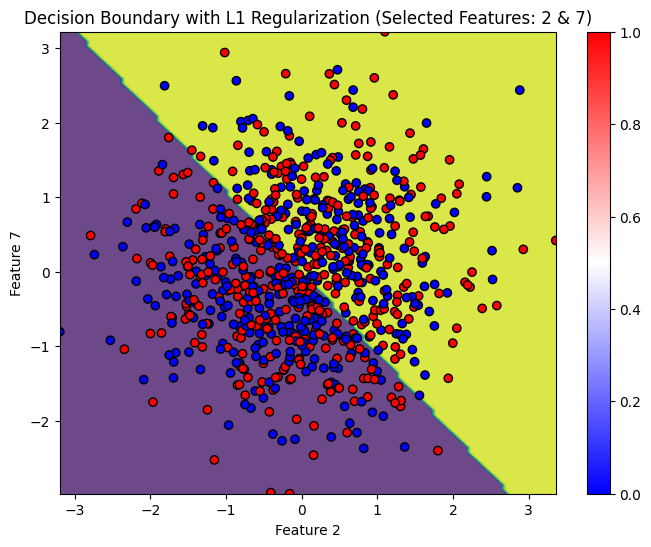

zbieglo po 373 iteracjach


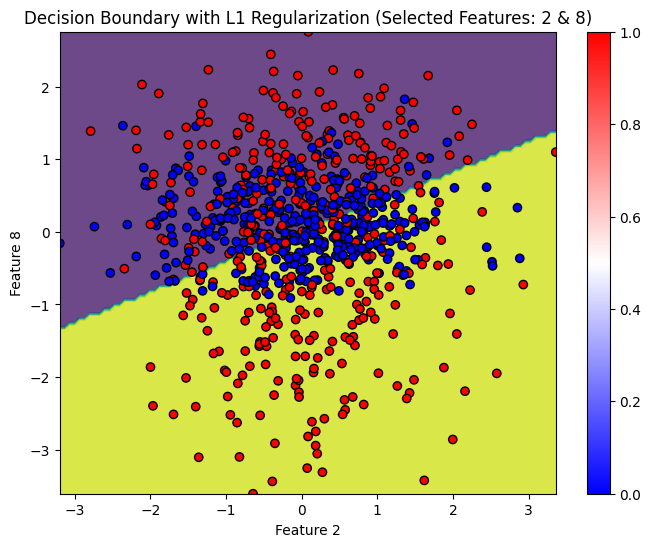

zbieglo po 473 iteracjach


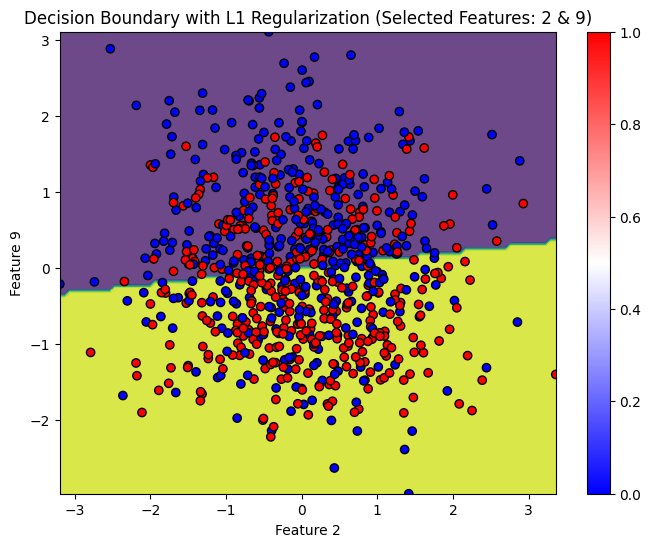

zbieglo po 527 iteracjach


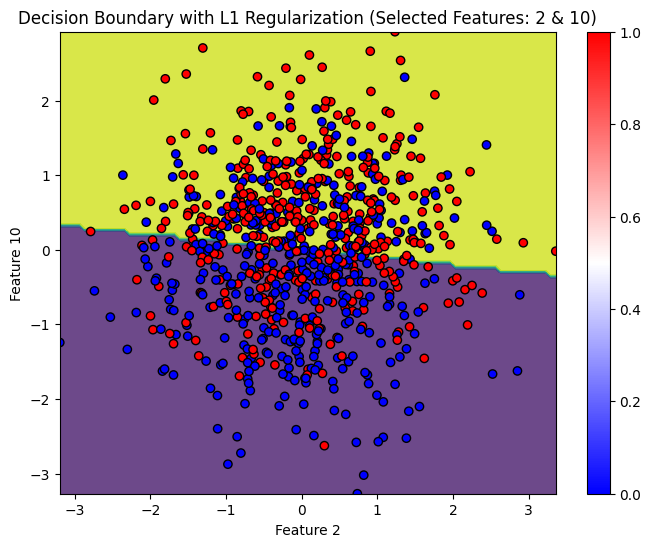

zbieglo po 501 iteracjach


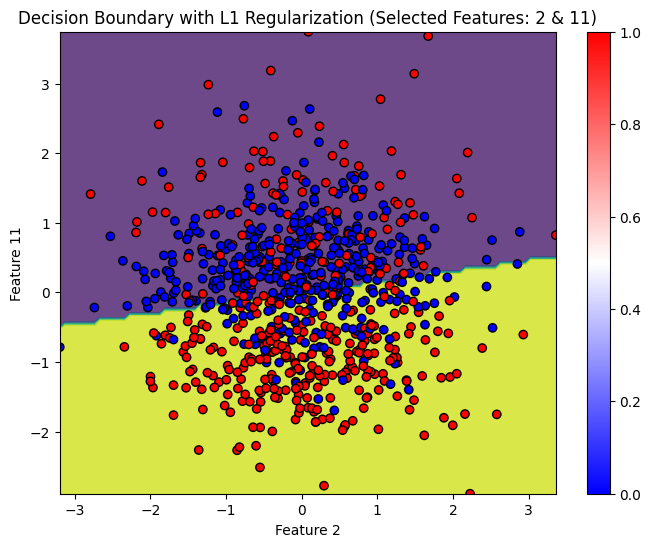

zbieglo po 313 iteracjach


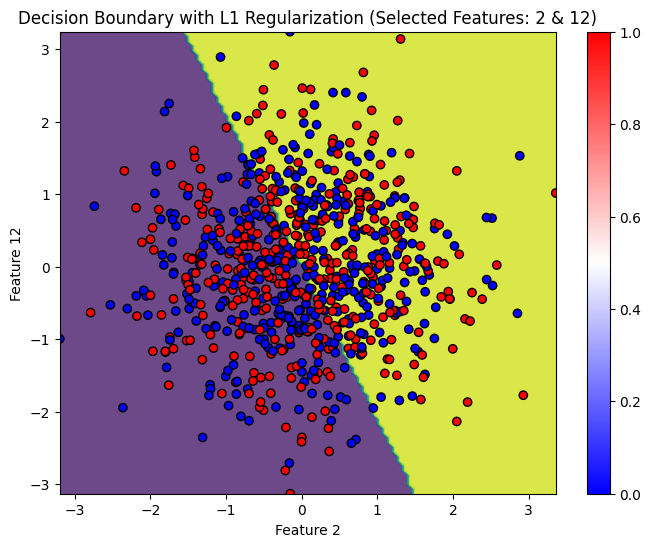

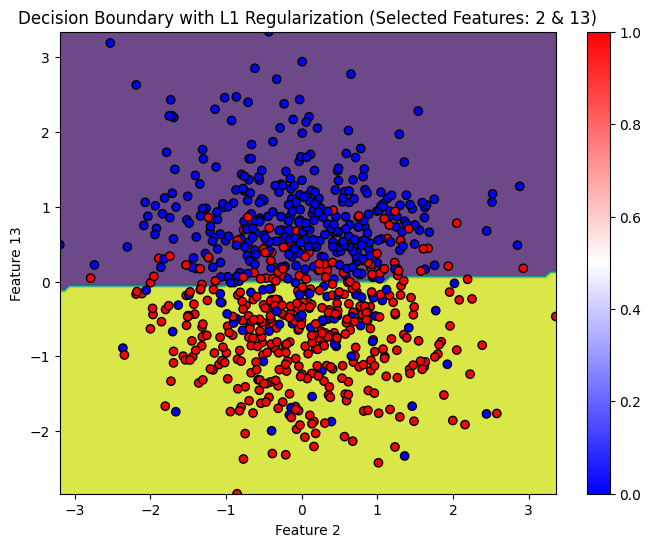

zbieglo po 432 iteracjach


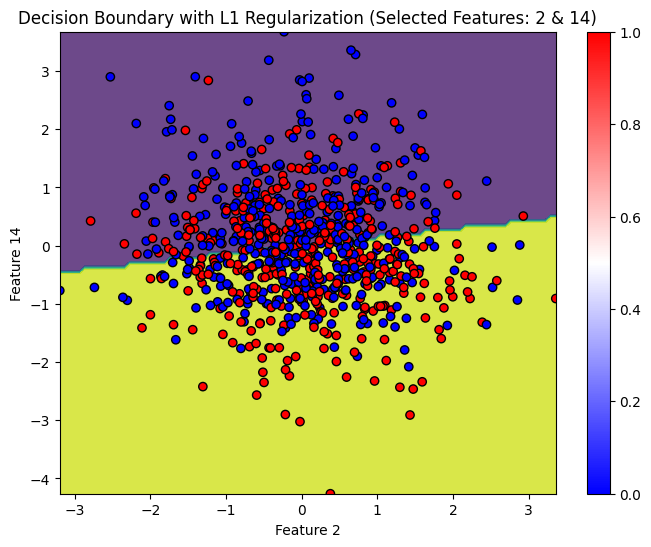

zbieglo po 305 iteracjach


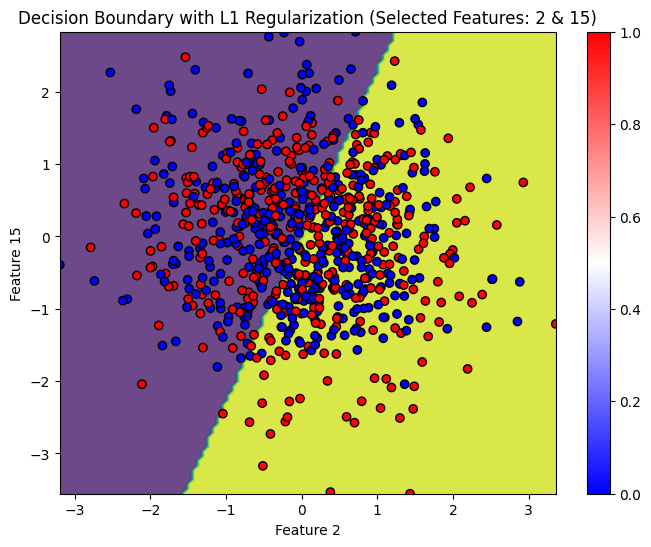

zbieglo po 312 iteracjach


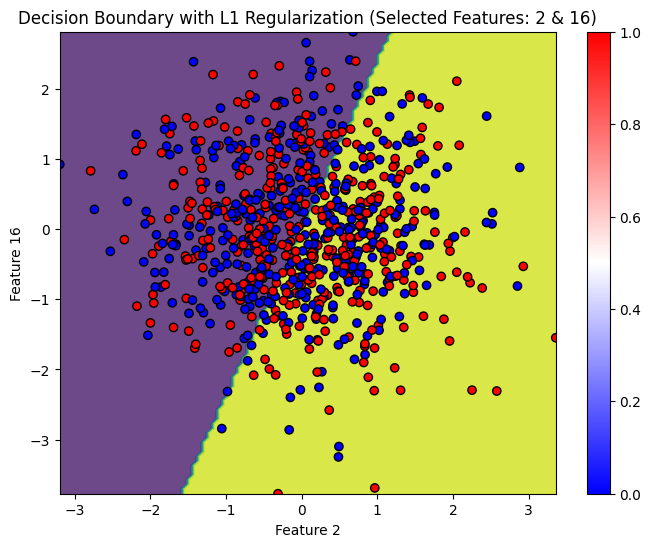

zbieglo po 314 iteracjach


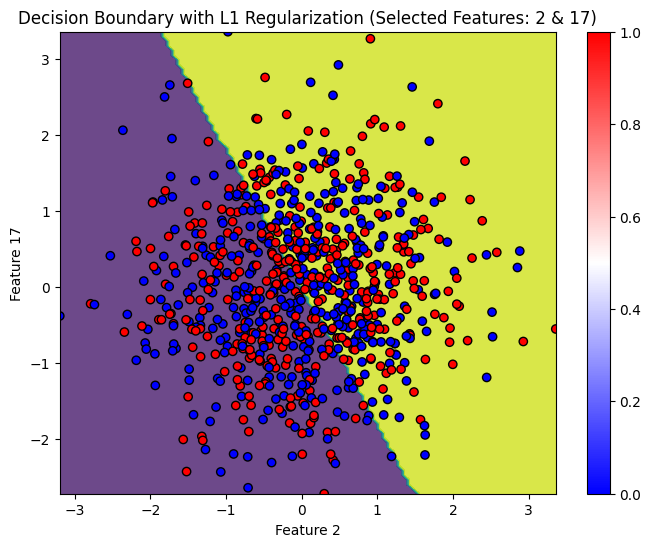

zbieglo po 651 iteracjach


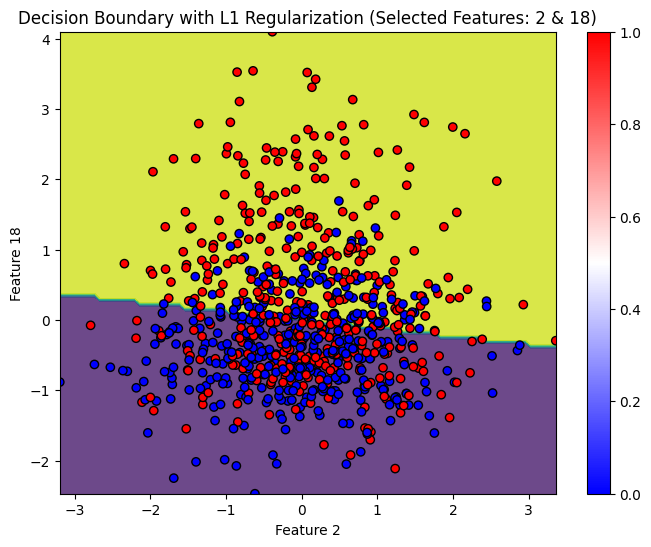

zbieglo po 314 iteracjach


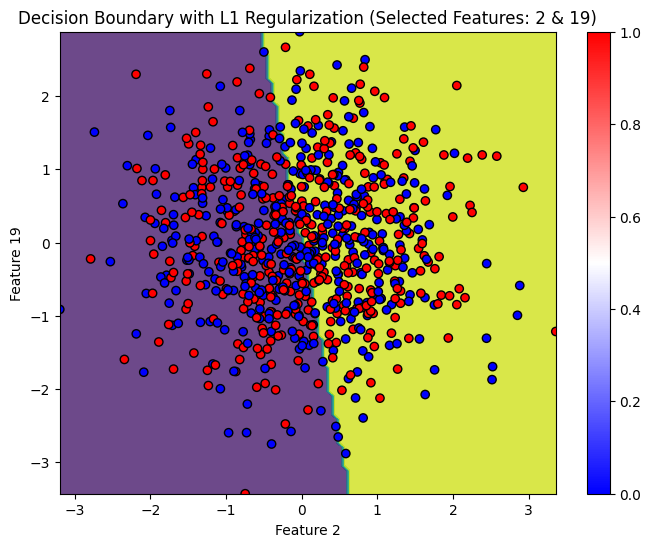

zbieglo po 284 iteracjach


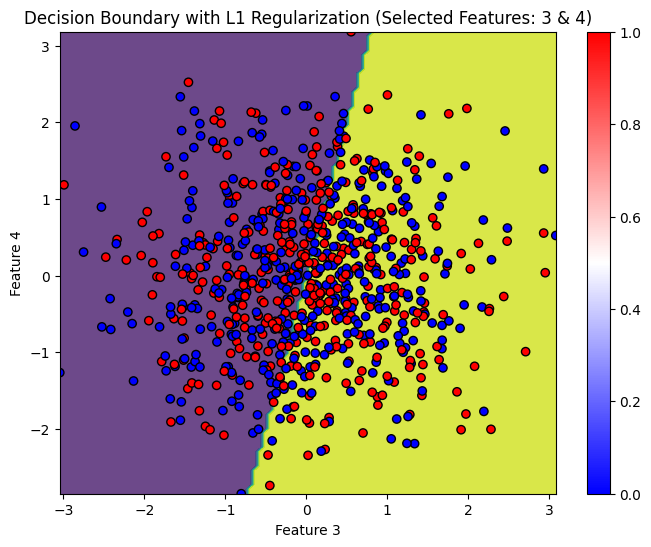

zbieglo po 365 iteracjach


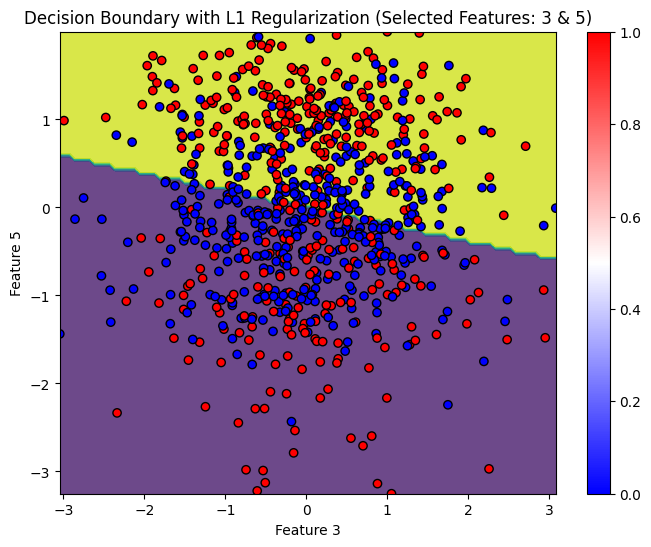

zbieglo po 318 iteracjach


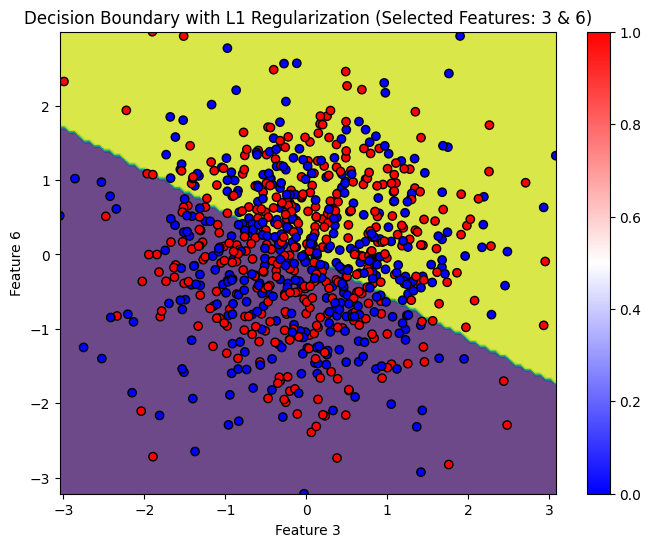

zbieglo po 307 iteracjach


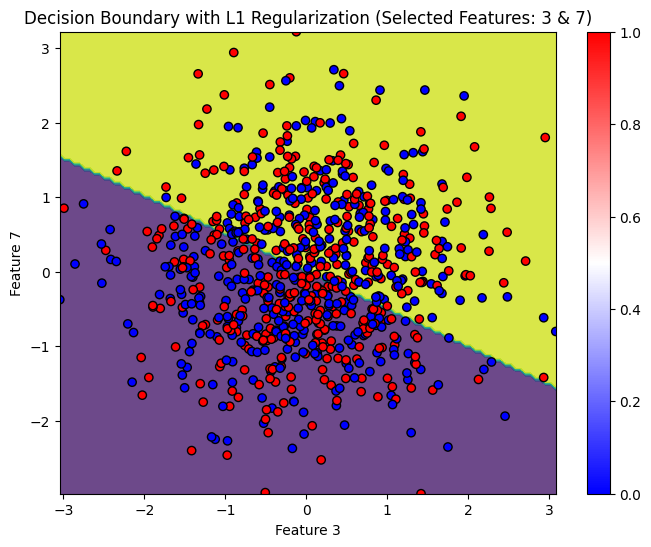

zbieglo po 368 iteracjach


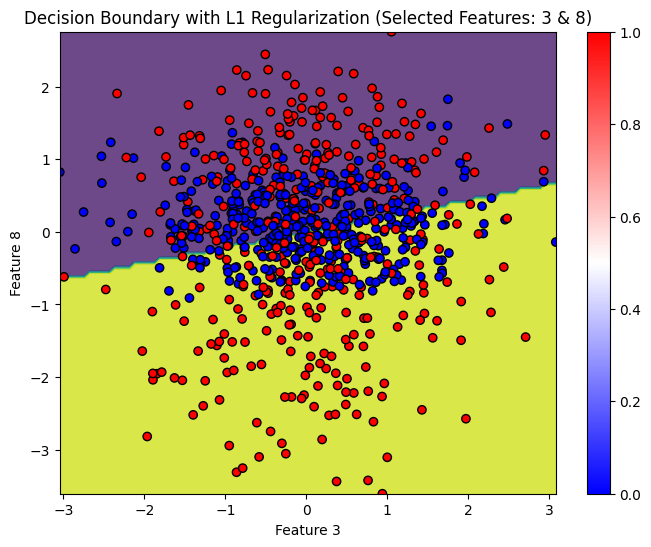

zbieglo po 471 iteracjach


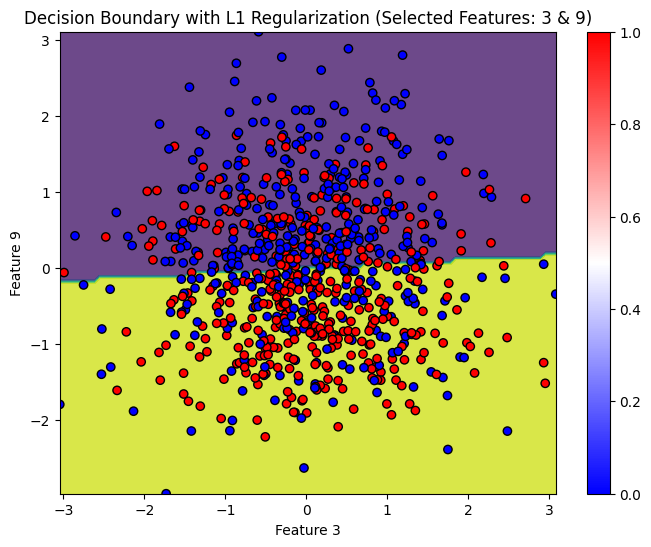

zbieglo po 527 iteracjach


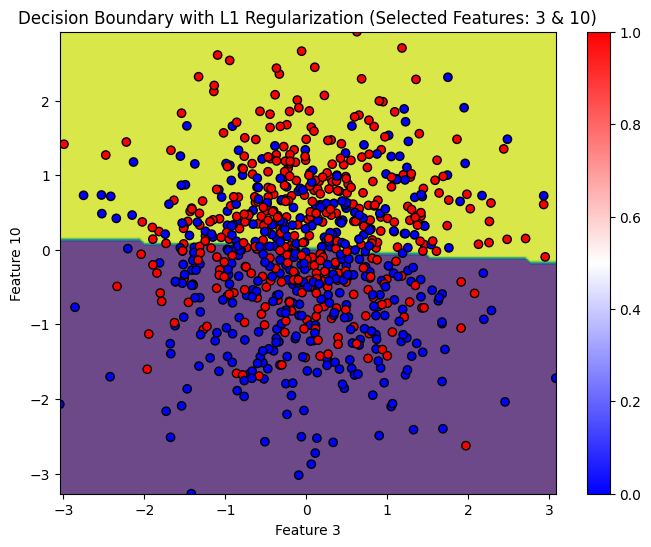

zbieglo po 497 iteracjach


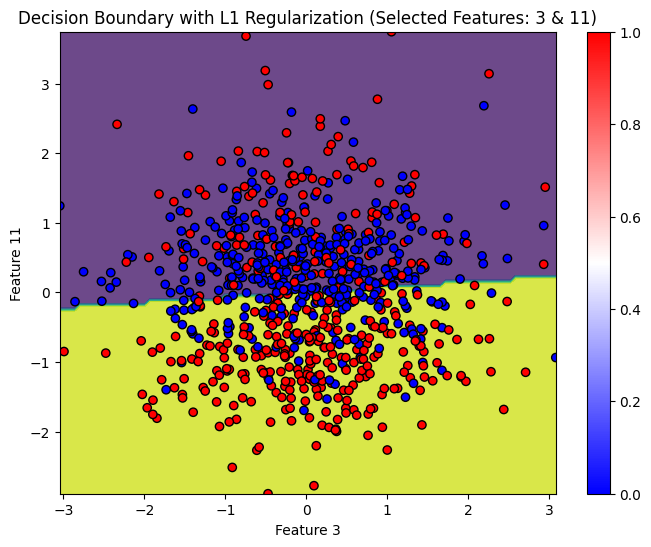

zbieglo po 296 iteracjach


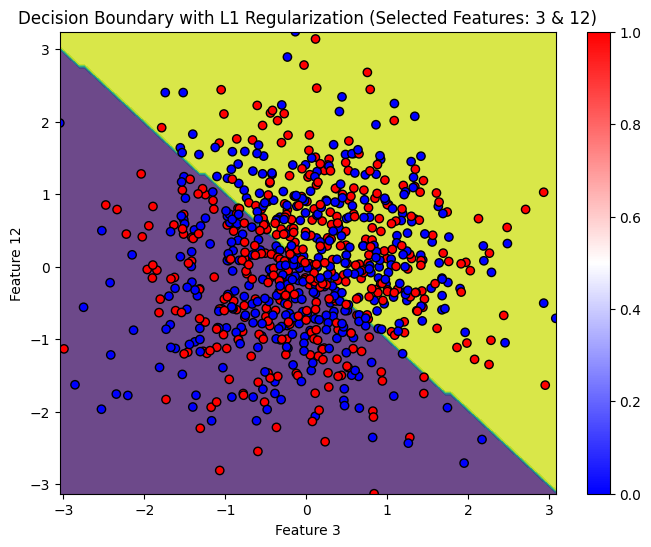

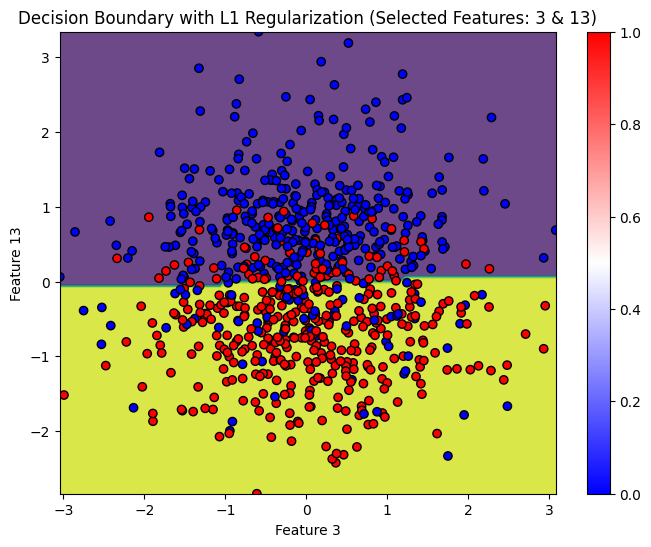

zbieglo po 426 iteracjach


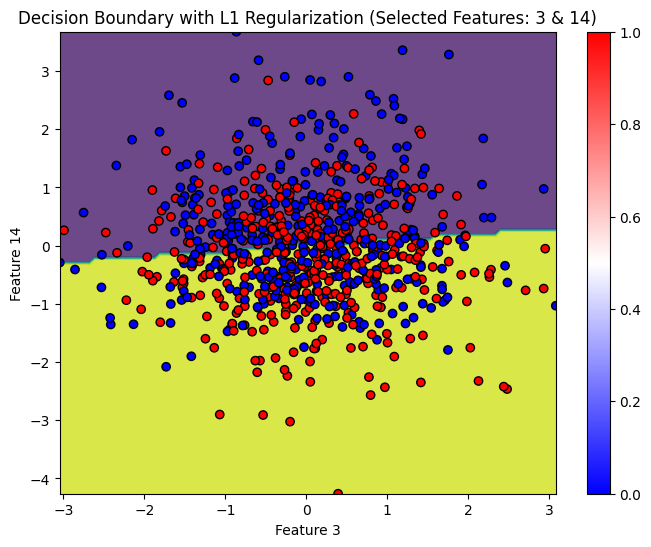

zbieglo po 292 iteracjach


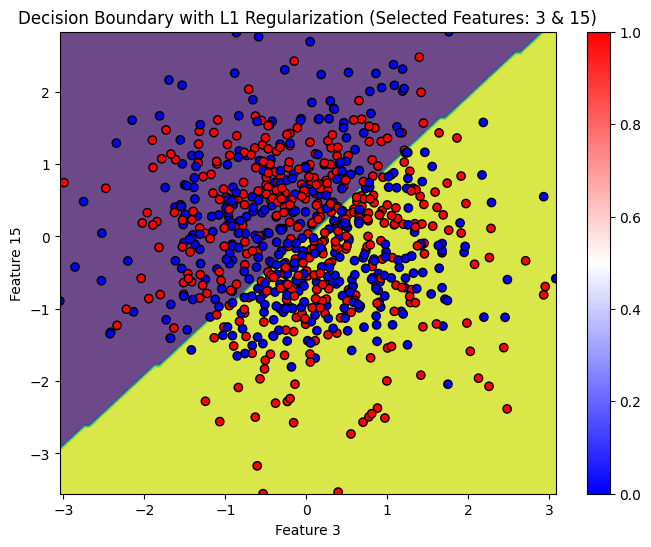

zbieglo po 293 iteracjach


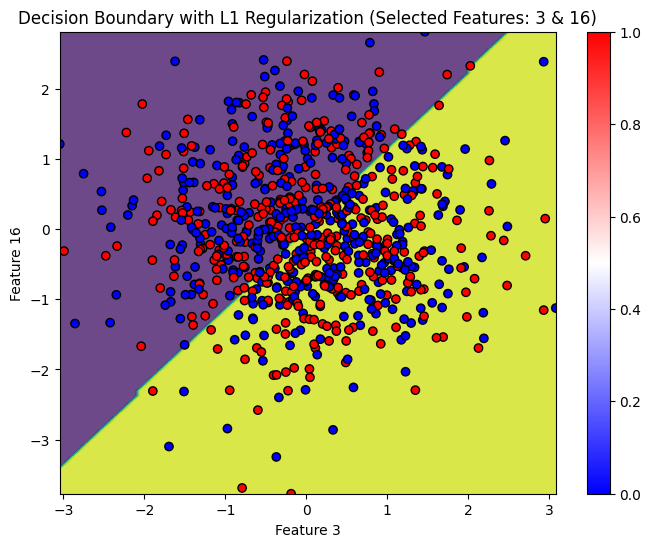

zbieglo po 291 iteracjach


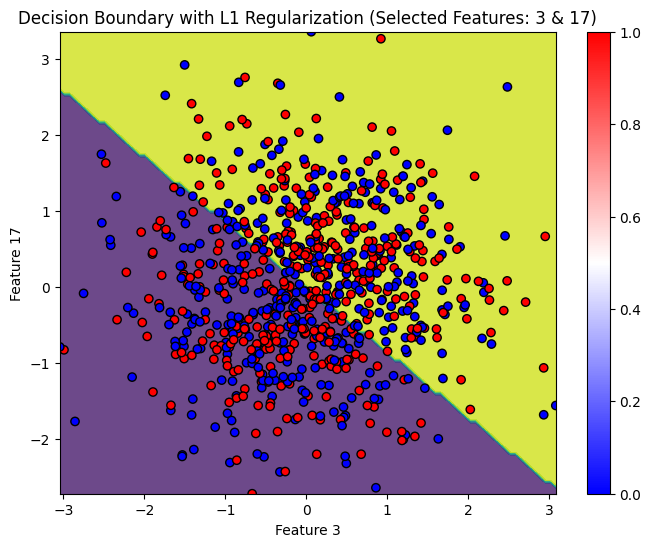

zbieglo po 650 iteracjach


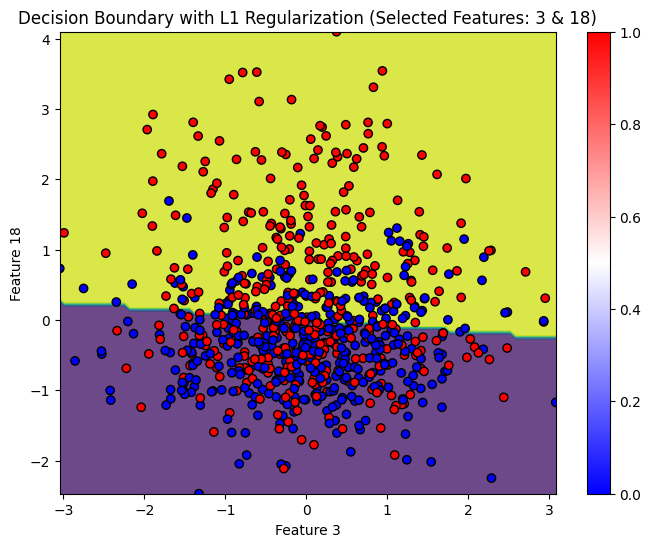

zbieglo po 281 iteracjach


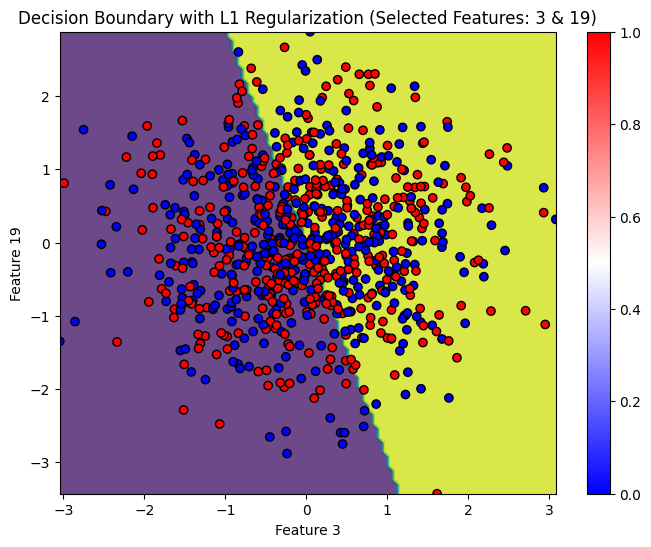

zbieglo po 364 iteracjach


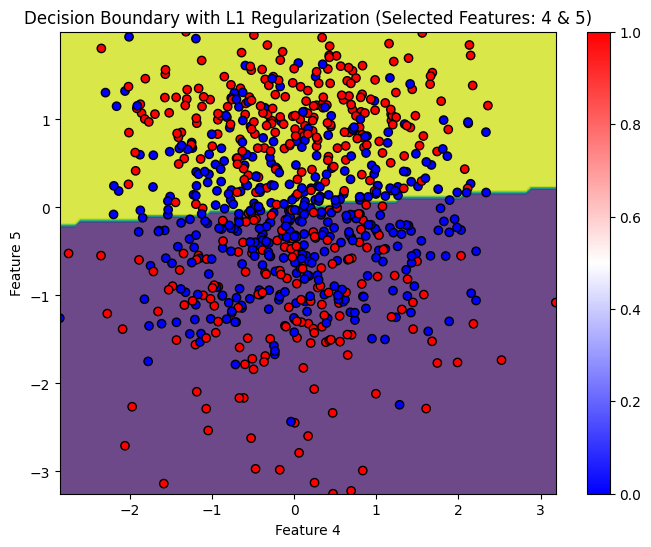

zbieglo po 312 iteracjach


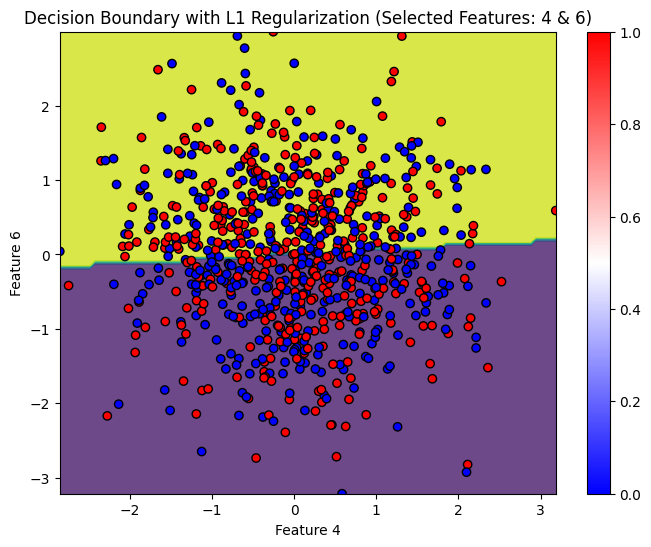

zbieglo po 313 iteracjach


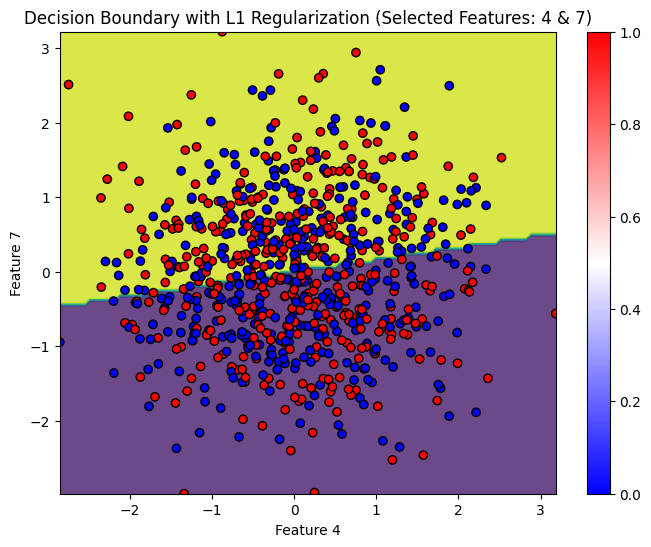

zbieglo po 363 iteracjach


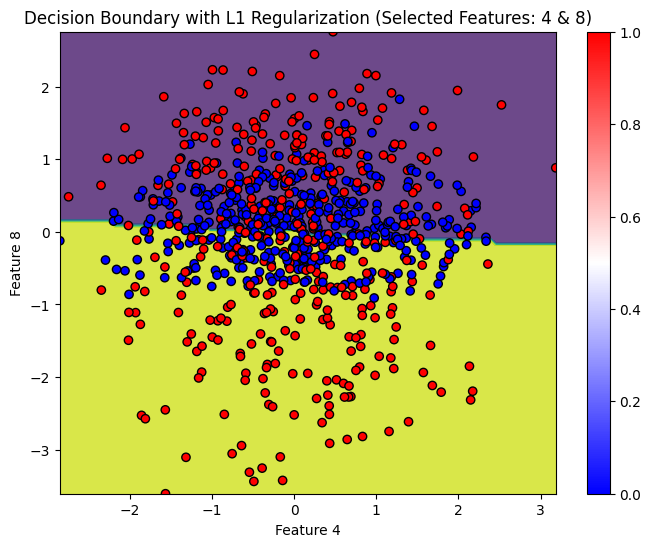

zbieglo po 472 iteracjach


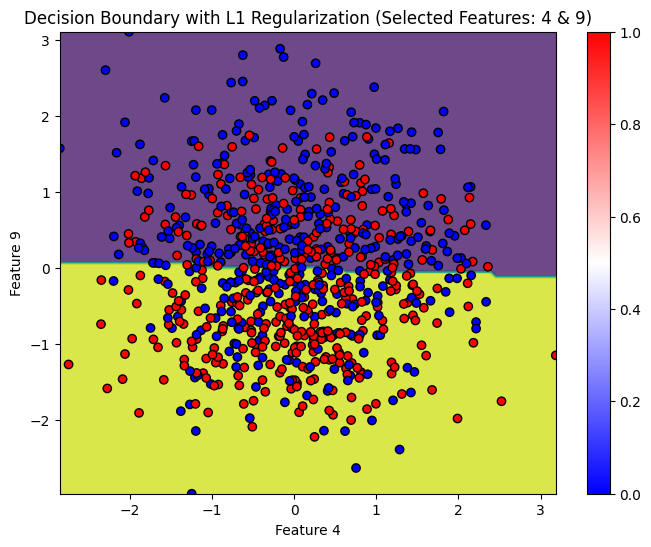

zbieglo po 527 iteracjach


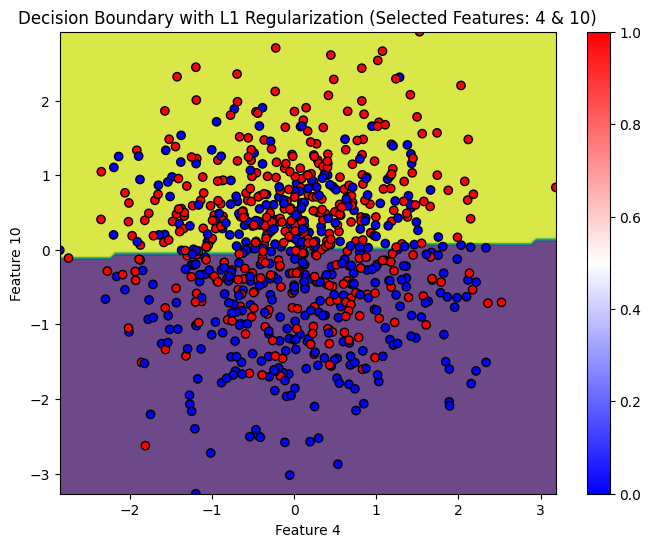

zbieglo po 504 iteracjach


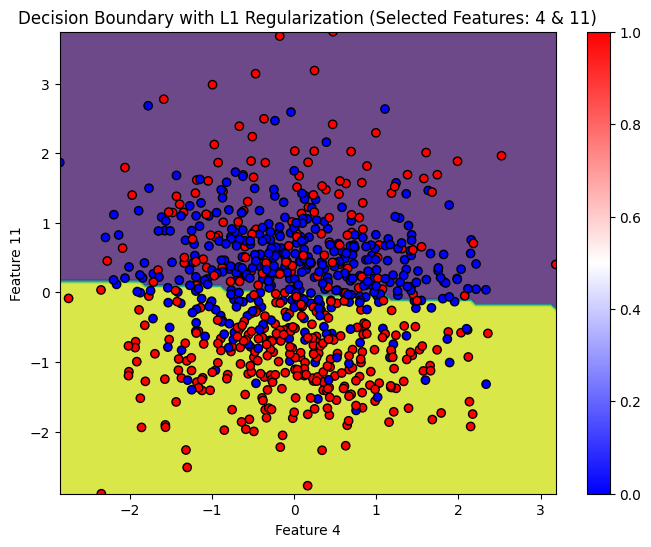

zbieglo po 280 iteracjach


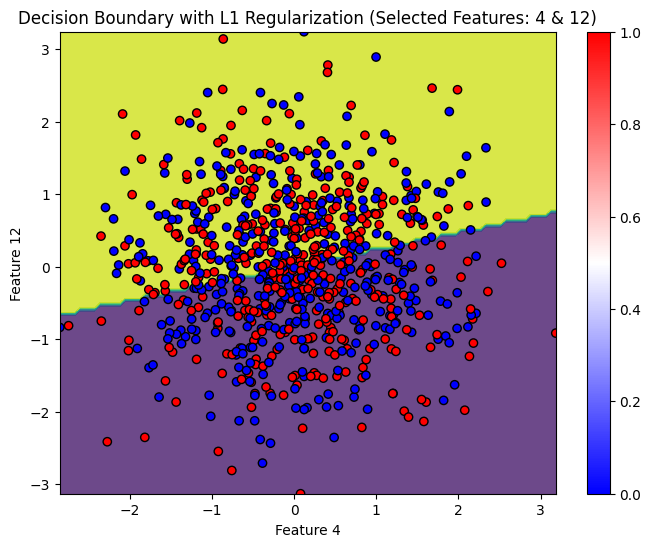

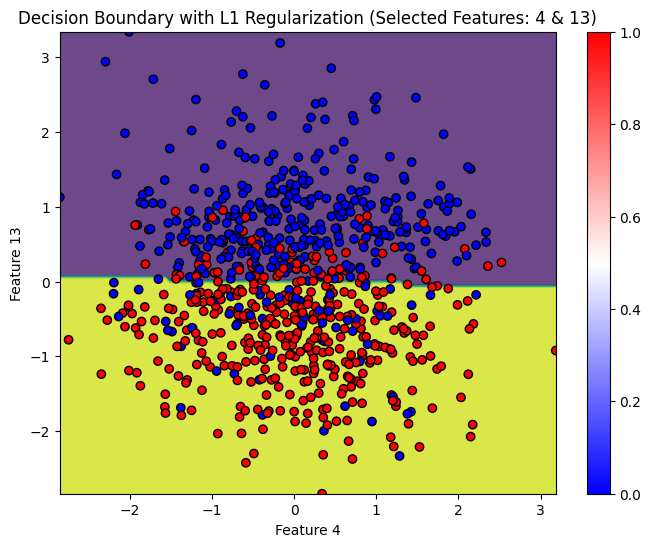

zbieglo po 427 iteracjach


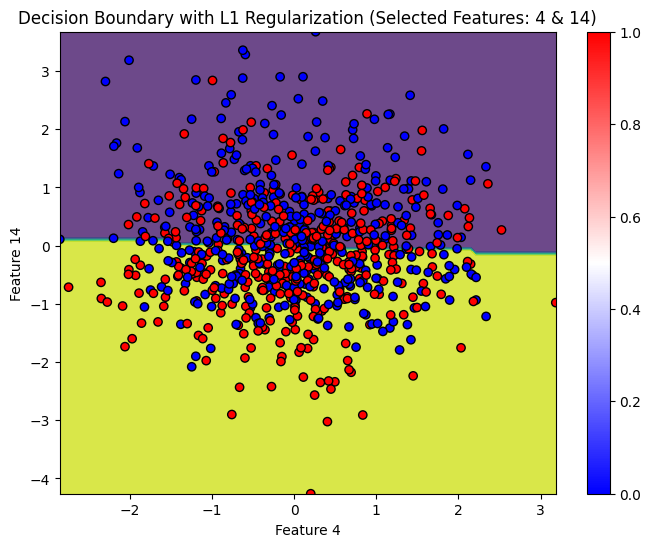

zbieglo po 282 iteracjach


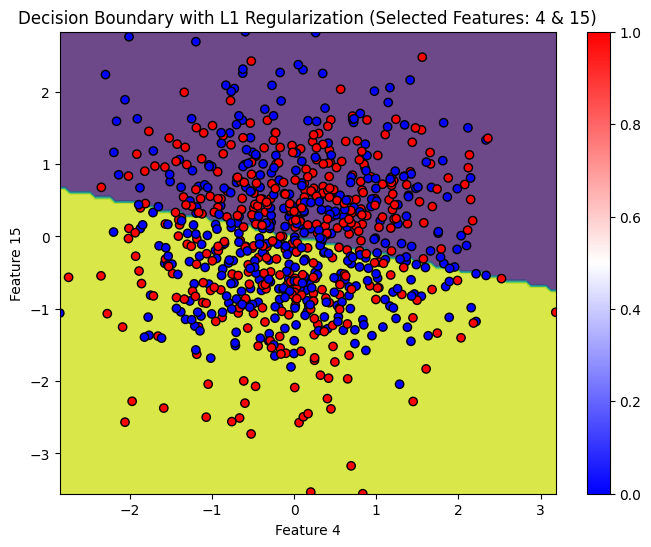

zbieglo po 277 iteracjach


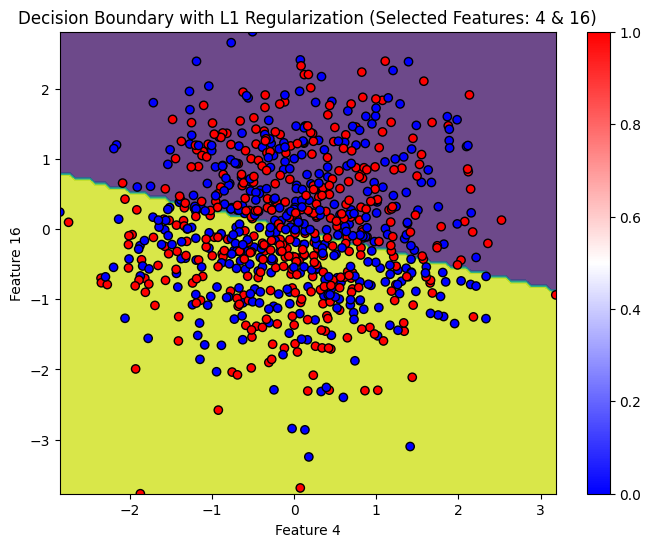

zbieglo po 286 iteracjach


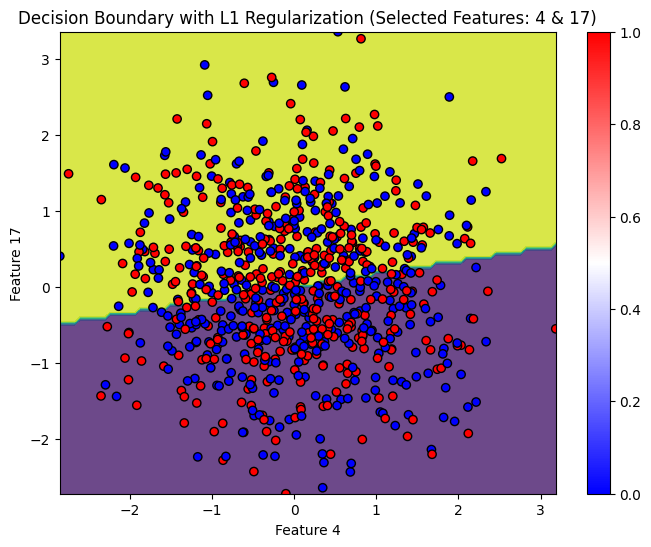

zbieglo po 648 iteracjach


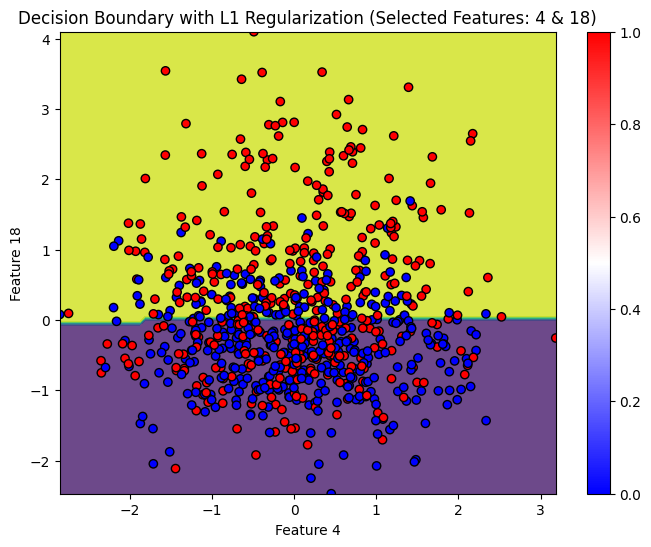

zbieglo po 254 iteracjach


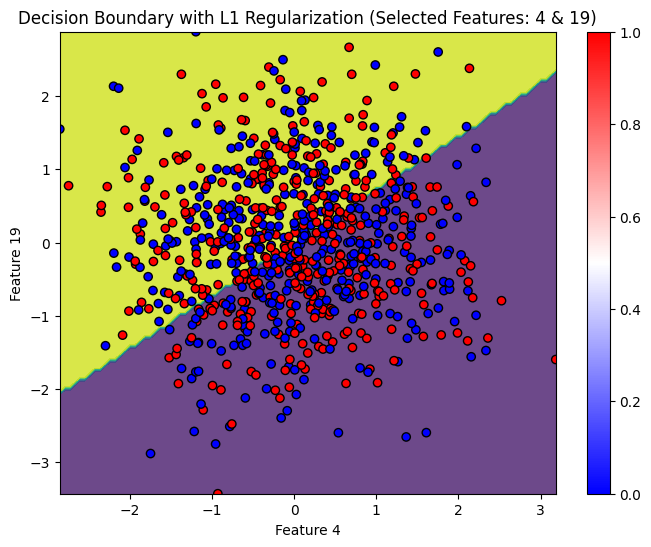

zbieglo po 372 iteracjach


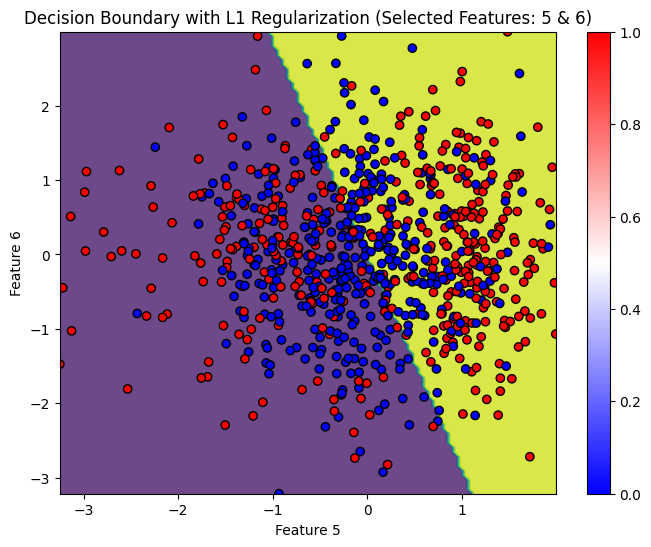

zbieglo po 373 iteracjach


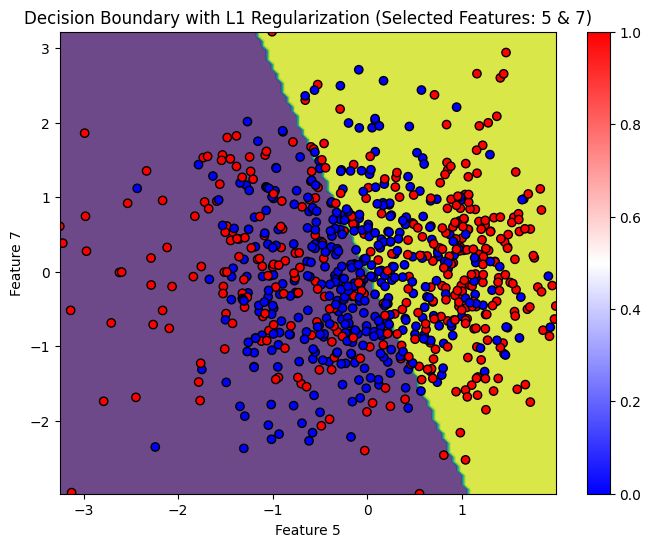

zbieglo po 793 iteracjach


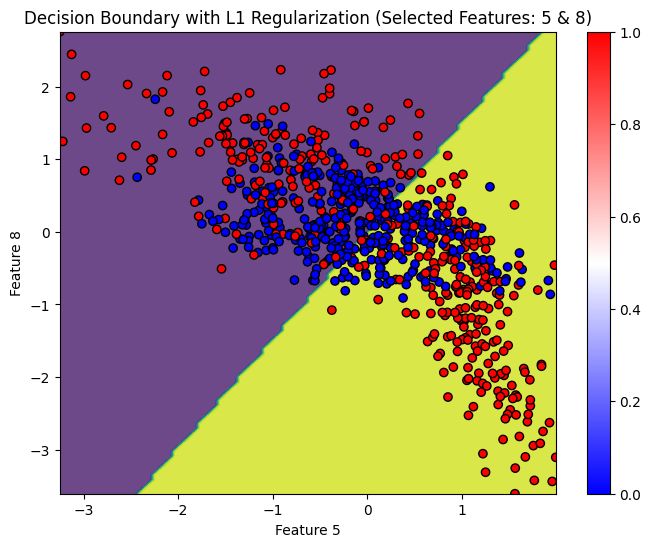

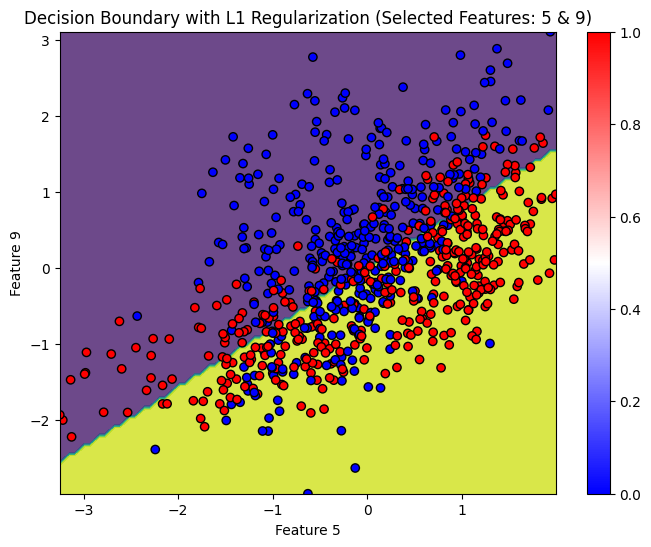

zbieglo po 537 iteracjach


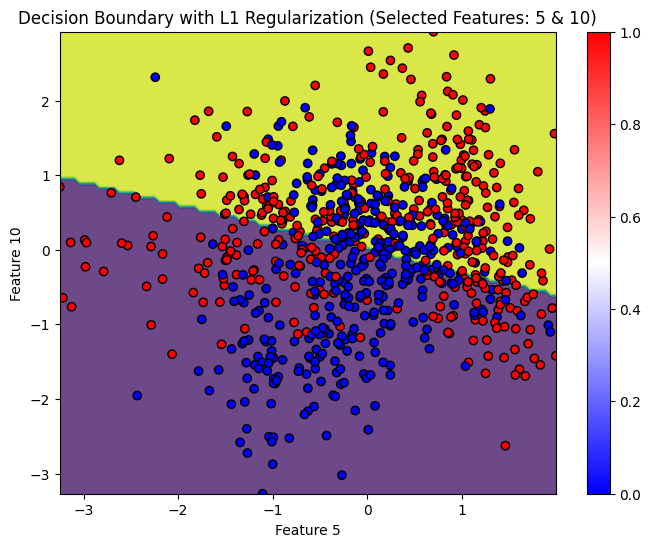

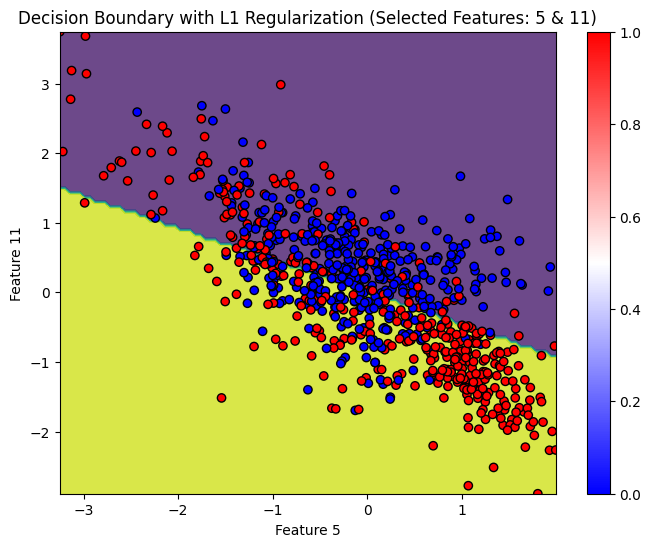

zbieglo po 367 iteracjach


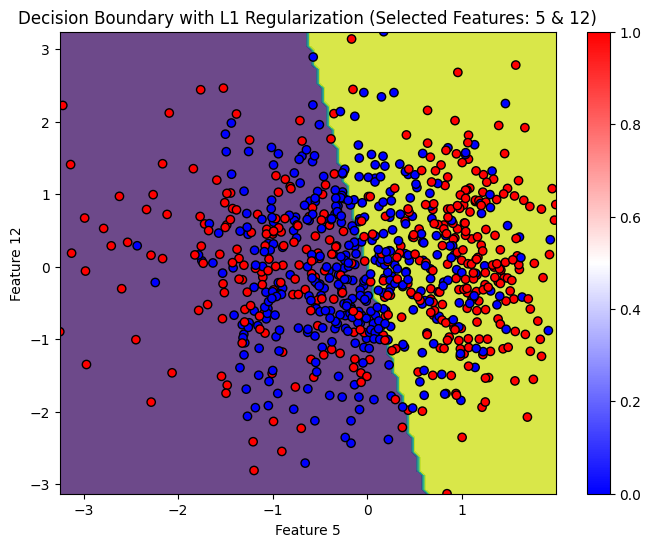

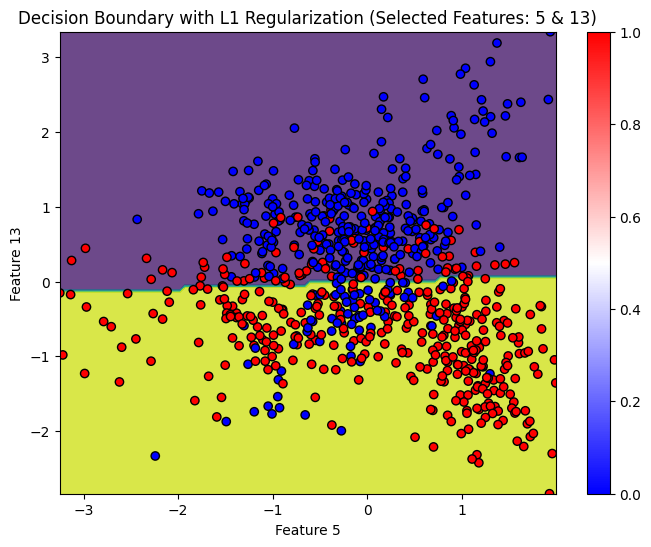

zbieglo po 937 iteracjach


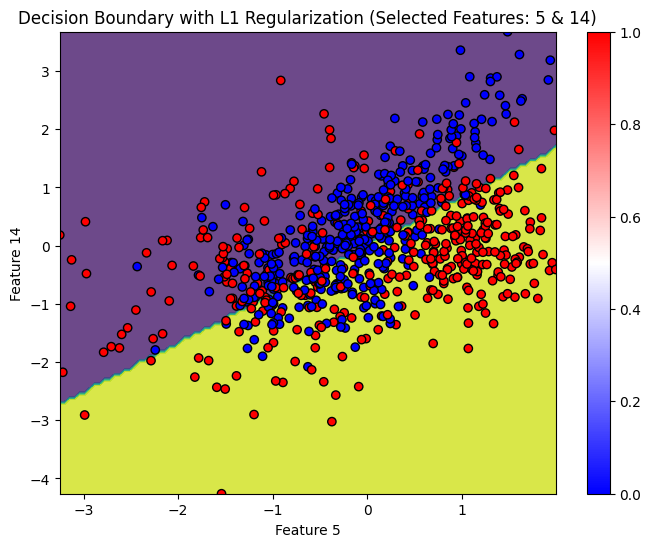

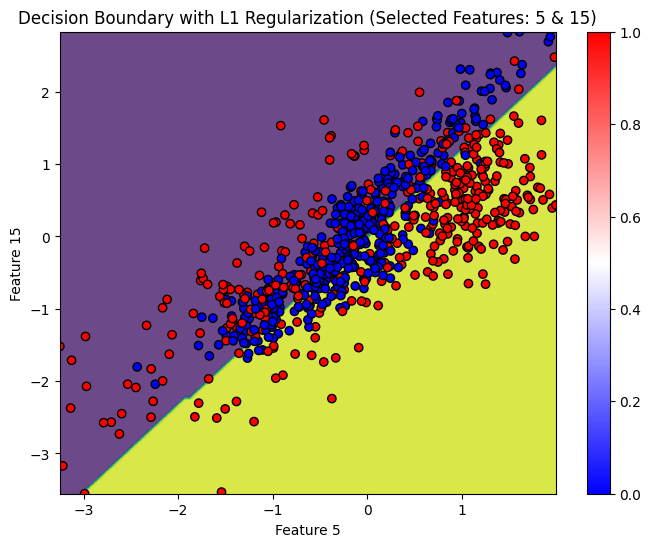

zbieglo po 364 iteracjach


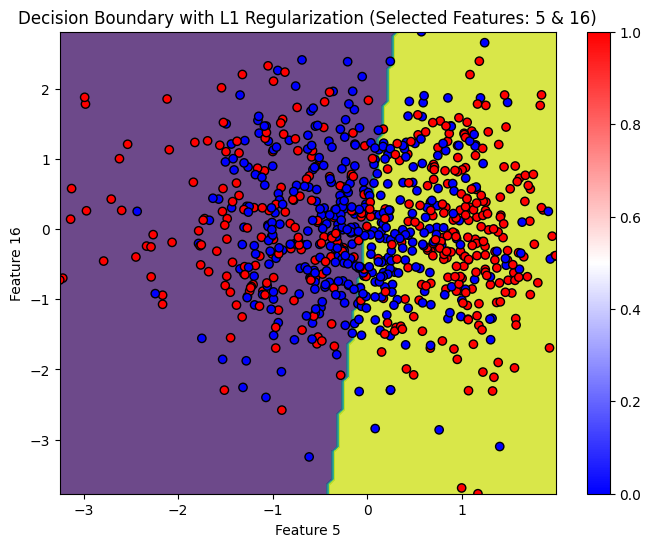

zbieglo po 367 iteracjach


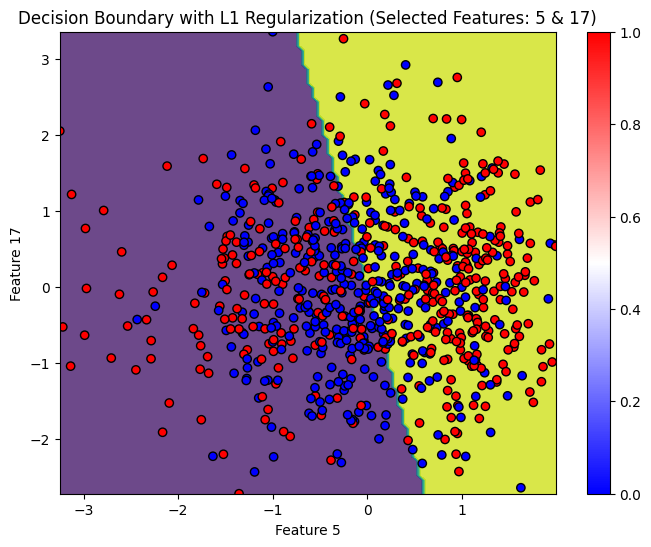

zbieglo po 844 iteracjach


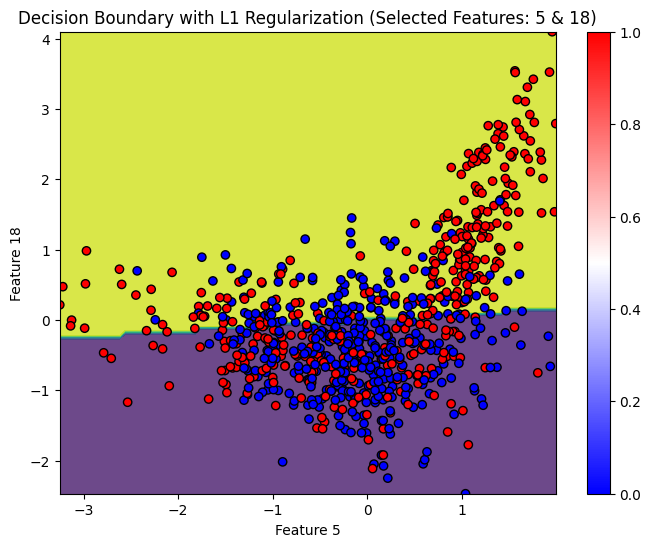

zbieglo po 366 iteracjach


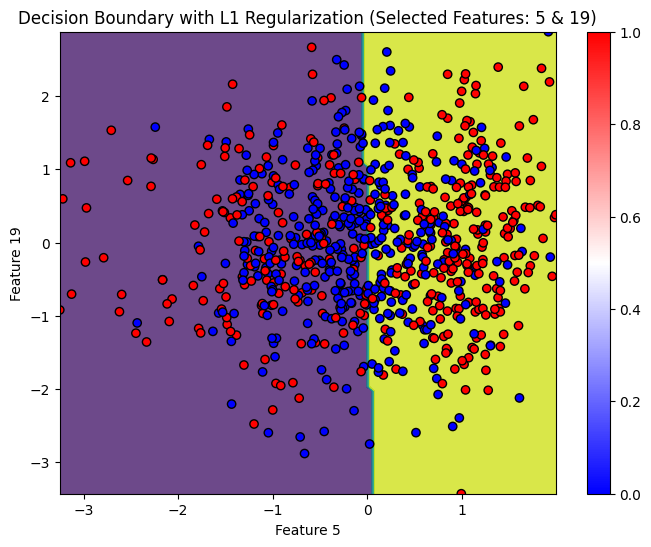

zbieglo po 313 iteracjach


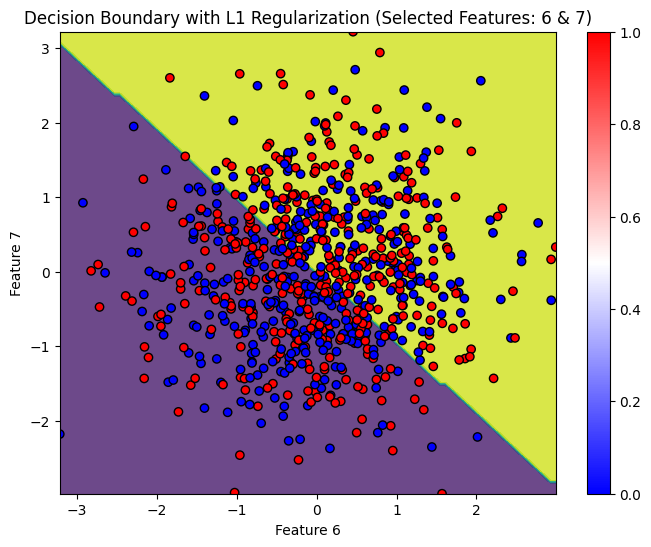

zbieglo po 362 iteracjach


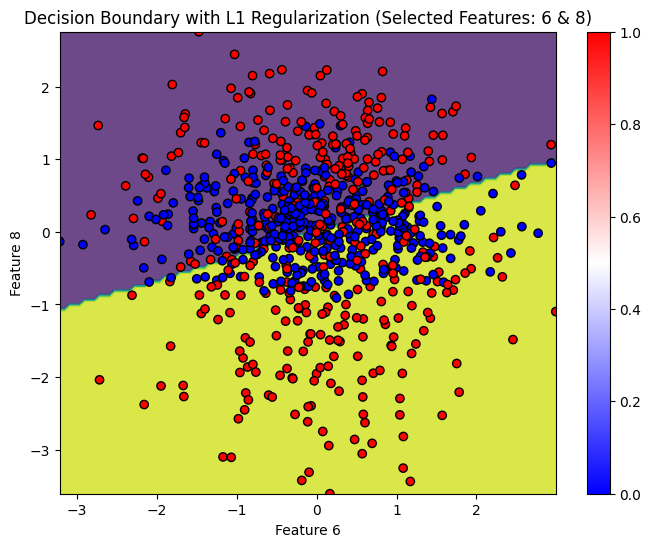

zbieglo po 482 iteracjach


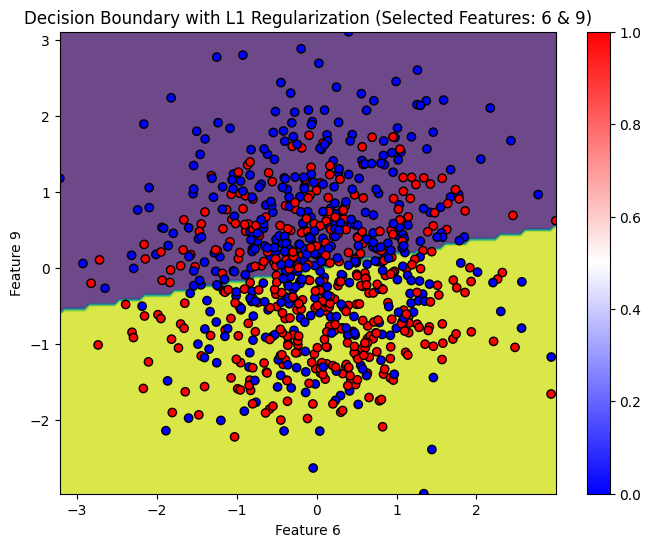

zbieglo po 527 iteracjach


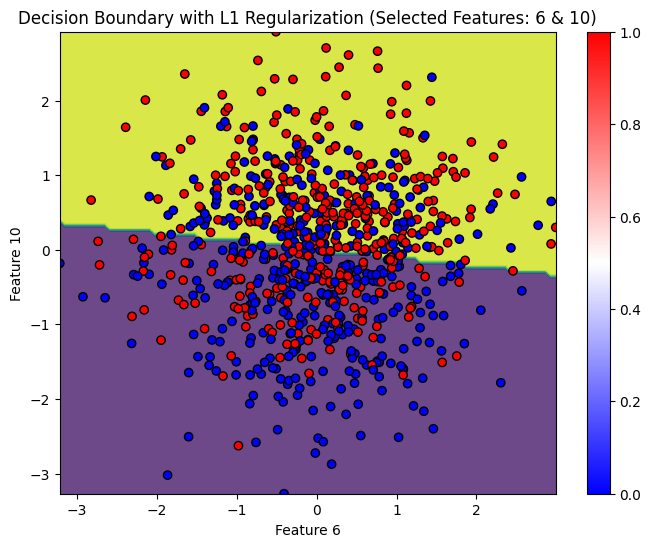

zbieglo po 506 iteracjach


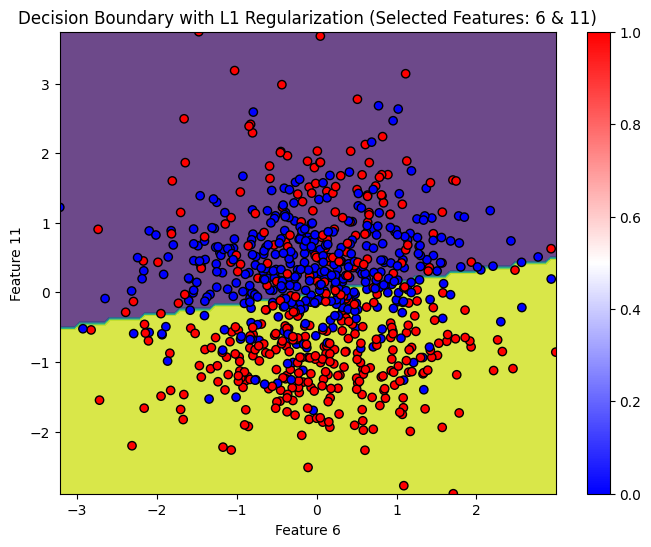

zbieglo po 308 iteracjach


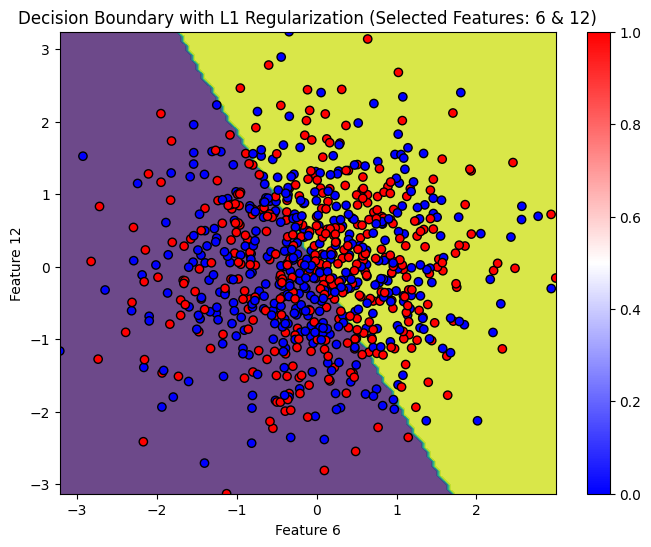

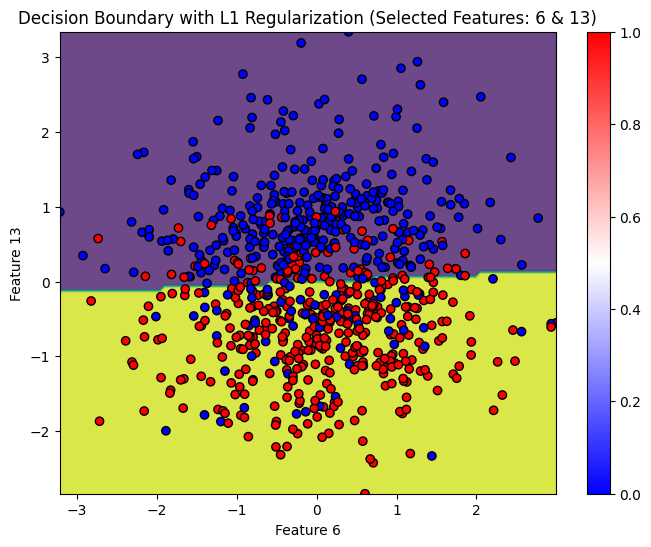

zbieglo po 426 iteracjach


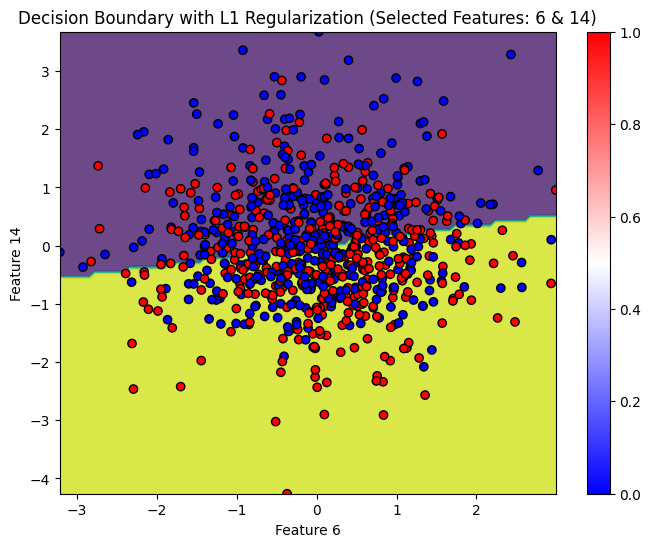

zbieglo po 302 iteracjach


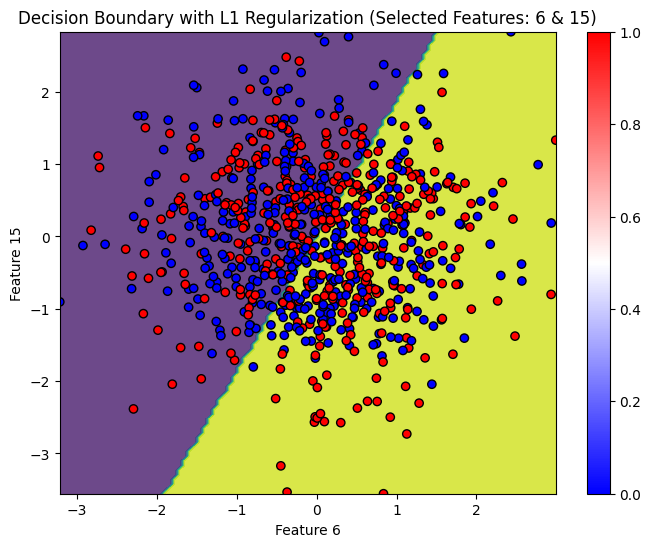

zbieglo po 316 iteracjach


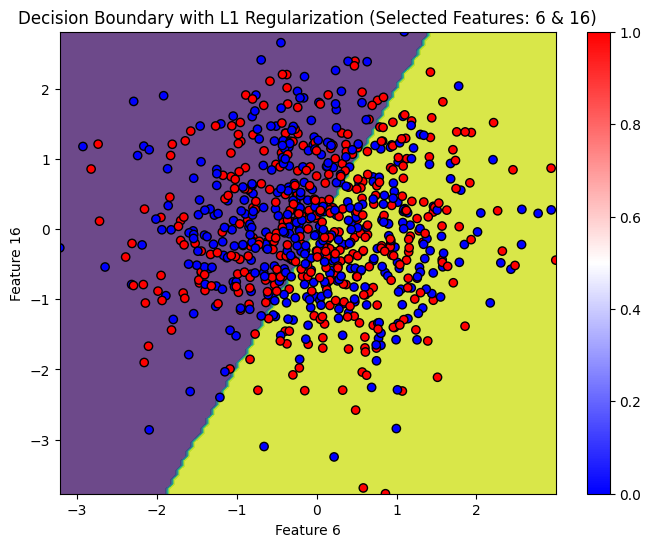

zbieglo po 338 iteracjach


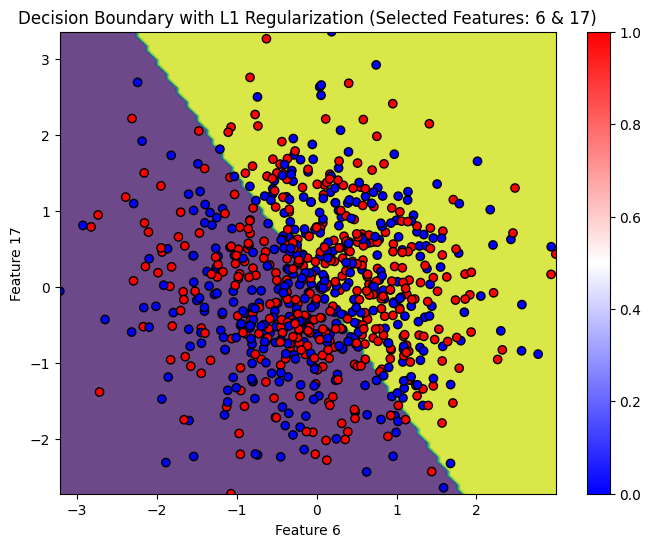

zbieglo po 647 iteracjach


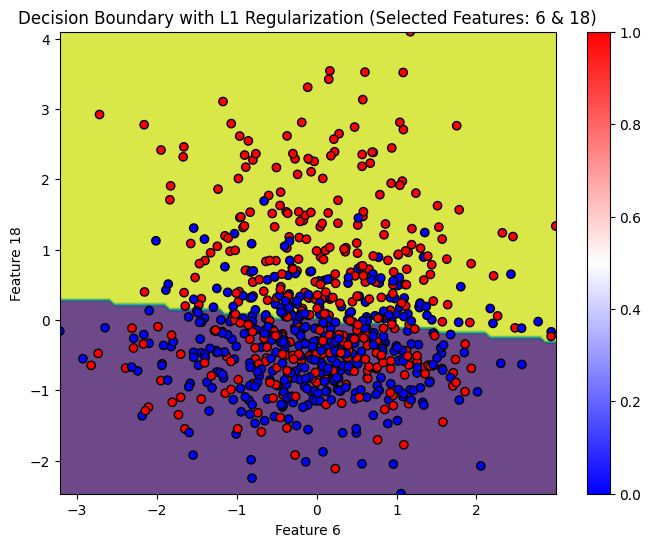

zbieglo po 320 iteracjach


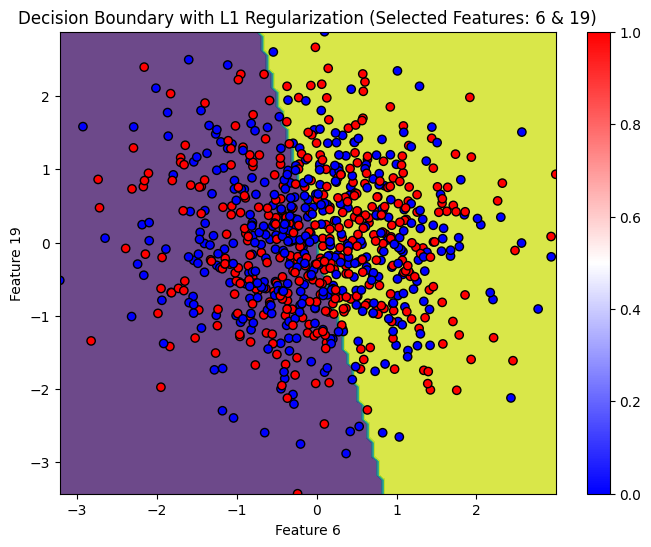

zbieglo po 374 iteracjach


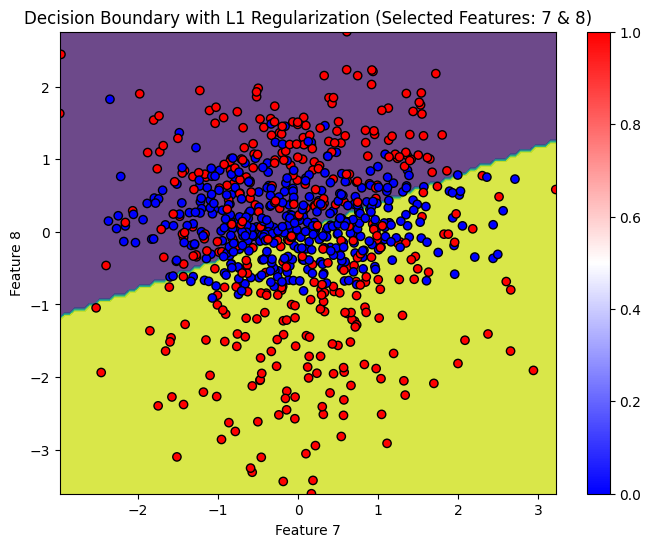

zbieglo po 472 iteracjach


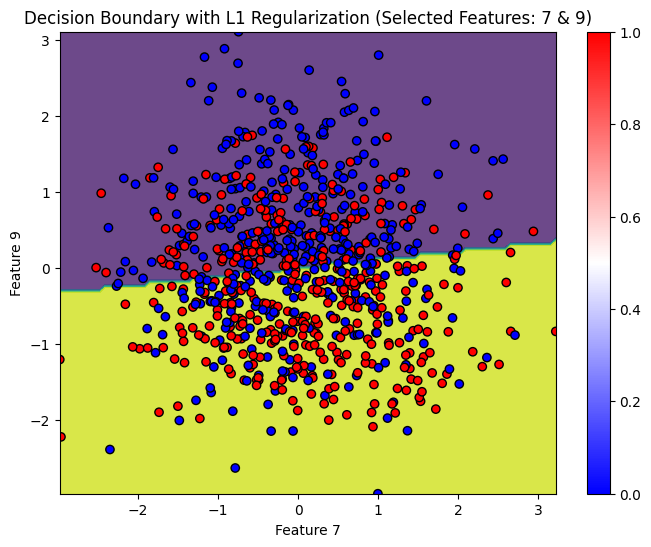

zbieglo po 527 iteracjach


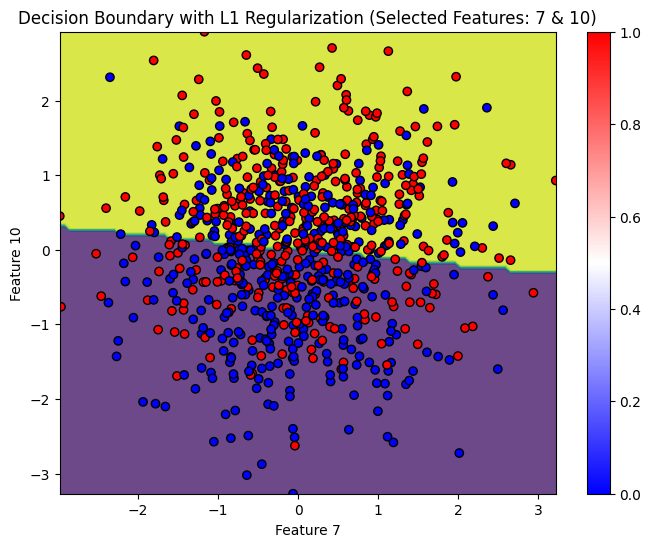

zbieglo po 502 iteracjach


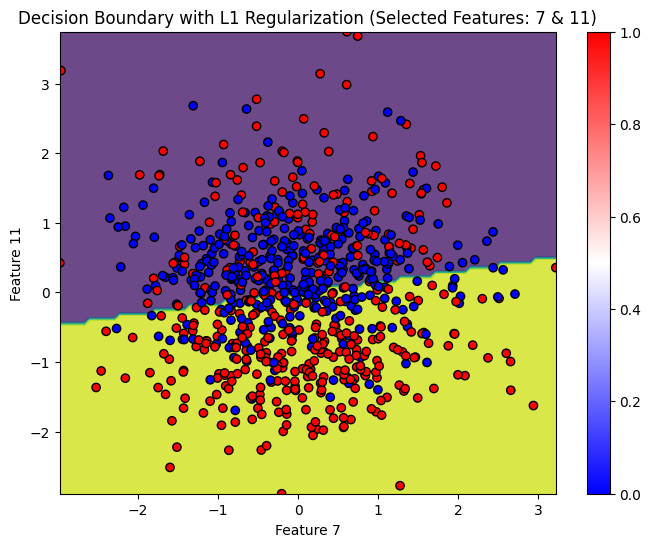

zbieglo po 323 iteracjach


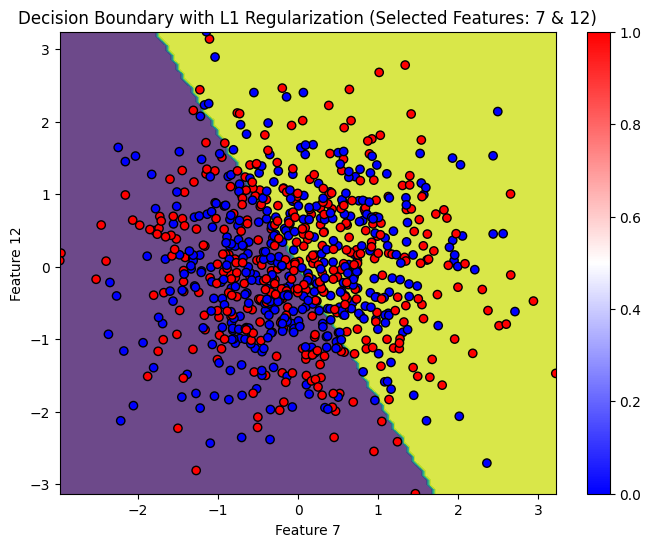

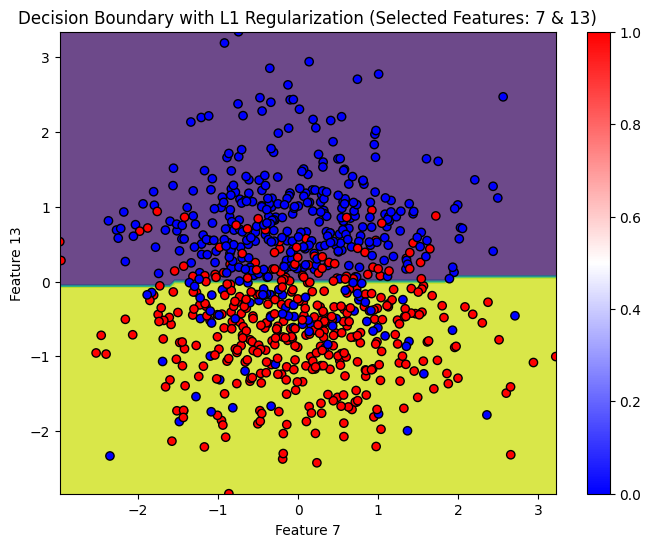

zbieglo po 429 iteracjach


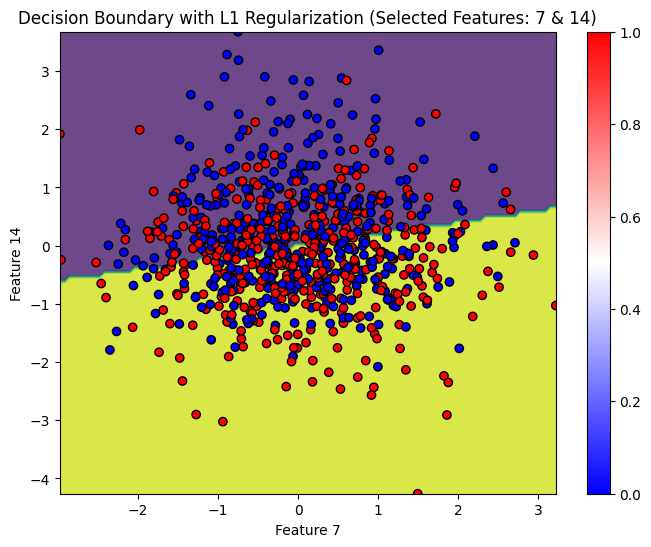

zbieglo po 310 iteracjach


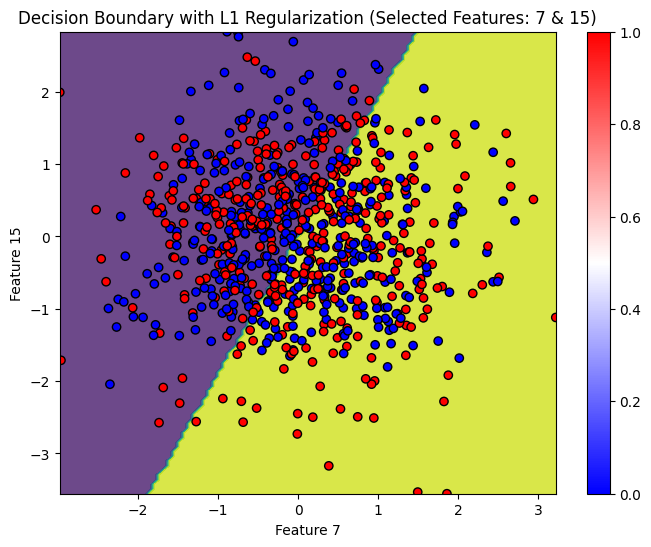

zbieglo po 310 iteracjach


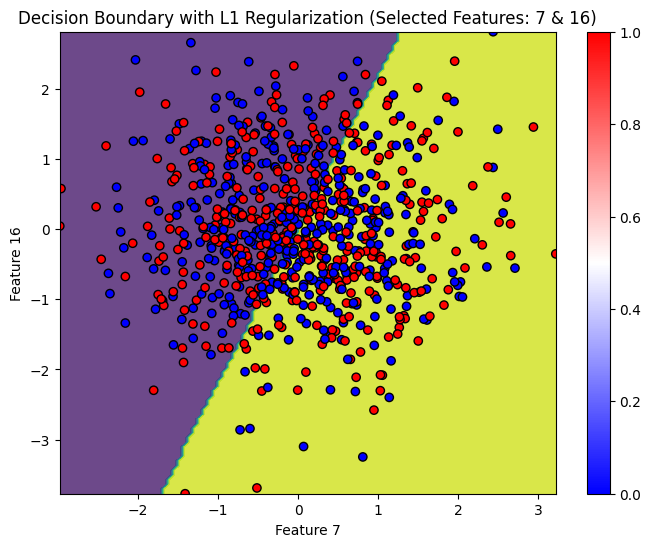

zbieglo po 313 iteracjach


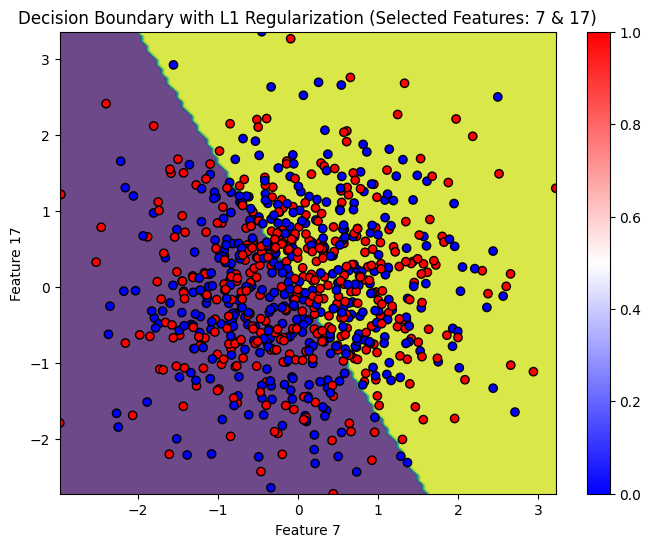

zbieglo po 650 iteracjach


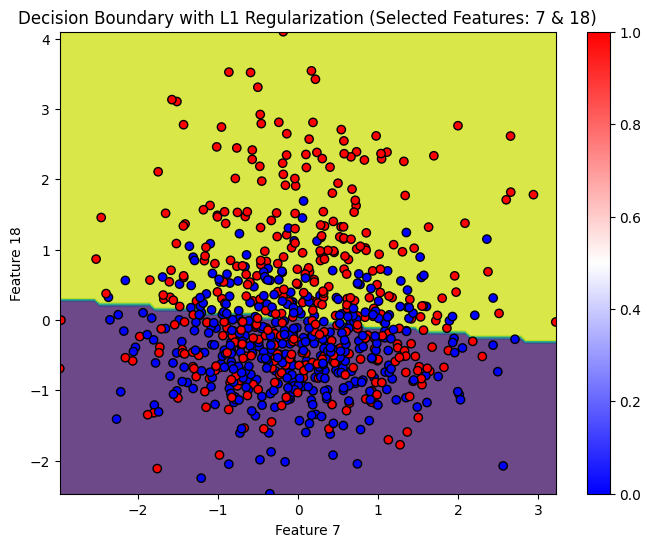

zbieglo po 308 iteracjach


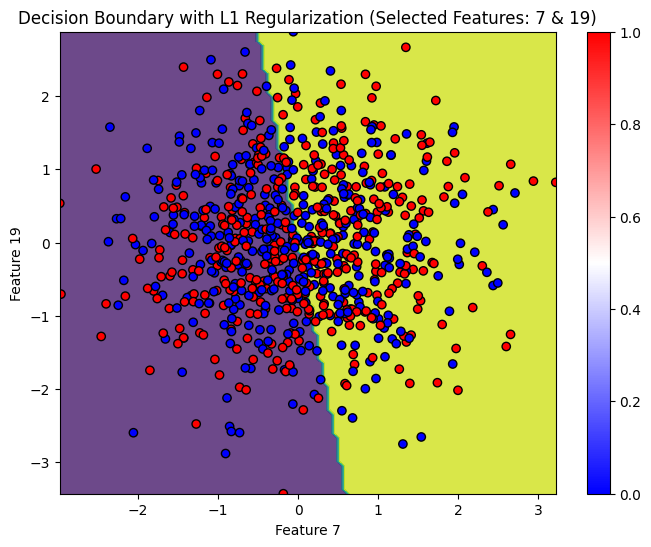

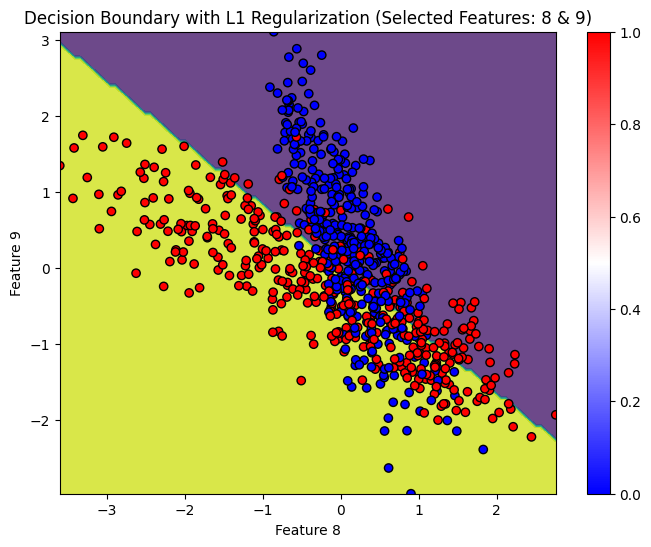

zbieglo po 787 iteracjach


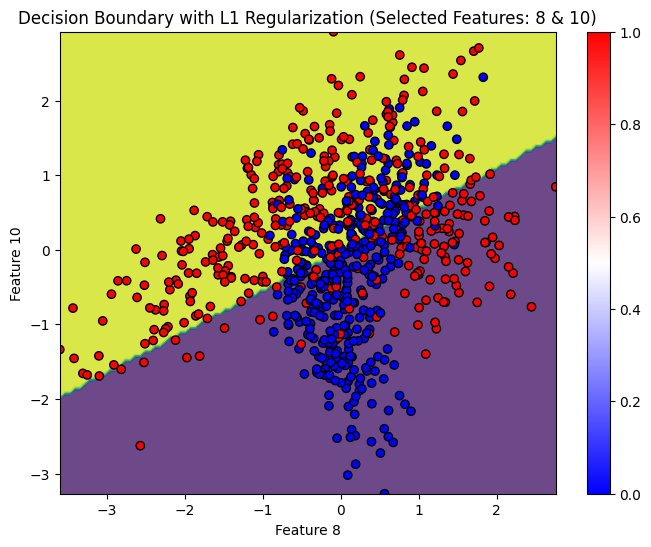

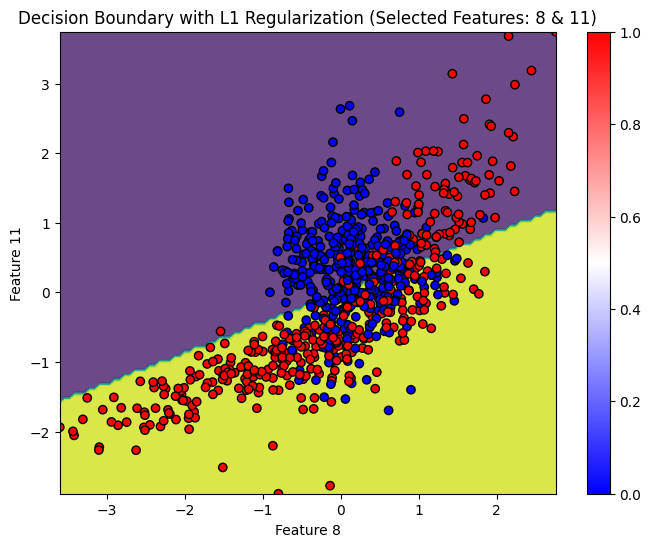

zbieglo po 367 iteracjach


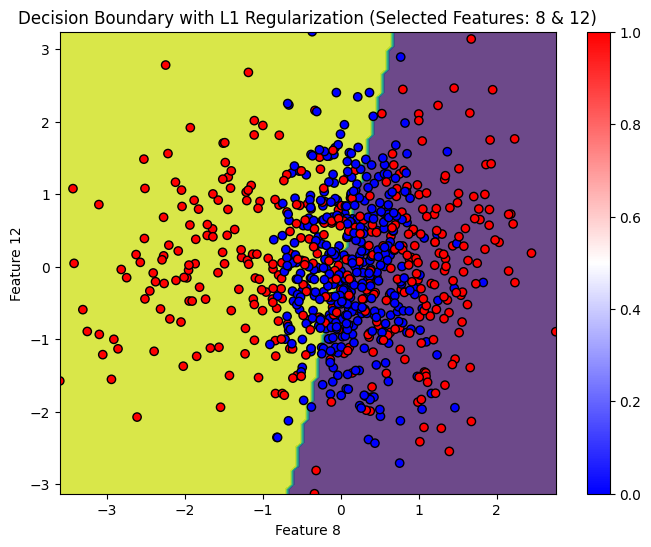

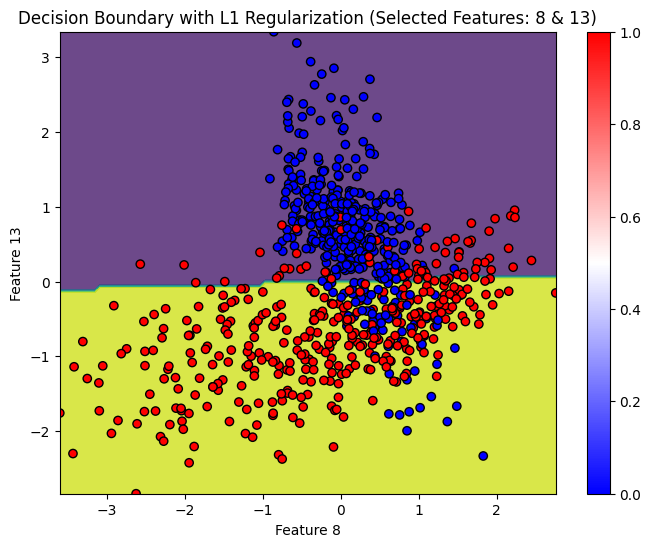

zbieglo po 429 iteracjach


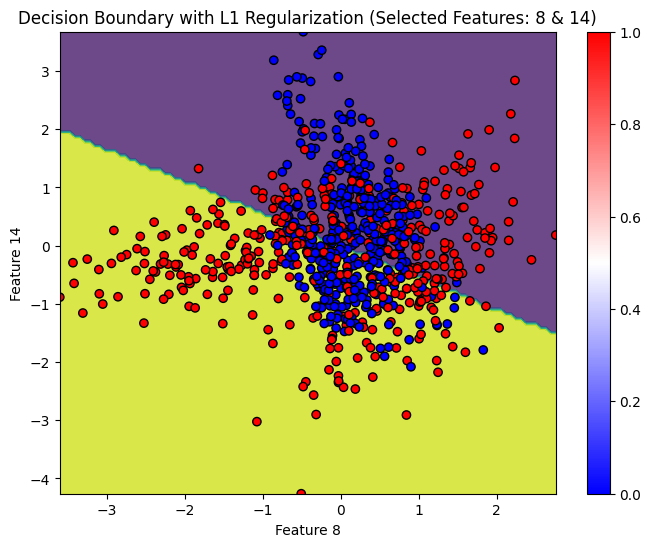

zbieglo po 455 iteracjach


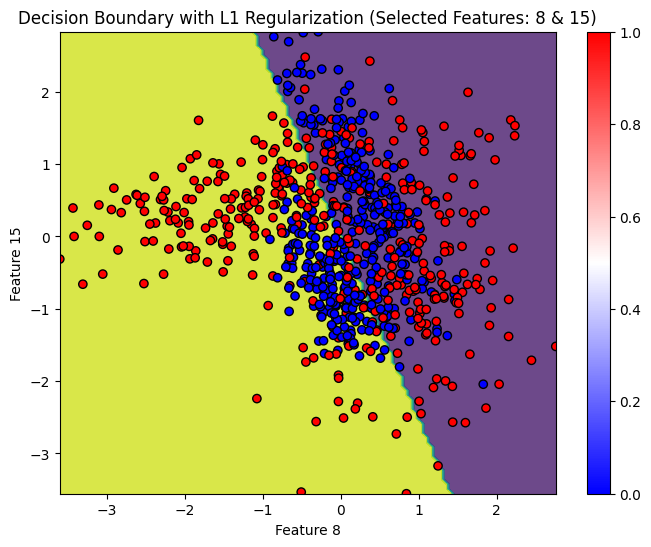

zbieglo po 367 iteracjach


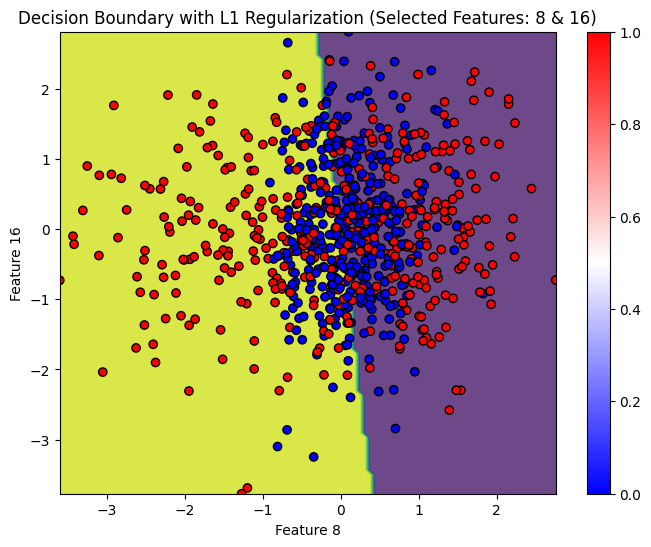

zbieglo po 363 iteracjach


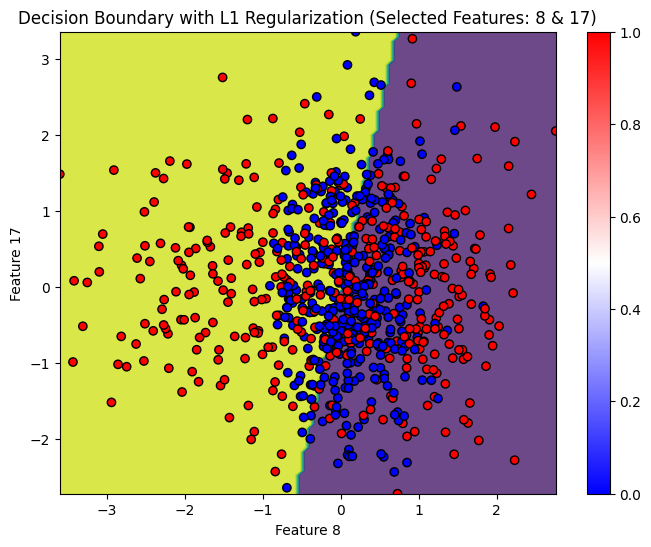

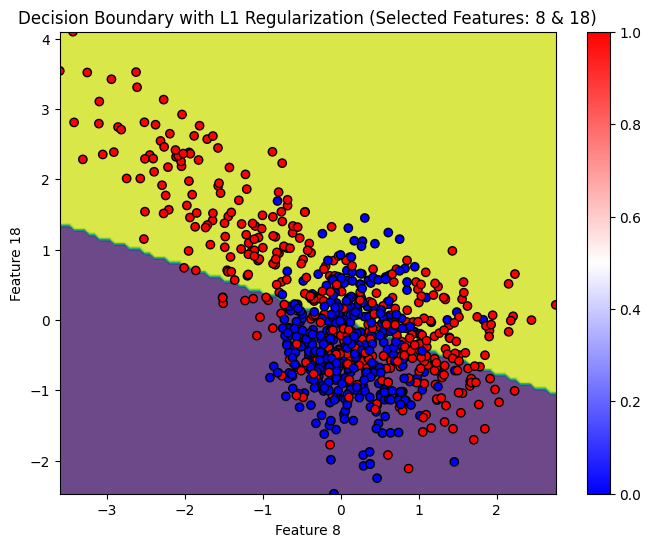

zbieglo po 368 iteracjach


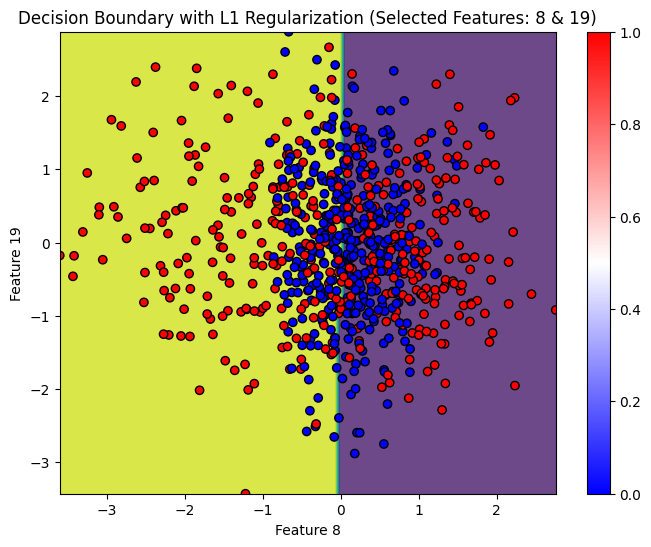

zbieglo po 532 iteracjach


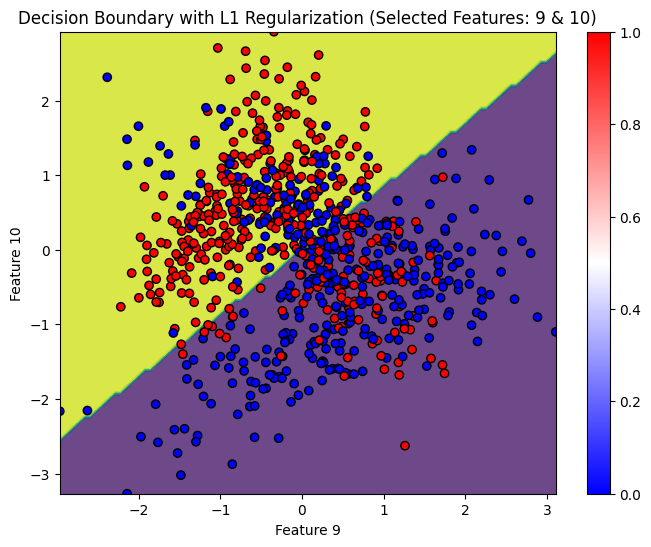

zbieglo po 917 iteracjach


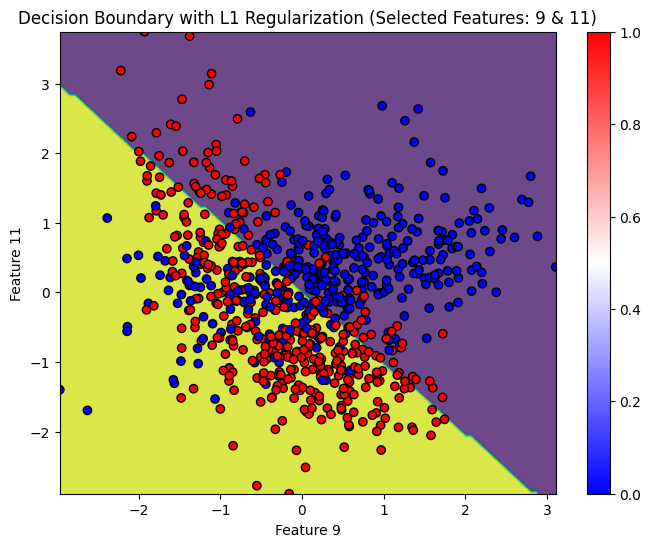

zbieglo po 474 iteracjach


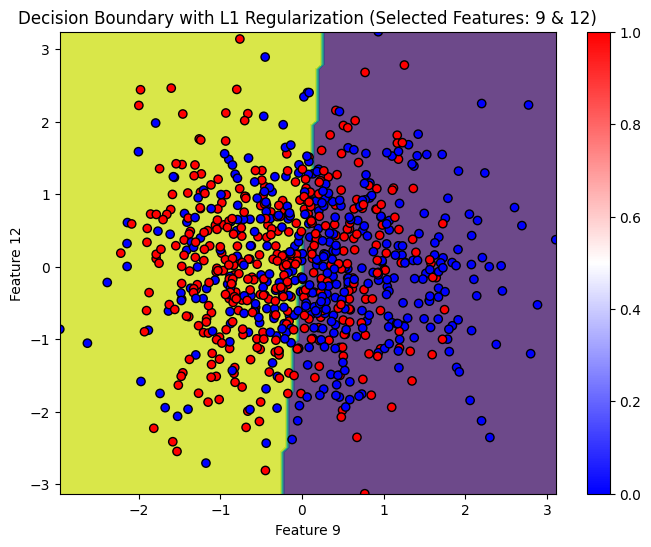

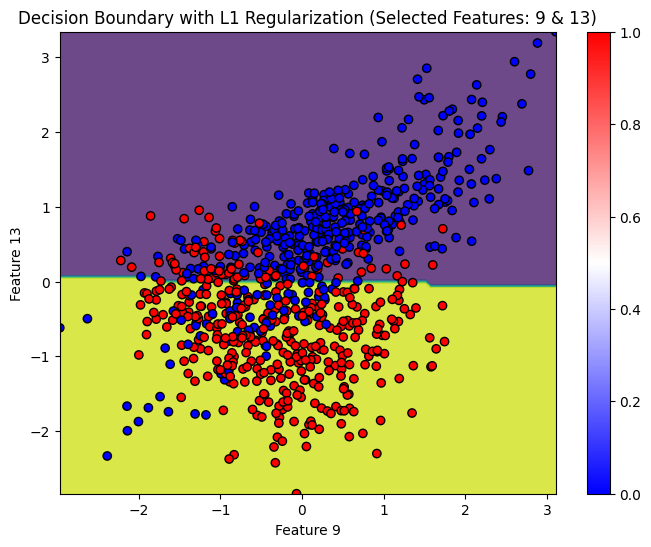

zbieglo po 628 iteracjach


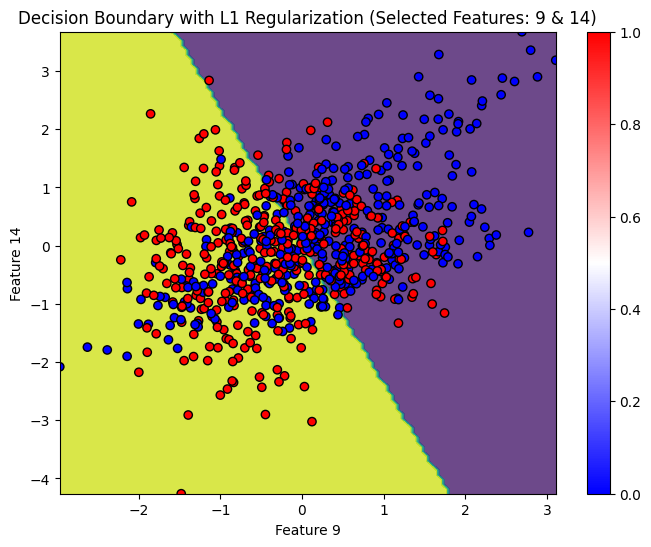

zbieglo po 762 iteracjach


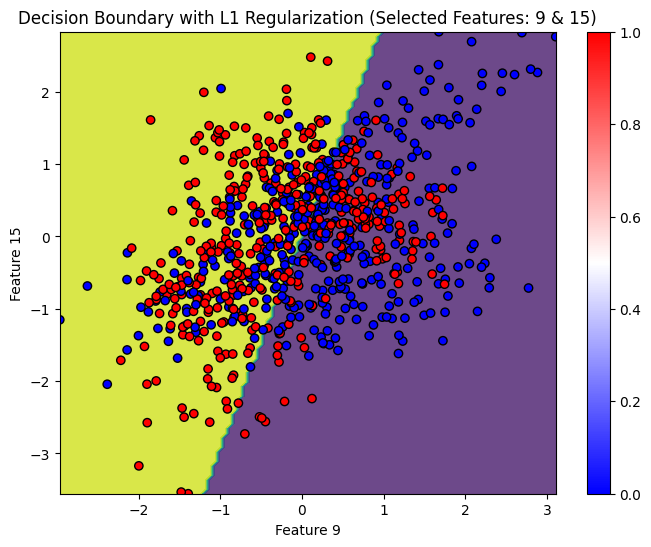

zbieglo po 474 iteracjach


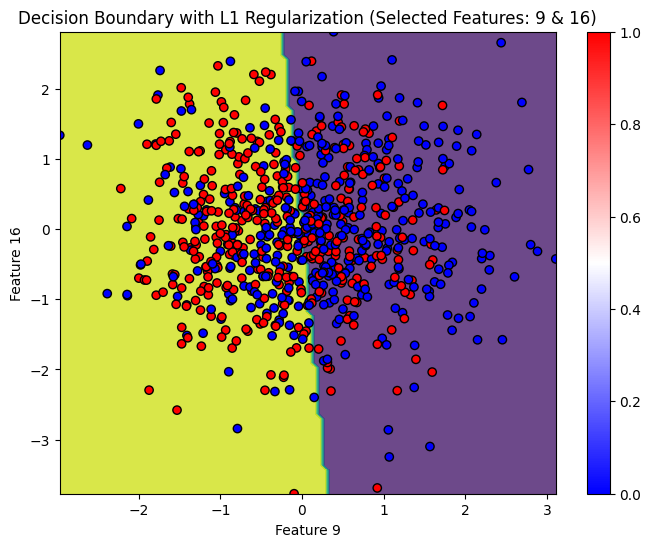

zbieglo po 473 iteracjach


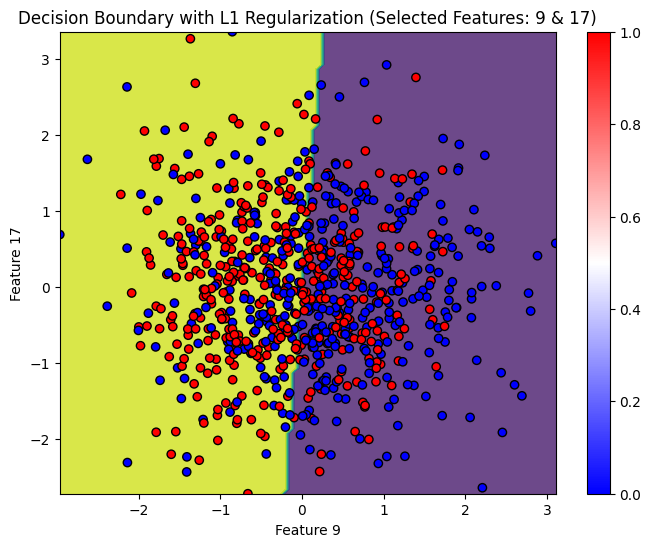

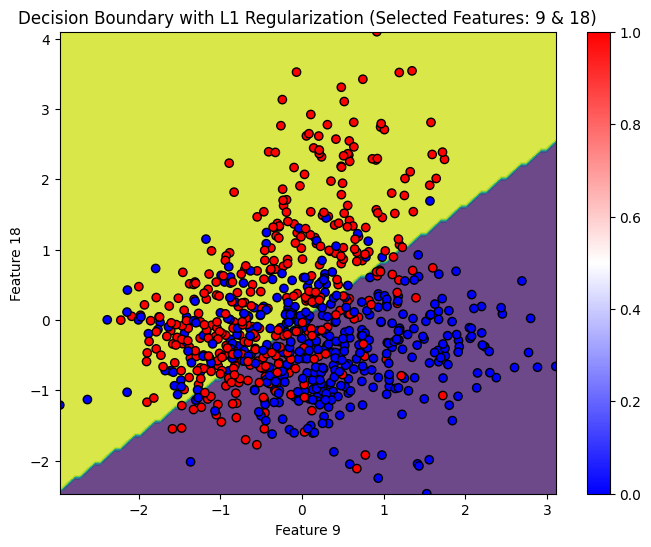

zbieglo po 472 iteracjach


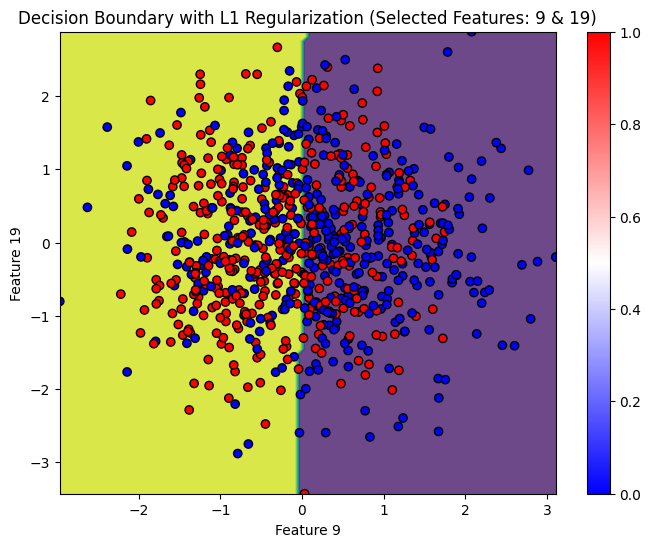

zbieglo po 789 iteracjach


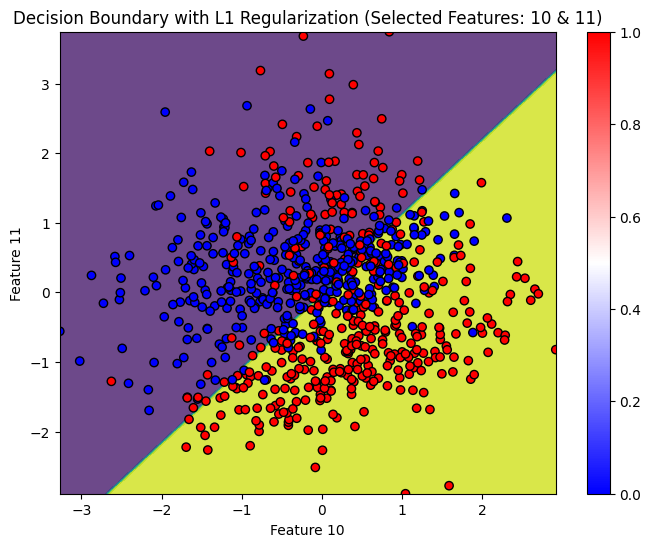

zbieglo po 528 iteracjach


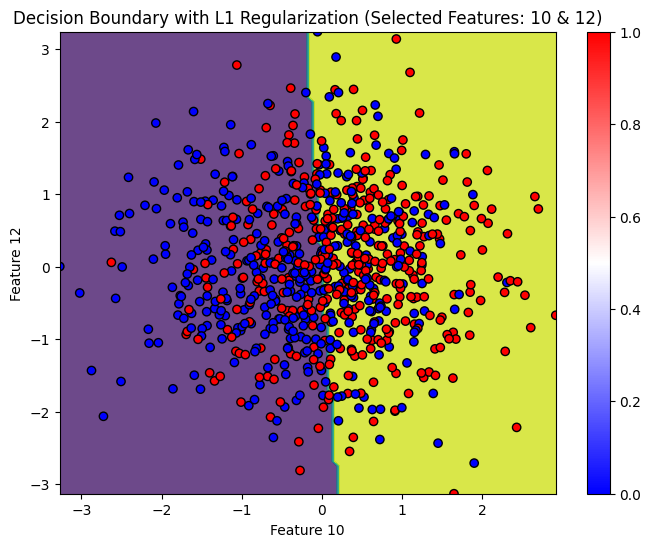

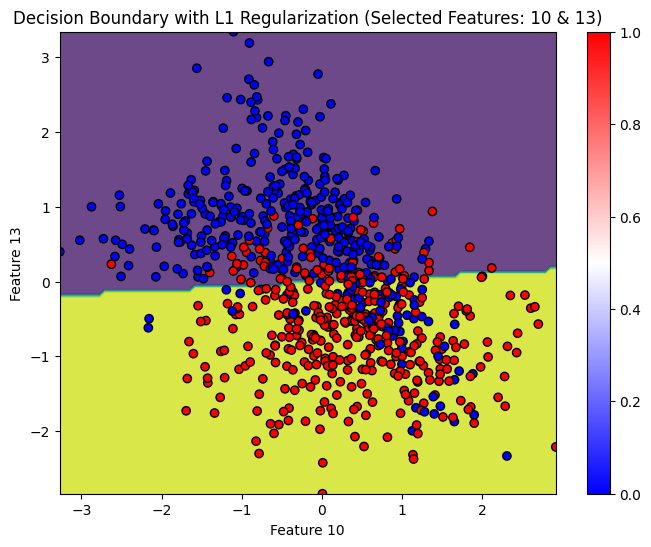

zbieglo po 950 iteracjach


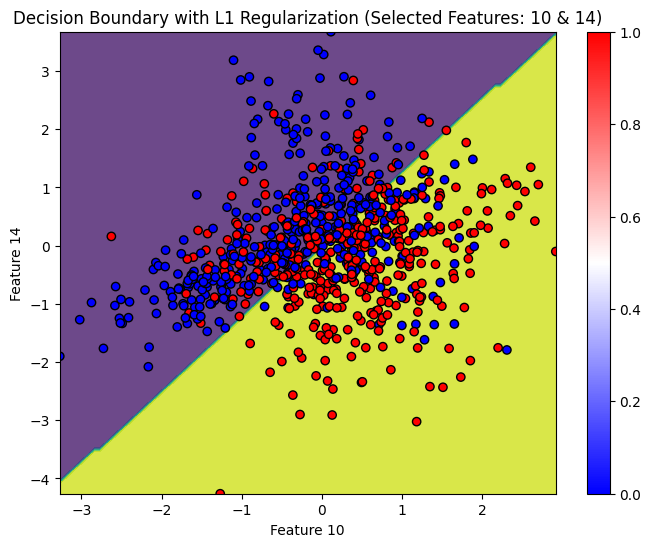

zbieglo po 681 iteracjach


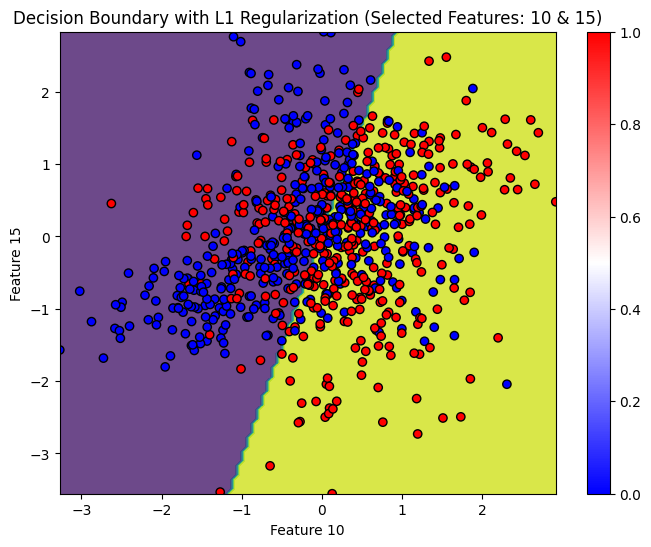

zbieglo po 531 iteracjach


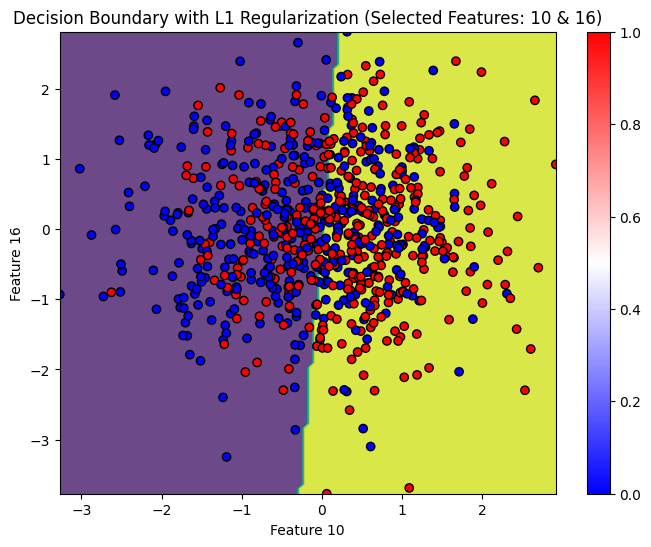

zbieglo po 539 iteracjach


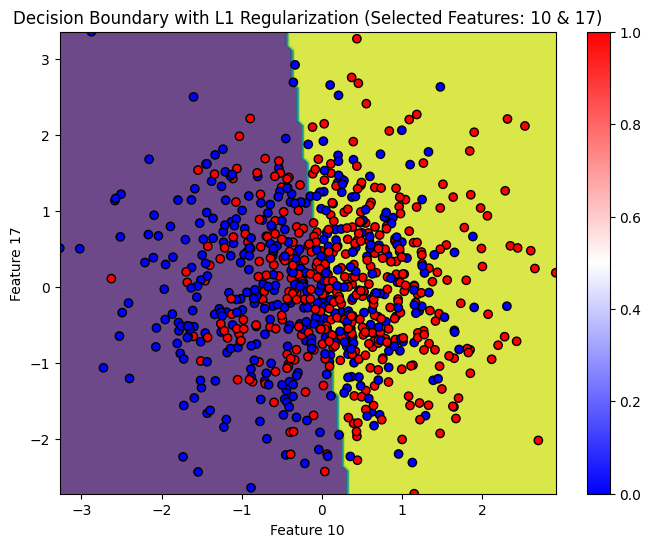

zbieglo po 739 iteracjach


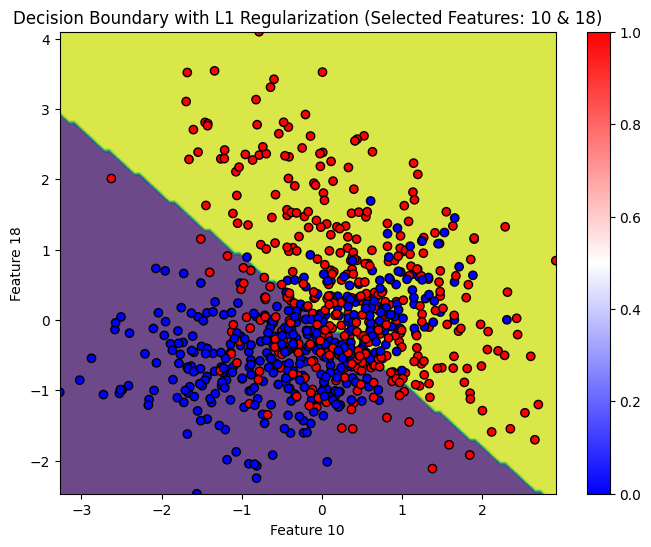

zbieglo po 529 iteracjach


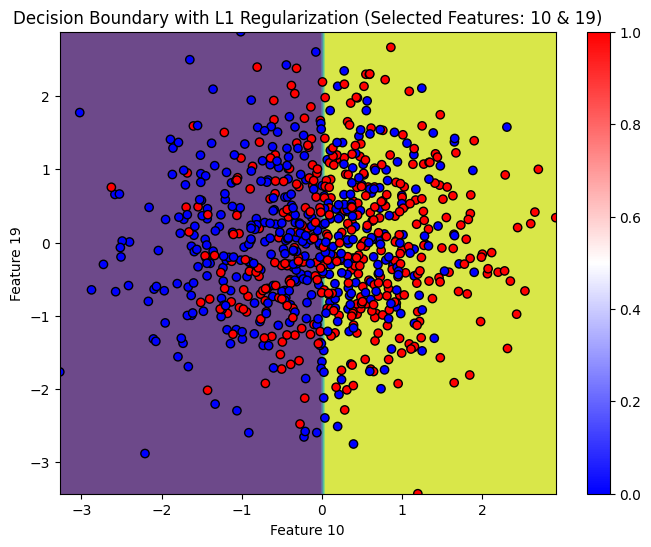

zbieglo po 507 iteracjach


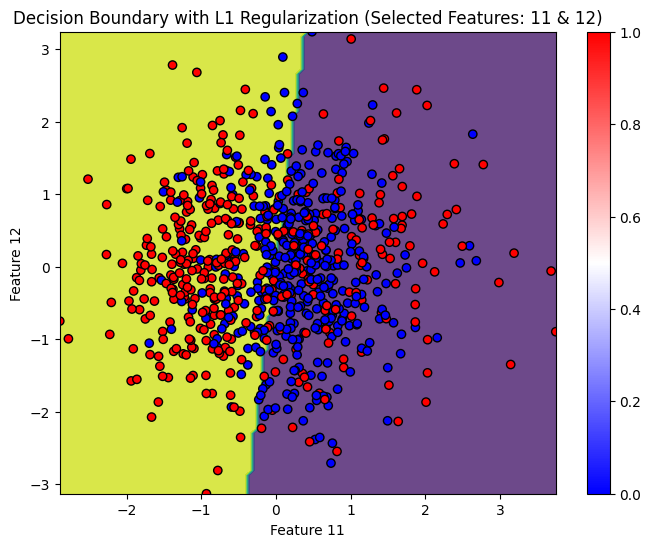

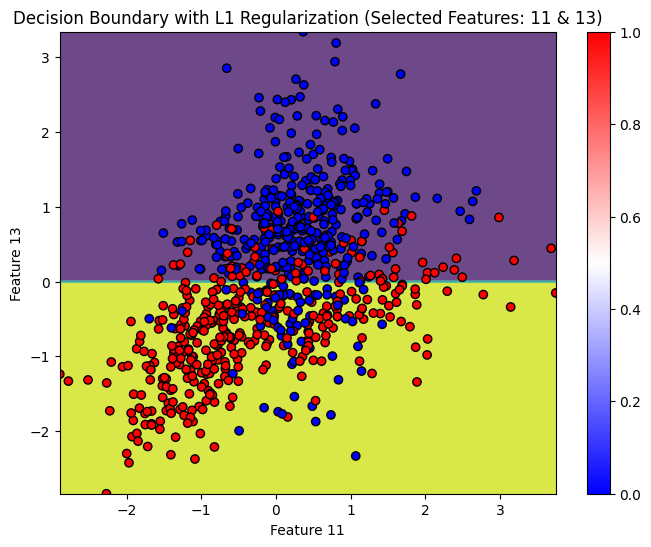

zbieglo po 514 iteracjach


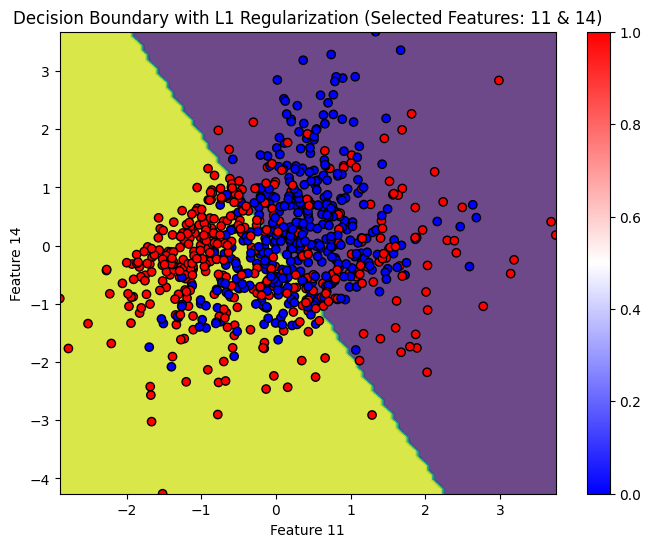

zbieglo po 627 iteracjach


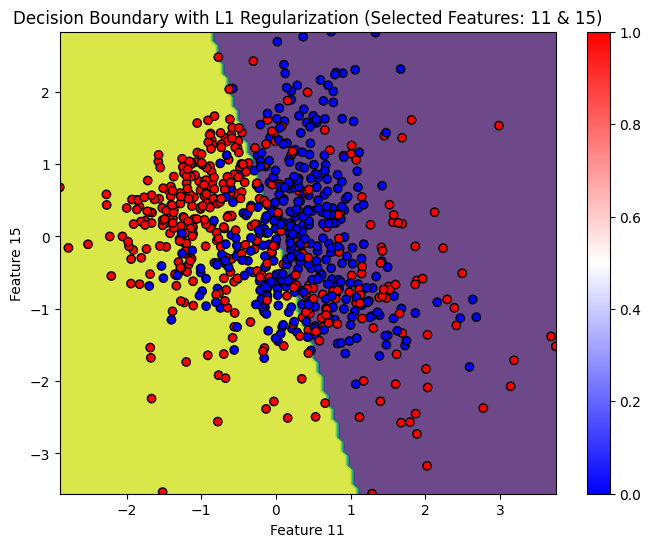

zbieglo po 508 iteracjach


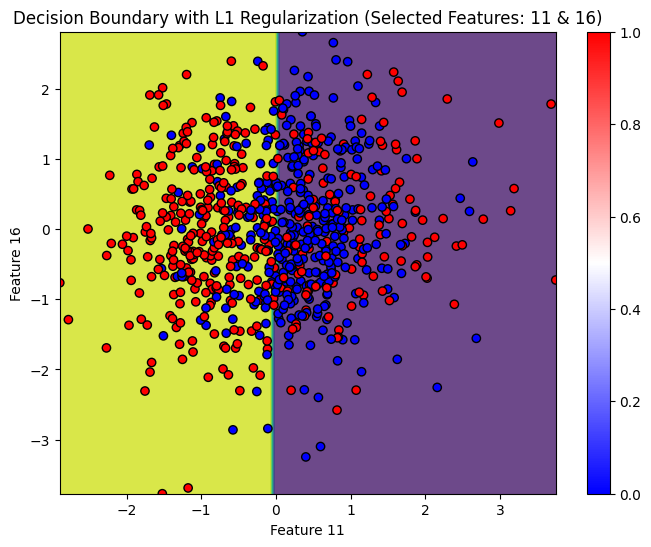

zbieglo po 498 iteracjach


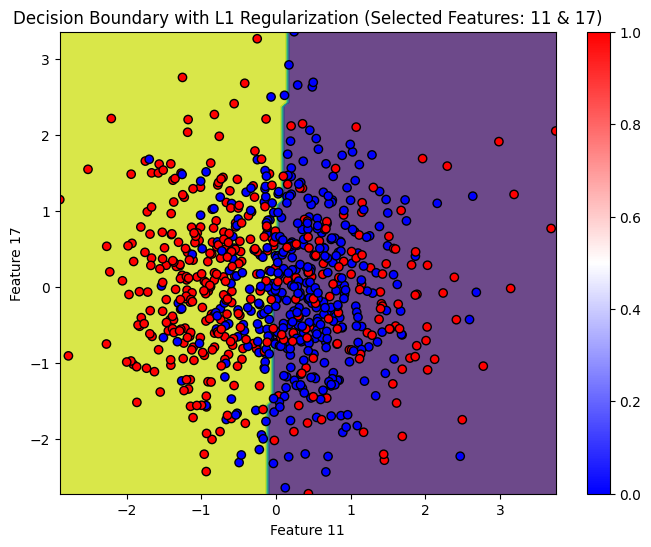

zbieglo po 714 iteracjach


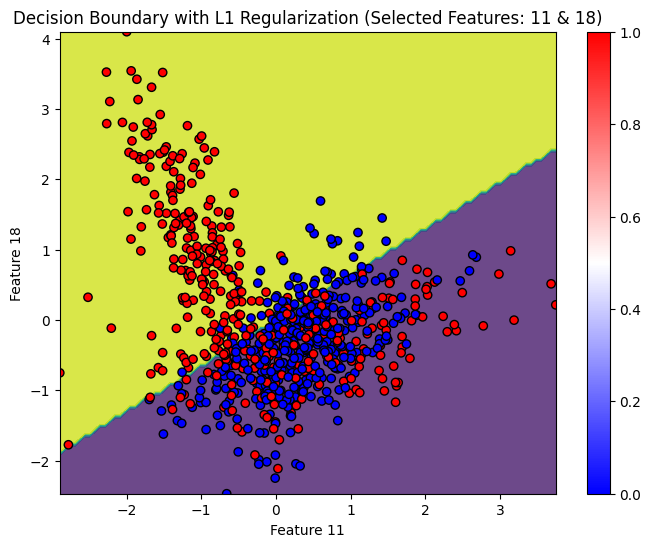

zbieglo po 506 iteracjach


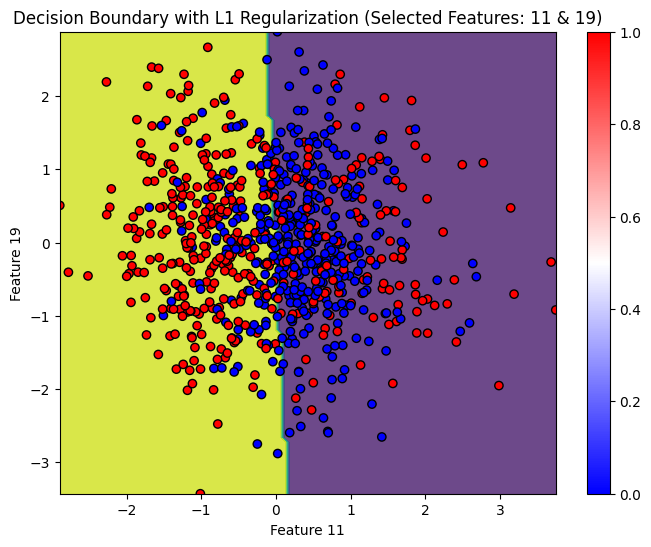

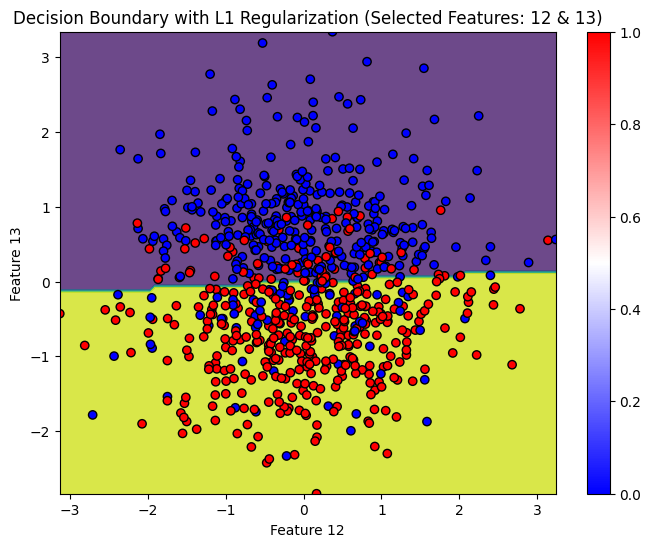

zbieglo po 431 iteracjach


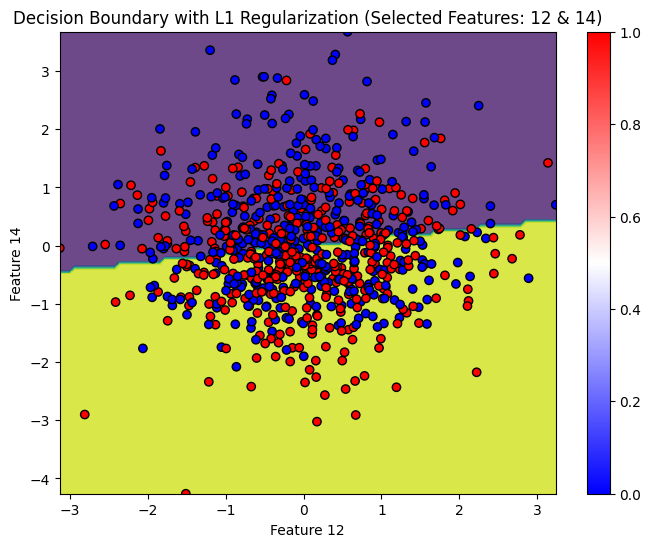

zbieglo po 297 iteracjach


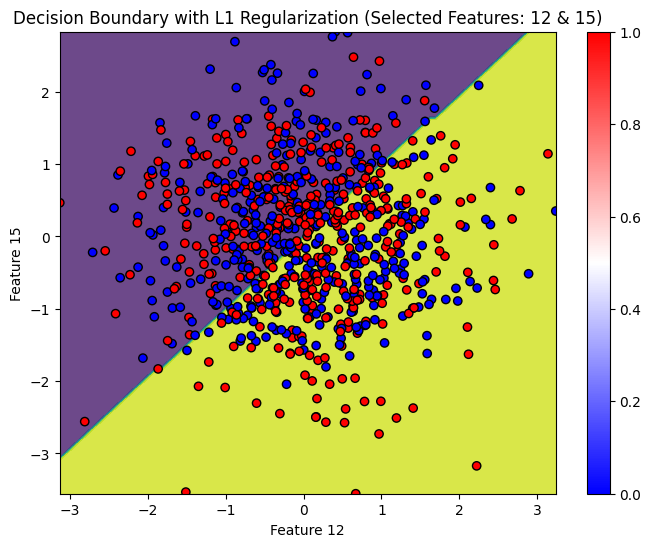

zbieglo po 300 iteracjach


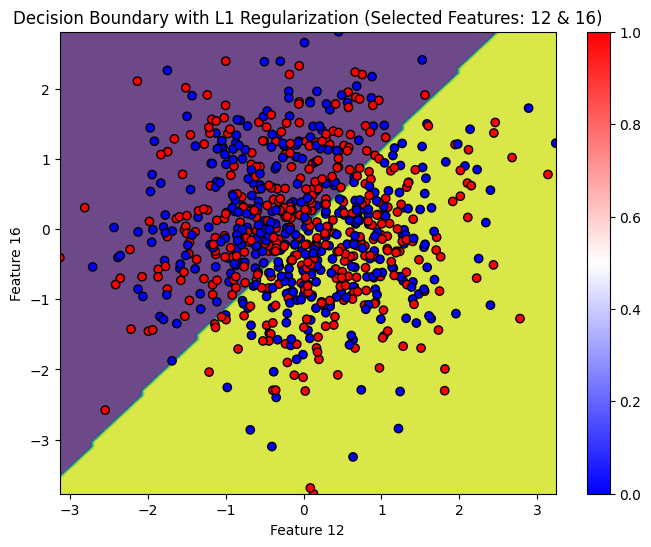

zbieglo po 304 iteracjach


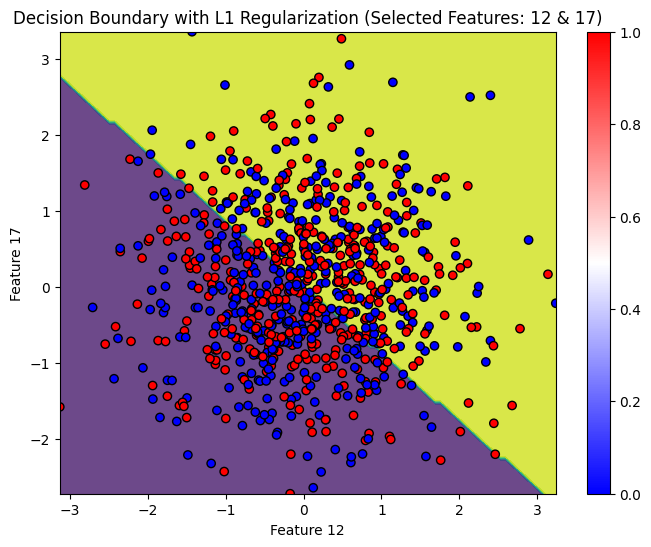

zbieglo po 647 iteracjach


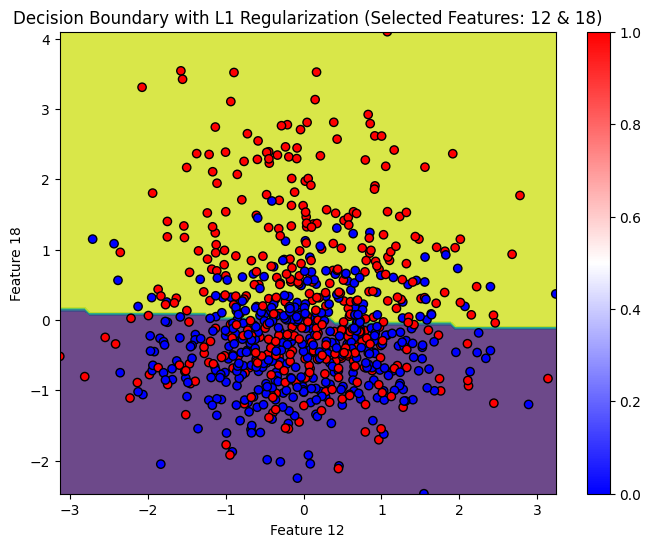

zbieglo po 286 iteracjach


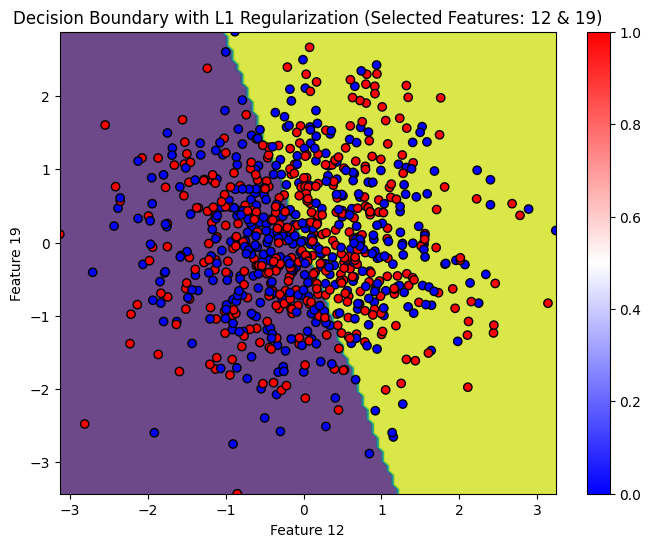

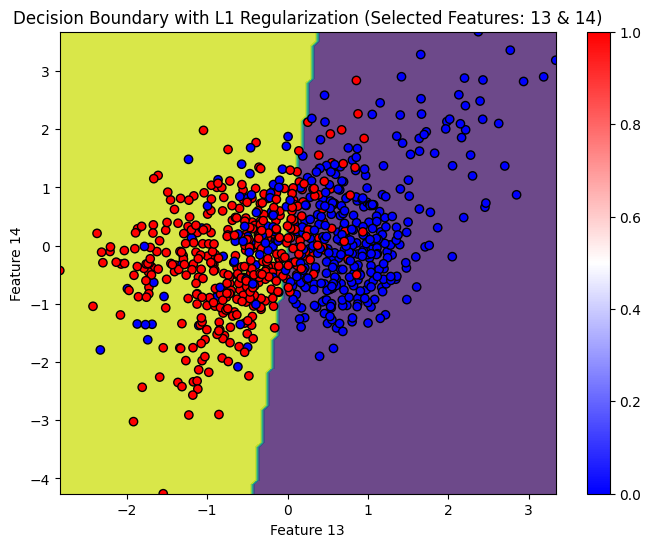

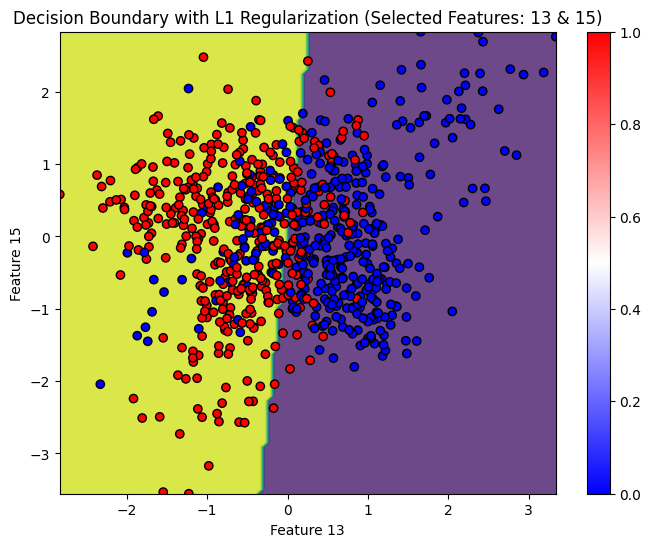

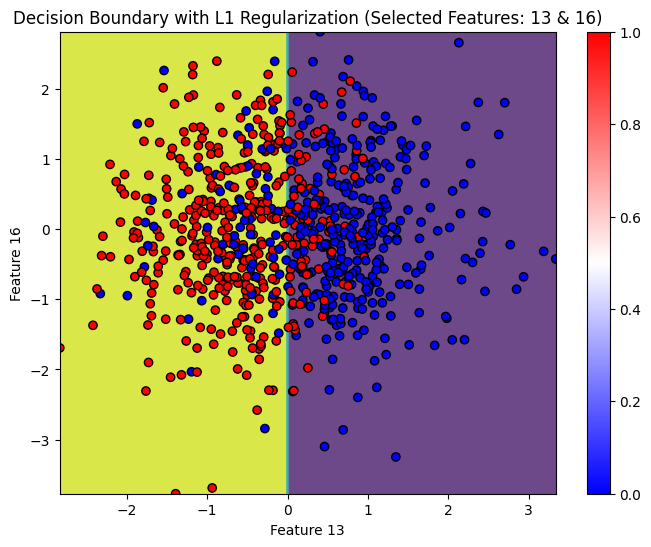

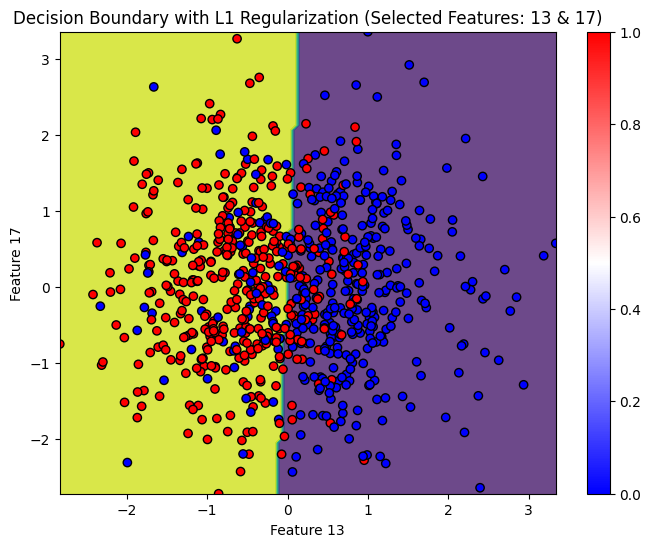

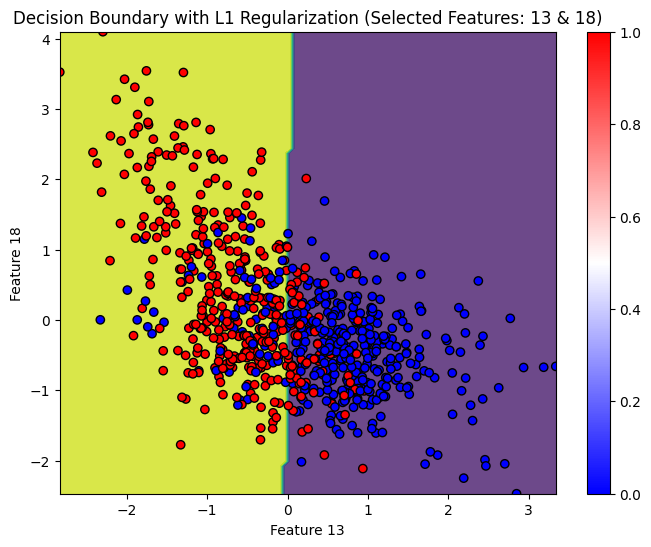

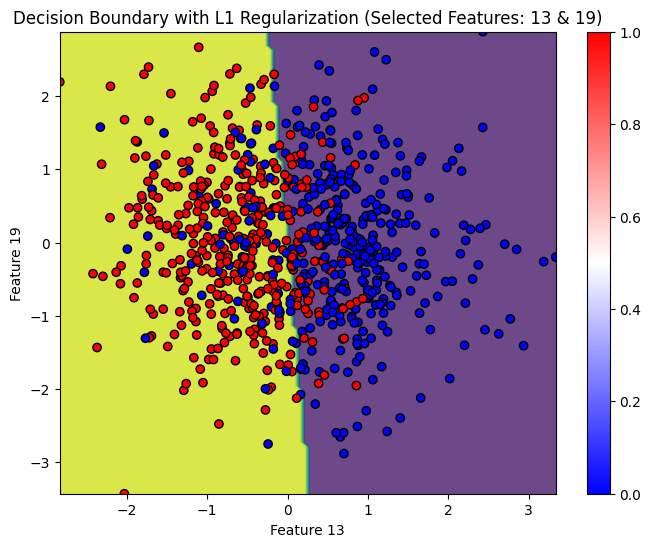

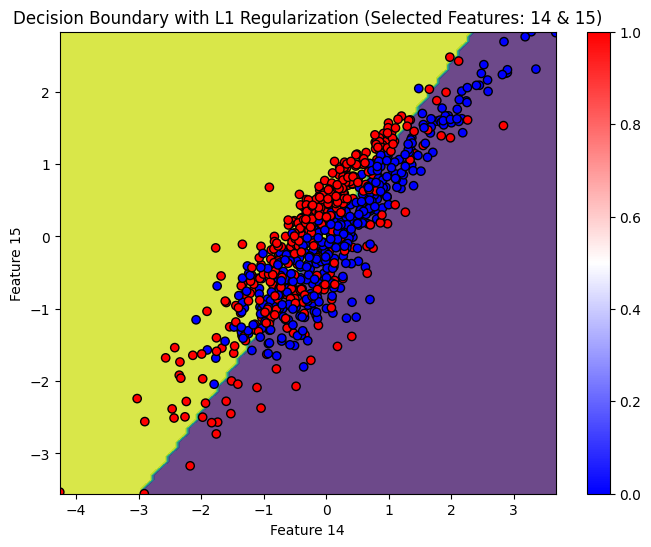

zbieglo po 429 iteracjach


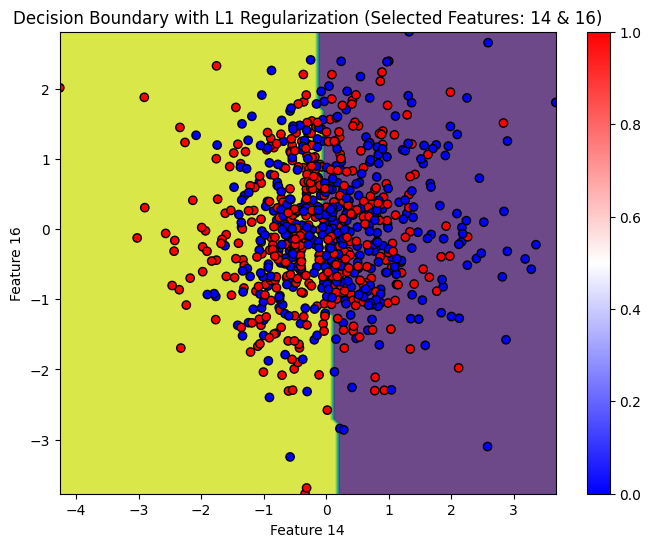

zbieglo po 431 iteracjach


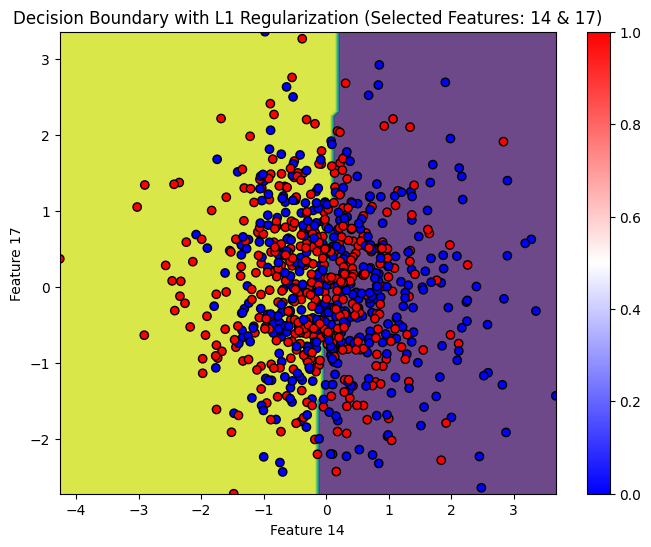

zbieglo po 995 iteracjach


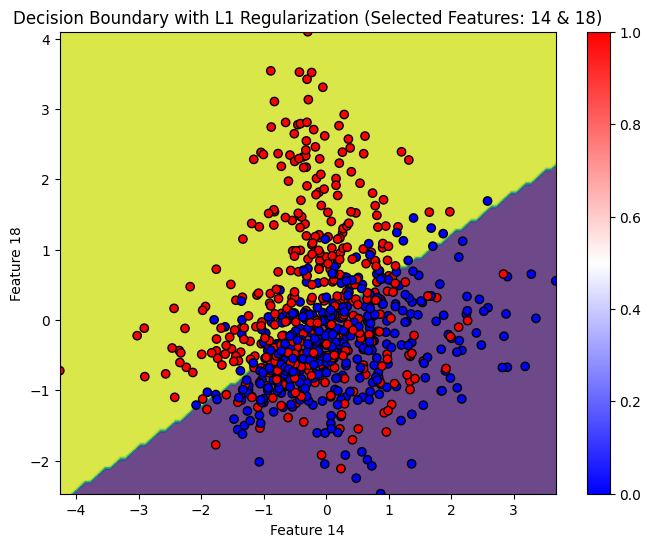

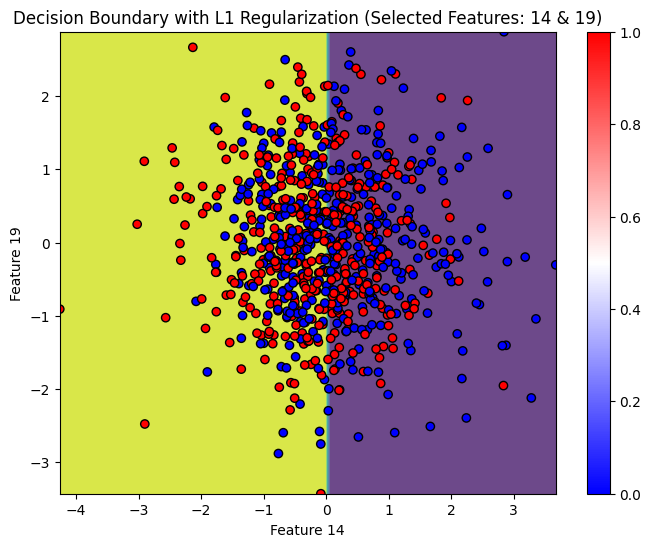

zbieglo po 293 iteracjach


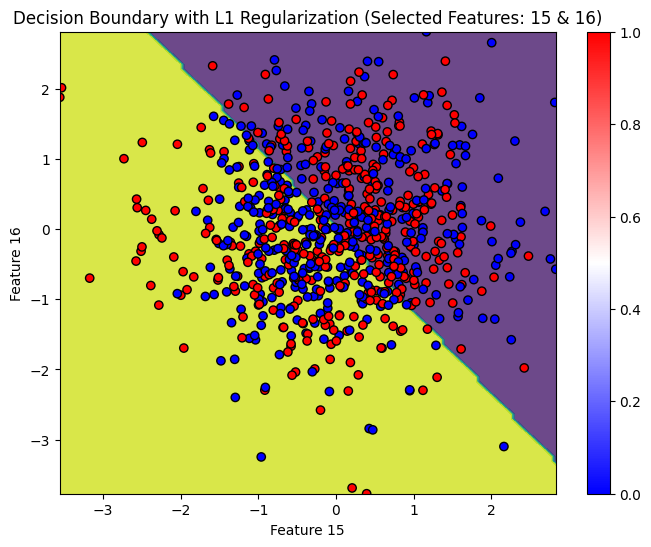

zbieglo po 284 iteracjach


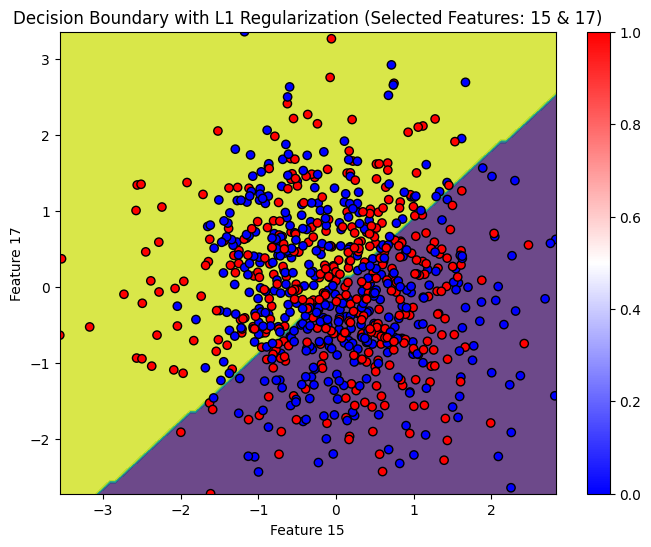

zbieglo po 790 iteracjach


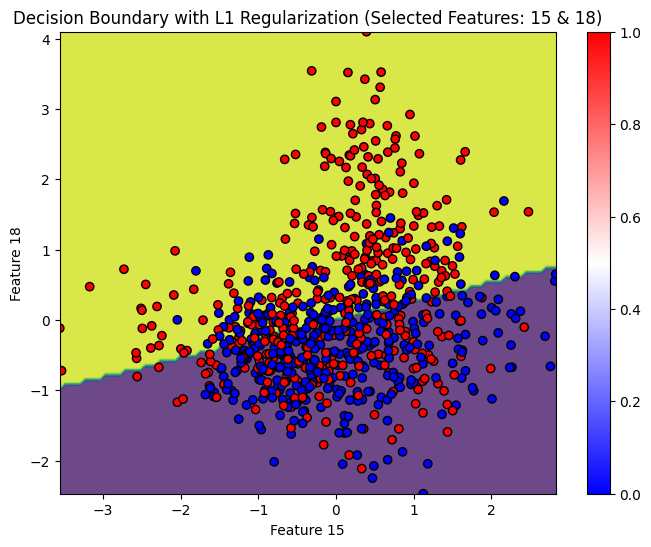

zbieglo po 284 iteracjach


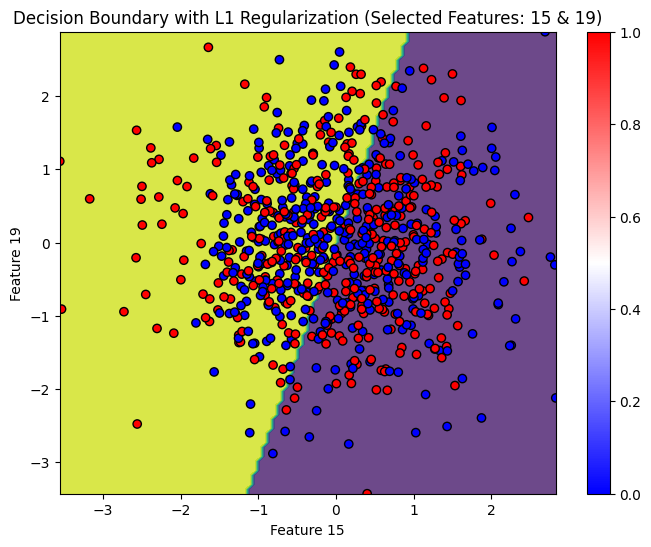

zbieglo po 281 iteracjach


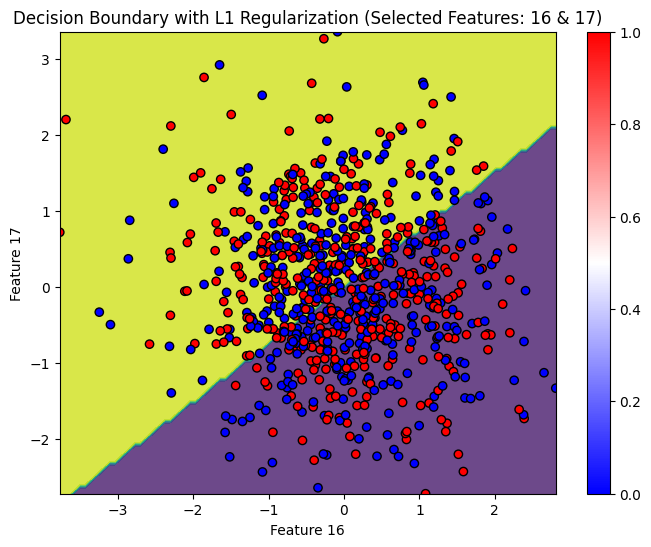

zbieglo po 649 iteracjach


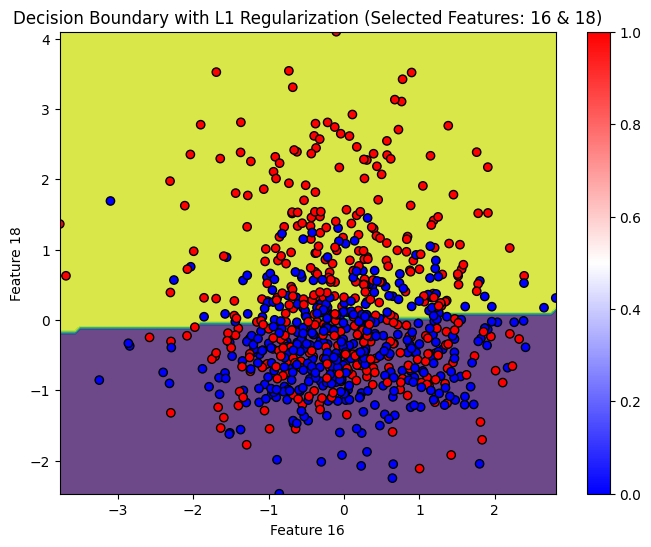

zbieglo po 273 iteracjach


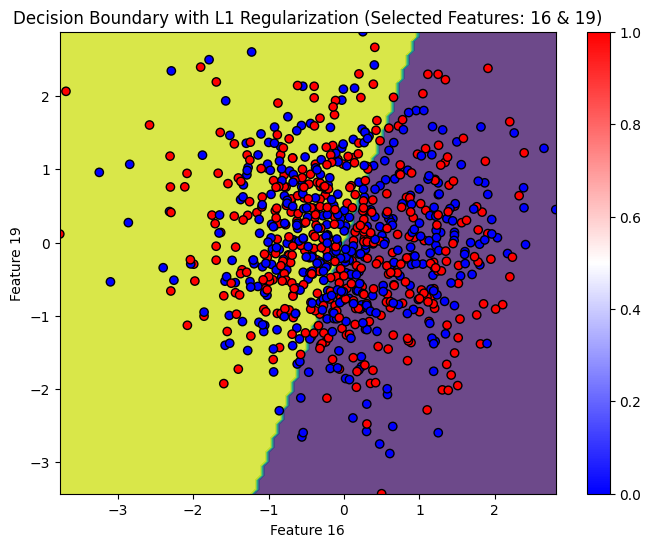

zbieglo po 658 iteracjach


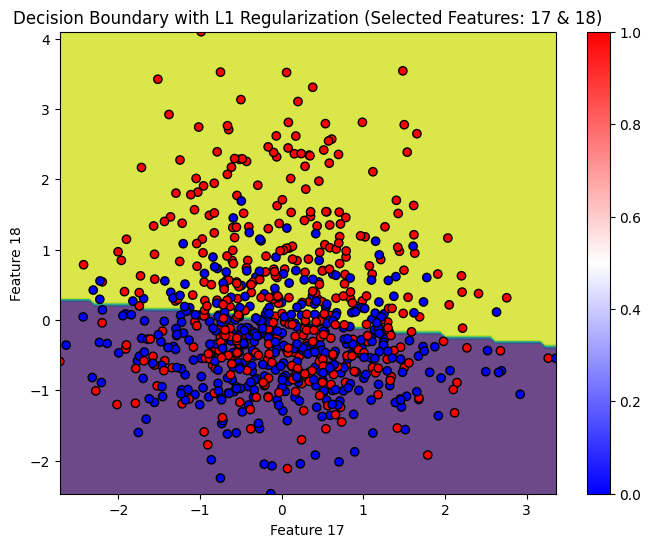

zbieglo po 297 iteracjach


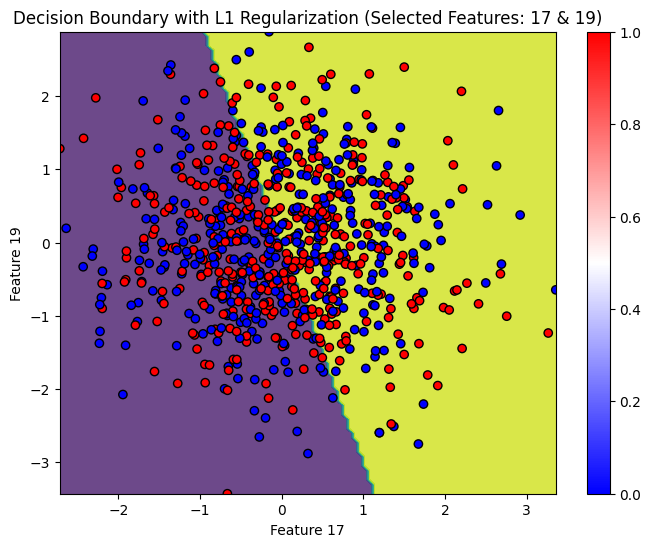

zbieglo po 652 iteracjach


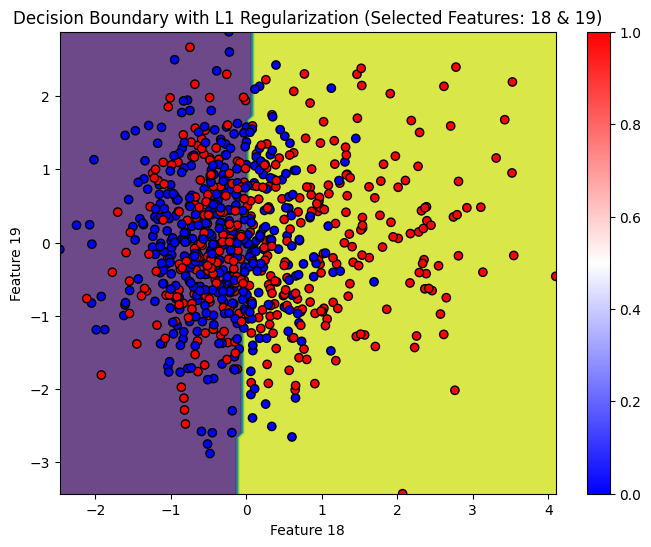

In [33]:
from itertools import combinations
features = np.where(model.beta != 0)[0]

feature_pairs = combinations(features, 2)
for i, j in feature_pairs:
    # Select the pair of features
    X_selected = X_train[:, [i, j]]

    # Create a meshgrid for the selected features
    xx, yy = np.meshgrid(np.linspace(X_selected[:, 0].min(), X_selected[:, 0].max(), 100),
                        np.linspace(X_selected[:, 1].min(), X_selected[:, 1].max(), 100))
    grid = np.c_[xx.ravel(), yy.ravel()]

    # Make predictions for the grid points
    model.fit_gradient_descent(X_selected, y_train)
    grid_predictions = model.predict(grid)

    # Plot the decision boundary
    plt.figure(figsize=(8, 6))
    plt.contourf(xx, yy, grid_predictions.reshape(xx.shape), alpha=0.8)
    plt.scatter(X_selected[:, 0], X_selected[:, 1], c=y_train, edgecolors='k', marker='o', cmap=plt.cm.bwr)
    plt.title(f"Decision Boundary with L1 Regularization (Selected Features: {i} & {j})")
    plt.xlabel(f"Feature {i}")
    plt.ylabel(f"Feature {j}")
    plt.colorbar()
    plt.show()
